# Ignore Warnings

In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
 
import warnings
warnings.filterwarnings(action='ignore')

# Import Important Libraries

In [2]:
import pandas as pd
from pandas import DataFrame
import numpy as np
import matplotlib.pylab as plt
import matplotlib.animation as animation
import seaborn as sns
from scipy.stats import skew
from scipy.stats import kurtosis
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OrdinalEncoder
from sklearn.impute import SimpleImputer
from sklearn.impute import KNNImputer
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn import model_selection
import scipy.stats as stats
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.model_selection import KFold
sns.set_theme(style="whitegrid")
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import DistanceMetric
import pickle
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV
import joblib
from sklearn.feature_selection import chi2
from sklearn.feature_selection import SelectKBest

# Import The DataSet

In [3]:
Heart = pd.read_csv("Framingham Heart Study.csv")
Heart.shape

(3263, 21)

# Dataset Information

In [4]:
Heart.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3263 entries, 0 to 3262
Data columns (total 21 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Gender                          3263 non-null   object 
 1   Age                             3263 non-null   int64  
 2   CurrentSmoker                   3263 non-null   object 
 3   CigarettesPerDay                3249 non-null   float64
 4   BodyMassIndex                   3246 non-null   float64
 5   PrevalentCoronaryHeartDiseases  3263 non-null   object 
 6   PrevalentAnginaPectoris         3263 non-null   object 
 7   PrevalentMyocardialInfarction   3263 non-null   object 
 8   PrevalentStroke                 3263 non-null   object 
 9   PrevalentHypertensive           3263 non-null   object 
 10  UseBloodPressureDrugs           2817 non-null   object 
 11  Diabetes                        3263 non-null   object 
 12  SystolicBloodPressure           32

# Statistics Of The DataSet

In [5]:
Statistics = Heart.describe().T
Statistics

,count,mean,std,min,25%,50%,75%,max
Age,3263.0,60.648177,8.296766,44.00,54.00,60.00,67.00,81.0
CigarettesPerDay,3249.0,6.771622,11.629631,0.00,0.00,0.00,10.00,80.0
BodyMassIndex,3246.0,25.894781,4.080655,14.43,23.19,25.46,28.06,56.8
SystolicBloodPressure,3263.0,140.215752,22.927642,86.00,123.00,137.00,154.00,267.0
DiastolicBloodPressure,3263.0,81.792982,11.271432,30.00,74.00,80.00,89.00,130.0
HeartRate,3259.0,77.357778,12.490350,37.00,70.00,76.00,85.00,150.0
Glucose,2701.0,89.775268,28.158865,46.00,76.00,84.00,96.00,478.0
HighDensityLipoprotein,3027.0,49.364718,15.626669,10.00,39.00,48.00,58.00,189.0
LowDensityLipoprotein,3026.0,176.466953,46.863393,20.00,145.00,173.00,205.00,565.0
TotalCholesterol,3049.0,236.713349,44.449481,112.00,206.00,234.00,264.00,625.0


# Skewness

**1. Age**

In [6]:
SkewnessAge = skew(Heart['Age'], axis=0, bias=True,  keepdims=True)
SkewnessAge

array([0.29534893])

**2. Cigarettes Per Day**

In [7]:
SkewnessCigarettesPerDay= skew(Heart['CigarettesPerDay'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessCigarettesPerDay

array([1.79172491])

**3. Body Mass Index**

In [8]:
SkewnessBodyMassIndex= skew(Heart['BodyMassIndex'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessBodyMassIndex

array([0.91593941])

**4. Systolic Blood Pressure**

In [9]:
SkewnessBodyMassIndex= skew(Heart['SystolicBloodPressure'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessBodyMassIndex

array([0.74113913])

**5. Diastolic Blood Pressure**

In [10]:
SkewnessDiastolicBloodPressure= skew(Heart['DiastolicBloodPressure'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessDiastolicBloodPressure

array([0.33077036])

**6. Heart Rate**

In [11]:
SkewnessHeartRate= skew(Heart['HeartRate'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessHeartRate

array([0.45943407])

**7. Glucose**

In [12]:
SkewnessGlucose= skew(Heart['Glucose'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessGlucose

array([5.2377277])

**8. High Density Lipoprotein**

In [13]:
SkewnessHighDensityLipoprotein= skew(Heart['HighDensityLipoprotein'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessHighDensityLipoprotein

array([1.06178486])

**9. Low Density Lipoprotein**

In [14]:
SkewnessLowDensityLipoprotein= skew(Heart['LowDensityLipoprotein'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessLowDensityLipoprotein

array([0.68756165])

**10. Total Cholesterol**

In [15]:
SkewnessTotalCholesterol= skew(Heart['TotalCholesterol'], axis=0, bias=True, keepdims=True, nan_policy='omit')
SkewnessTotalCholesterol

array([0.77962055])

# Kurtosis

**1. Age**

In [16]:
KurtosisCigarettesPerDay = kurtosis(Heart['CigarettesPerDay'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisCigarettesPerDay

array([2.99740102])

**2. Cigarettes Per Day**

In [17]:
KurtosisCigarettesPerDay= kurtosis(Heart['CigarettesPerDay'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisCigarettesPerDay

array([2.99740102])

**3. Body Mass Index**

In [18]:
KurtosisBodyMassIndex= kurtosis(Heart['BodyMassIndex'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisBodyMassIndex

array([2.61158124])

**4. Systolic Blood Pressure**

In [19]:
KurtosisBodyMassIndex= kurtosis(Heart['SystolicBloodPressure'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisBodyMassIndex

array([0.76817079])

**5. Diastolic Blood Pressure**

In [20]:
KurtosisDiastolicBloodPressure= kurtosis(Heart['DiastolicBloodPressure'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisDiastolicBloodPressure

array([0.45123423])

**6. Heart Rate**

In [21]:
KurtosisHeartRate= kurtosis(Heart['HeartRate'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisHeartRate

array([0.48950638])

**7. Glucose**

In [22]:
KurtosisGlucose= kurtosis(Heart['Glucose'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisGlucose

array([46.19793252])

**8. High Density Lipoprotein**

In [23]:
KurtosisHighDensityLipoprotein= kurtosis(Heart['HighDensityLipoprotein'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisHighDensityLipoprotein

array([3.65340437])

**9. Low Density Lipoprotein**

In [24]:
KurtosisLowDensityLipoprotein= kurtosis(Heart['LowDensityLipoprotein'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisLowDensityLipoprotein

array([2.53060737])

**10. Total Cholesterol**

In [25]:
KurtosisTotalCholesterol= kurtosis(Heart['TotalCholesterol'], axis=0, bias=True, keepdims=True, nan_policy='omit')
KurtosisTotalCholesterol

array([2.78324068])

# Unique Values

In [26]:
UniqueValues = Heart.nunique()
UniqueValues

Gender                               2
Age                                 38
CurrentSmoker                        2
CigarettesPerDay                    35
BodyMassIndex                     1235
PrevalentCoronaryHeartDiseases       2
PrevalentAnginaPectoris              2
PrevalentMyocardialInfarction        2
PrevalentStroke                      2
PrevalentHypertensive                2
UseBloodPressureDrugs                2
Diabetes                             2
SystolicBloodPressure              206
DiastolicBloodPressure             123
HeartRate                           74
Glucose                            151
HighDensityLipoprotein             105
LowDensityLipoprotein              262
TotalCholesterol                   243
AnginaPectoris                       2
MyocardialInfarction                 2
dtype: int64

# Corellation

In [27]:
Heart.corr().abs()

,Age,CigarettesPerDay,BodyMassIndex,SystolicBloodPressure,DiastolicBloodPressure,HeartRate,Glucose,HighDensityLipoprotein,LowDensityLipoprotein,TotalCholesterol
Age,1.000000,0.247609,0.028451,0.342041,0.035993,0.032366,0.091746,0.010700,0.010446,0.056342
CigarettesPerDay,0.247609,1.000000,0.107801,0.085309,0.007949,0.084826,0.053662,0.043997,0.005793,0.053018
BodyMassIndex,0.028451,0.107801,1.000000,0.217795,0.304164,0.055779,0.069684,0.181759,0.067531,0.029777
SystolicBloodPressure,0.342041,0.085309,0.217795,1.000000,0.656129,0.159374,0.145547,0.011681,0.063484,0.093098
DiastolicBloodPressure,0.035993,0.007949,0.304164,0.656129,1.000000,0.187306,0.059535,0.021964,0.041858,0.053807
HeartRate,0.032366,0.084826,0.055779,0.159374,0.187306,1.000000,0.161309,0.025784,0.063826,0.070013
Glucose,0.091746,0.053662,0.069684,0.145547,0.059535,0.161309,1.000000,0.080956,0.015328,0.028971
HighDensityLipoprotein,0.010700,0.043997,0.181759,0.011681,0.021964,0.025784,0.080956,1.000000,0.137462,0.176499
LowDensityLipoprotein,0.010446,0.005793,0.067531,0.063484,0.041858,0.063826,0.015328,0.137462,1.000000,0.857232
TotalCholesterol,0.056342,0.053018,0.029777,0.093098,0.053807,0.070013,0.028971,0.176499,0.857232,1.000000


# Heatmap

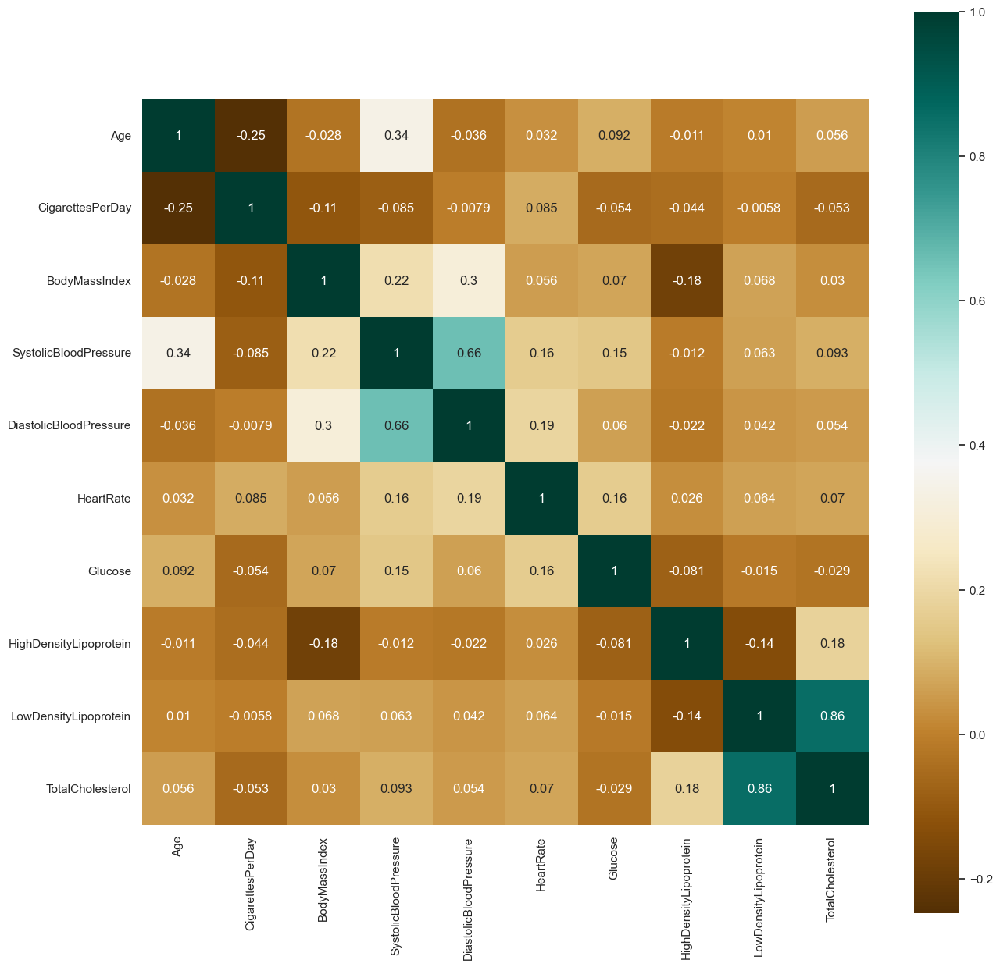

In [28]:
fig, ax = plt.subplots(figsize=(15, 15))
sns.heatmap(Heart.corr(), square=True,annot=True, cmap="BrBG", ax=ax);

# Univariate Data Analysis

**A. Numerical**

**1. Histogram**

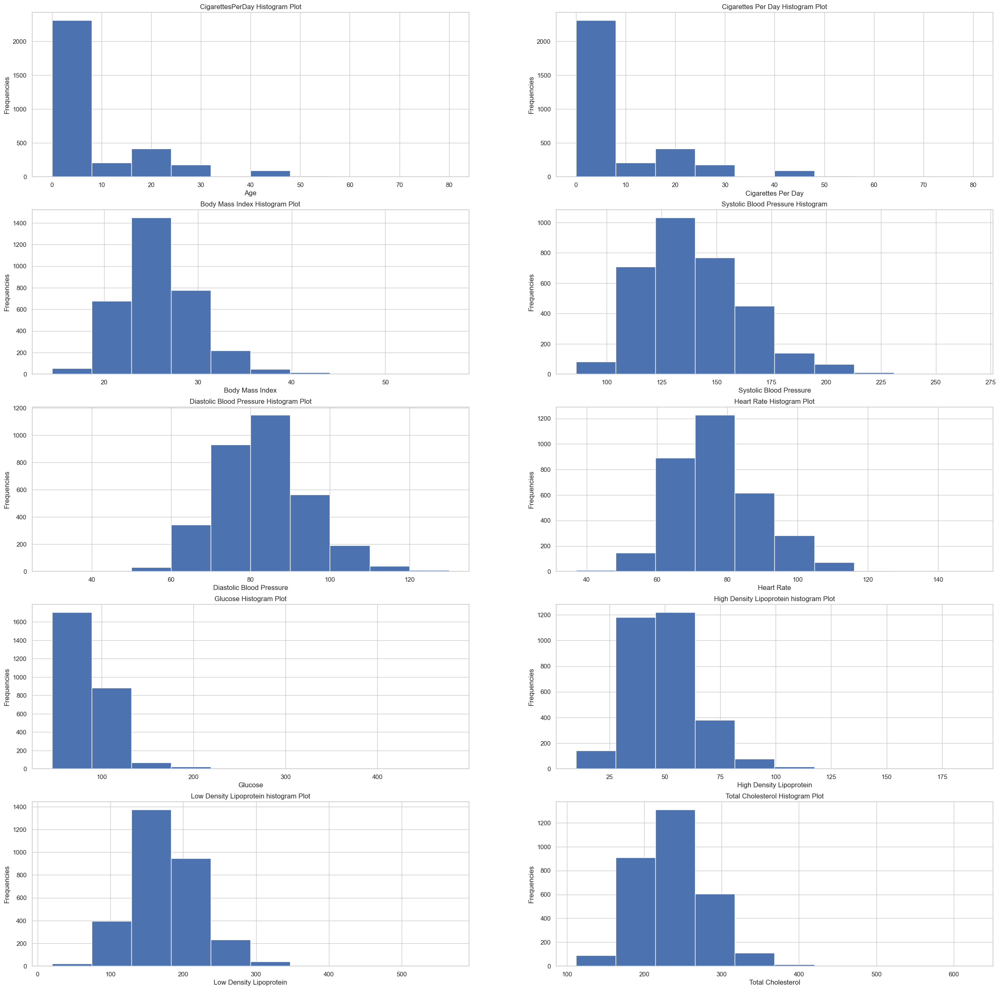

In [29]:
Fig, ax = plt.subplots(nrows=5,ncols=2,figsize=(30 , 30))
ax[0, 0].hist(Heart['CigarettesPerDay'],)
ax[0, 0].set(title= "CigarettesPerDay Histogram Plot", xlabel='Age', ylabel='Frequencies');

ax[0, 1].hist(Heart['CigarettesPerDay'],)
ax[0, 1].set(title= "Cigarettes Per Day Histogram Plot", xlabel='Cigarettes Per Day', ylabel='Frequencies');

ax[1, 0].hist(Heart['BodyMassIndex'],)
ax[1, 0].set(title= "Body Mass Index Histogram Plot",xlabel='Body Mass Index', ylabel='Frequencies');

ax[1, 1].hist(Heart['SystolicBloodPressure'])
ax[1, 1].set(title= "Systolic Blood Pressure Histogram",xlabel='Systolic Blood Pressure', ylabel='Frequencies');

ax[2, 0].hist(Heart['DiastolicBloodPressure'])
ax[2, 0].set(title= "Diastolic Blood Pressure Histogram Plot",xlabel='Diastolic Blood Pressure', ylabel='Frequencies');

ax[2, 1].hist(Heart['HeartRate'])
ax[2, 1].set(title= "Heart Rate Histogram Plot",xlabel='Heart Rate', ylabel='Frequencies');

ax[3, 0].hist(Heart['Glucose'])
ax[3, 0].set(title= "Glucose Histogram Plot",xlabel='Glucose', ylabel='Frequencies');

ax[3, 1].hist(Heart['HighDensityLipoprotein'])
ax[3, 1].set(title= "High Density Lipoprotein histogram Plot",xlabel='High Density Lipoprotein', ylabel='Frequencies');

ax[4, 0].hist(Heart['LowDensityLipoprotein'])
ax[4, 0].set(title= "Low Density Lipoprotein histogram Plot",xlabel='Low Density Lipoprotein', ylabel='Frequencies');

ax[4, 1].hist(Heart['TotalCholesterol'])
ax[4, 1].set(title= "Total Cholesterol Histogram Plot",xlabel='Total Cholesterol', ylabel='Frequencies');

plt.show()

**2. Kde Plot**

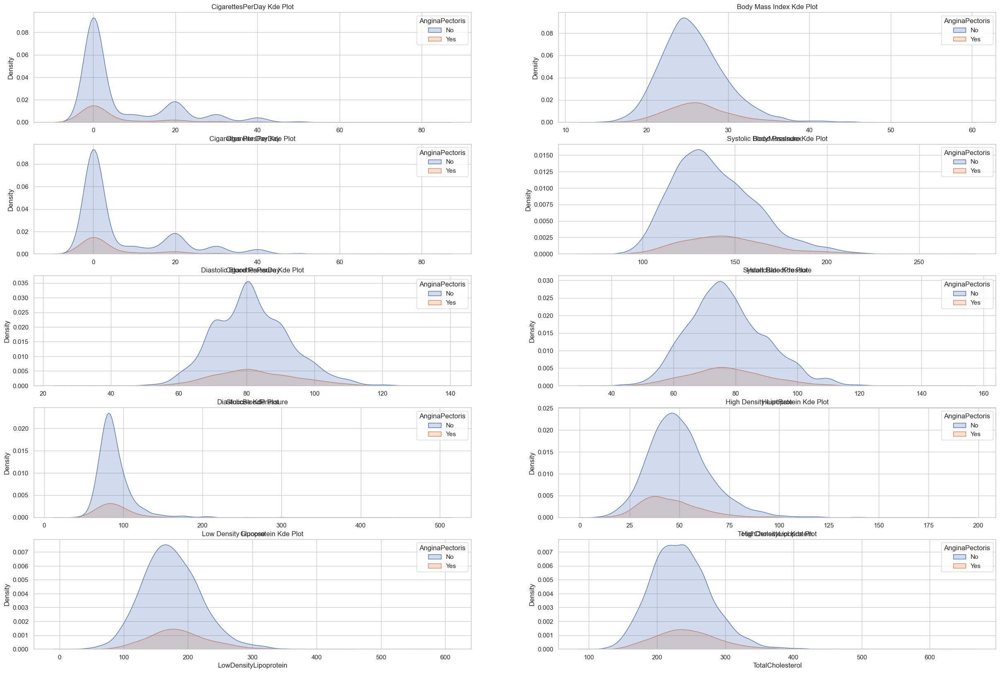

In [30]:
Fig, ((ax1, ax2), (ax3, ax4),(ax5, ax6),(ax7,ax8), (ax9,ax10),) = plt.subplots(nrows=5,
                                            ncols=2,
                                            figsize=(30, 20))
sns.kdeplot(x = Heart['CigarettesPerDay'], ax=ax1, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('CigarettesPerDay Kde Plot');
sns.kdeplot(x = Heart['BodyMassIndex'], ax=ax2, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Body Mass Index Kde Plot');
sns.kdeplot(x = Heart['CigarettesPerDay'], ax=ax3, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Cigarettes Per Day Kde Plot');
sns.kdeplot(x = Heart['SystolicBloodPressure'], ax=ax4, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Systolic Blood Pressure Kde Plot');
sns.kdeplot(x = Heart['DiastolicBloodPressure'], ax=ax5, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Diastolic Blood Pressure Kde Plot');
sns.kdeplot(x = Heart['HeartRate'],ax=ax6, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Heart Rate Kde Plot');
sns.kdeplot(x = Heart['Glucose'], ax=ax7, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Glucose Kde Plot');
sns.kdeplot(x = Heart['HighDensityLipoprotein'], ax=ax8, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('High Density Lipoprotein Kde Plot');
sns.kdeplot(x = Heart['LowDensityLipoprotein'], ax=ax9, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Low Density Lipoprotein Kde Plot');
sns.kdeplot(x = Heart['TotalCholesterol'], ax=ax10, color='green', shade='True',hue=Heart['AnginaPectoris']).set_title('Total Cholesterol Kde Plot');

**3. Box Plot**

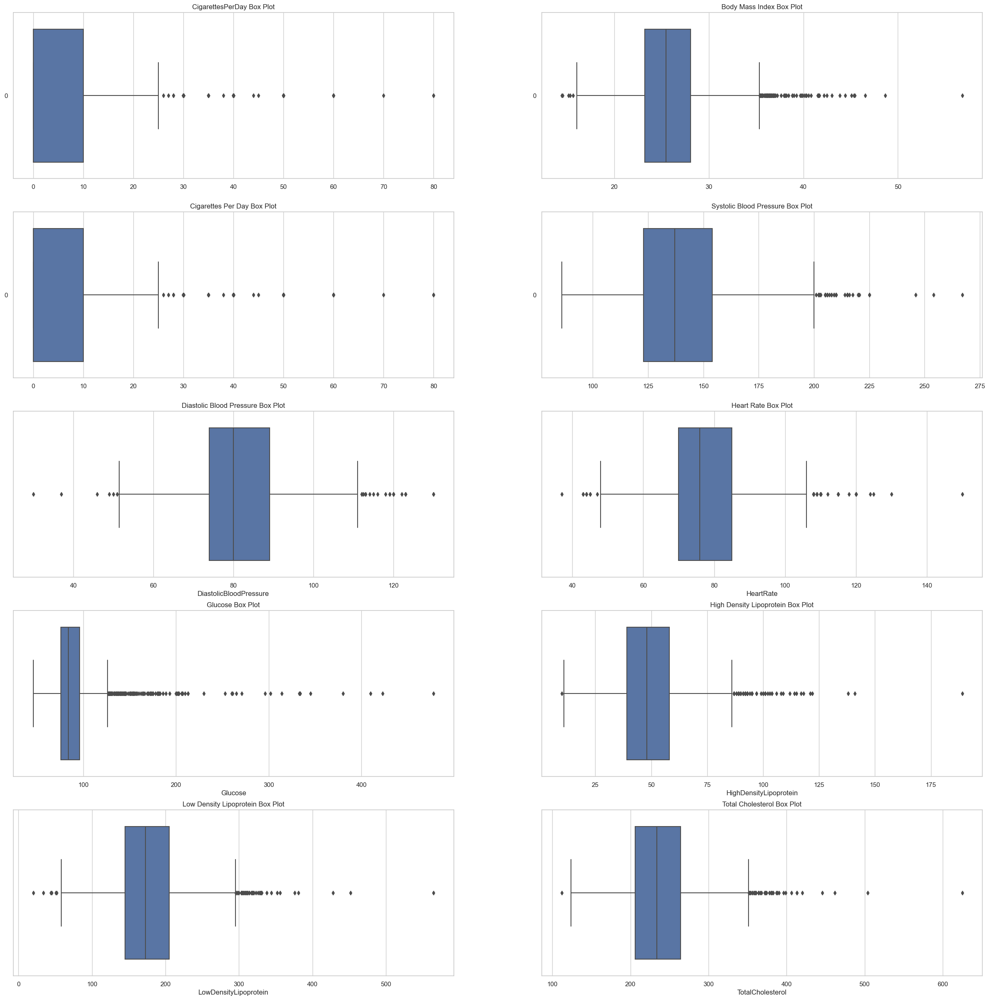

In [31]:
Fig, ((ax1, ax2), (ax3, ax4),(ax5, ax6),(ax7,ax8), (ax9,ax10)) = plt.subplots(nrows=5,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.boxplot(Heart['CigarettesPerDay'],                       ax=ax1, orient='h').set_title('CigarettesPerDay Box Plot');
sns.boxplot(Heart['BodyMassIndex'],             ax=ax2, orient='h').set_title('Body Mass Index Box Plot');
sns.boxplot(Heart['CigarettesPerDay'],          ax=ax3, orient='h').set_title('Cigarettes Per Day Box Plot');
sns.boxplot(Heart['SystolicBloodPressure'],     ax=ax4, orient='h').set_title('Systolic Blood Pressure Box Plot');
sns.boxplot(x = Heart['DiastolicBloodPressure'],    ax=ax5, orient='h').set_title('Diastolic Blood Pressure Box Plot');
sns.boxplot(x = Heart['HeartRate'],                 ax=ax6, orient='h').set_title('Heart Rate Box Plot');
sns.boxplot(x = Heart['Glucose'],                   ax=ax7, orient='h').set_title('Glucose Box Plot');
sns.boxplot(x = Heart['HighDensityLipoprotein'],    ax=ax8, orient='h').set_title('High Density Lipoprotein Box Plot');
sns.boxplot(x = Heart['LowDensityLipoprotein'],     ax=ax9, orient='h').set_title('Low Density Lipoprotein Box Plot');
sns.boxplot(x = Heart['TotalCholesterol'],          ax=ax10, orient='h').set_title('Total Cholesterol Box Plot');

**4. Violin Plot**

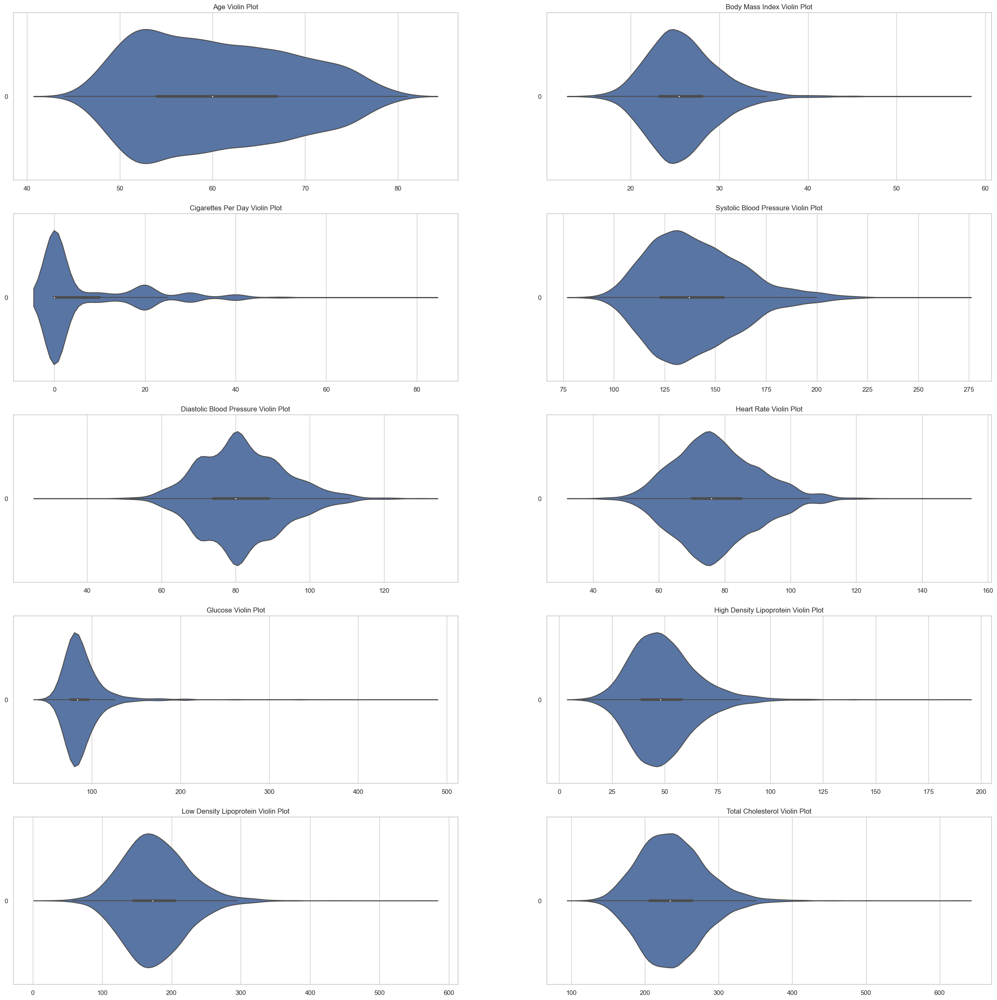

In [32]:
Fig, ((ax1, ax2), (ax3, ax4),(ax5, ax6),(ax7,ax8), (ax9,ax10)) = plt.subplots(nrows=5,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.violinplot(Heart['Age'],                       ax=ax1, orient='h').set_title('Age Violin Plot');
sns.violinplot(Heart['BodyMassIndex'],             ax=ax2, orient='h').set_title('Body Mass Index Violin Plot');
sns.violinplot(Heart['CigarettesPerDay'],          ax=ax3, orient='h').set_title('Cigarettes Per Day Violin Plot');
sns.violinplot(Heart['SystolicBloodPressure'],     ax=ax4, orient='h').set_title('Systolic Blood Pressure Violin Plot');
sns.violinplot(Heart['DiastolicBloodPressure'],    ax=ax5, orient='h').set_title('Diastolic Blood Pressure Violin Plot');
sns.violinplot(Heart['HeartRate'],                 ax=ax6, orient='h').set_title('Heart Rate Violin Plot');
sns.violinplot(Heart['Glucose'],                   ax=ax7, orient='h').set_title('Glucose Violin Plot');
sns.violinplot(Heart['HighDensityLipoprotein'],    ax=ax8, orient='h').set_title('High Density Lipoprotein Violin Plot');
sns.violinplot(Heart['LowDensityLipoprotein'],     ax=ax9, orient='h').set_title('Low Density Lipoprotein Violin Plot');
sns.violinplot(Heart['TotalCholesterol'],          ax=ax10, orient='h').set_title('Total Cholesterol Violin Plot');

**5. Strip Plot**

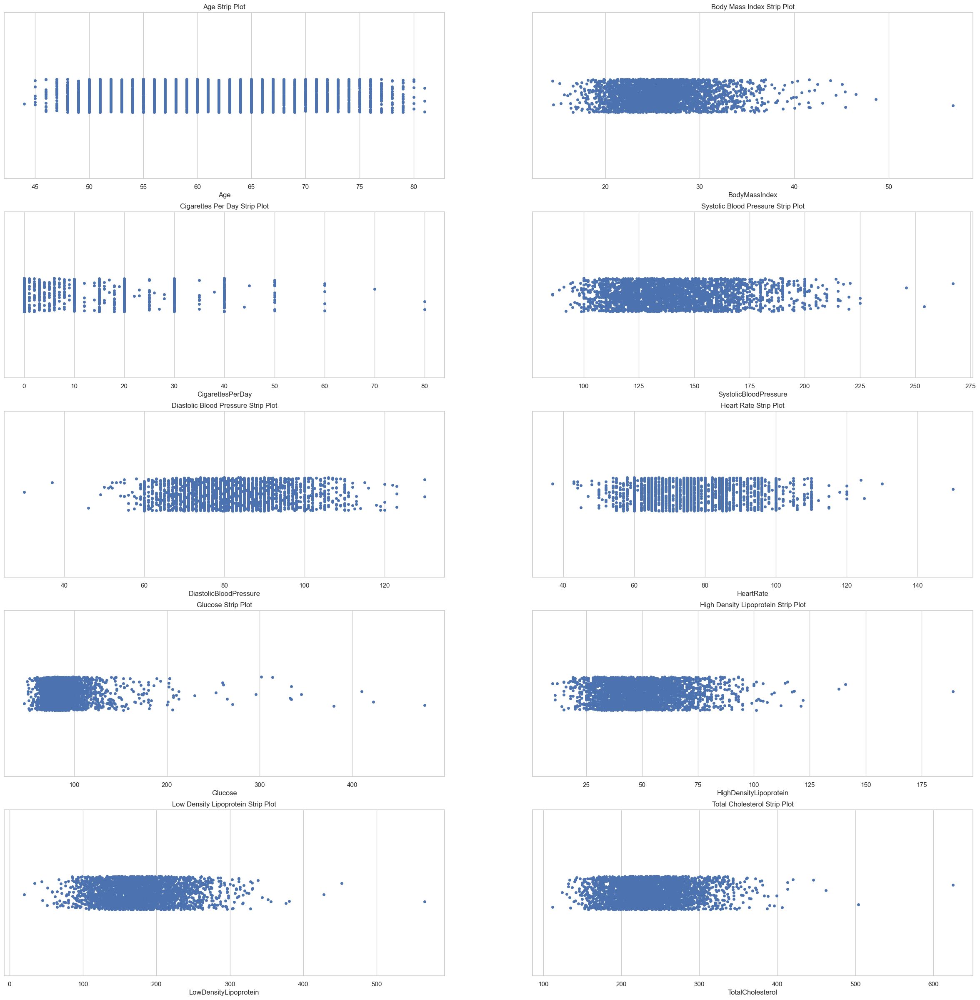

In [33]:
Fig, ((ax1, ax2), (ax3, ax4),(ax5, ax6),(ax7,ax8), (ax9,ax10)) = plt.subplots(nrows=5,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.stripplot(x = Heart['Age'],  ax=ax1, orient='h').set_title('Age Strip Plot');

sns.stripplot(x = Heart['BodyMassIndex'],  ax=ax2, orient='h').set_title('Body Mass Index Strip Plot');

sns.stripplot(x = Heart['CigarettesPerDay'], ax=ax3, orient='h').set_title('Cigarettes Per Day Strip Plot');

sns.stripplot(x = Heart['SystolicBloodPressure'], ax=ax4, orient='h').set_title('Systolic Blood Pressure Strip Plot');

sns.stripplot(x = Heart['DiastolicBloodPressure'], ax=ax5, orient='h').set_title('Diastolic Blood Pressure Strip Plot');

sns.stripplot(x = Heart['HeartRate'], ax=ax6, orient='h').set_title('Heart Rate Strip Plot');

sns.stripplot(x = Heart['Glucose'],  ax=ax7, orient='h').set_title('Glucose Strip Plot');

sns.stripplot(x = Heart['HighDensityLipoprotein'], ax=ax8, orient='h').set_title('High Density Lipoprotein Strip Plot');

sns.stripplot(x = Heart['LowDensityLipoprotein'], ax=ax9, orient='h').set_title('Low Density Lipoprotein Strip Plot');

sns.stripplot(x = Heart['TotalCholesterol'], ax=ax10, orient='h').set_title('Total Cholesterol Strip Plot');

**6. Dist Plot**

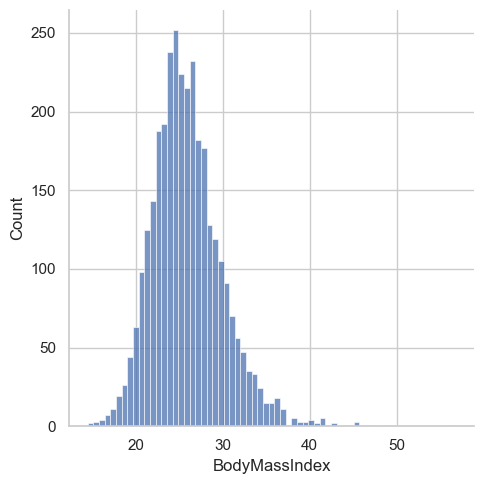

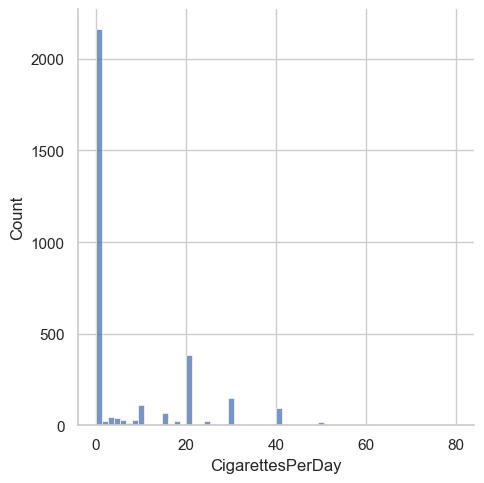

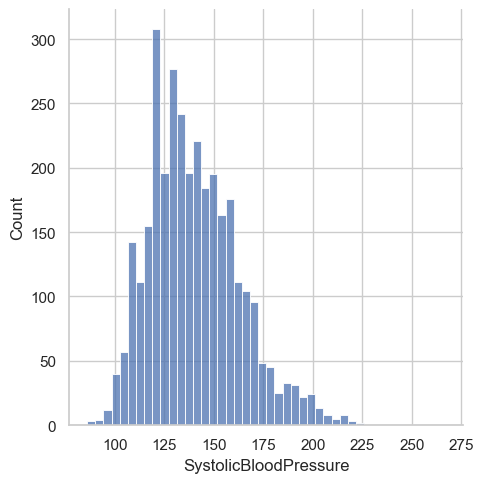

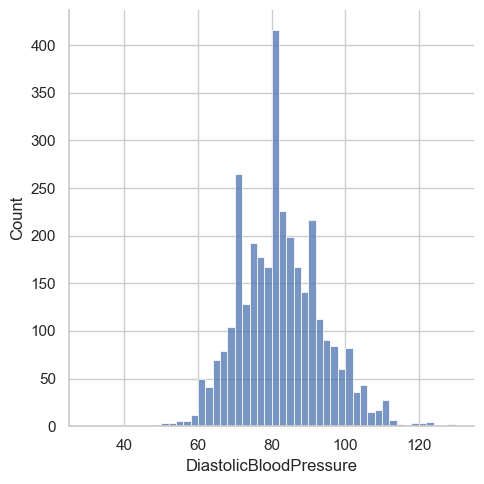

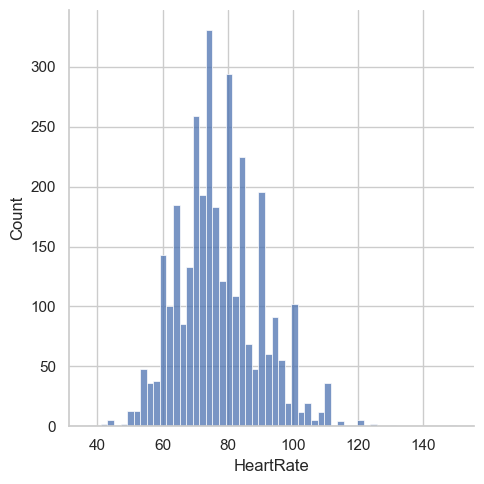

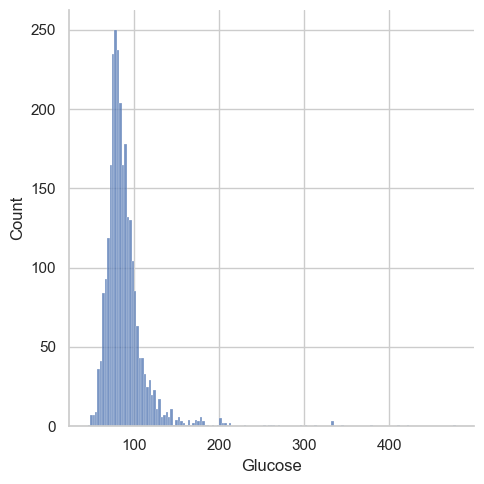

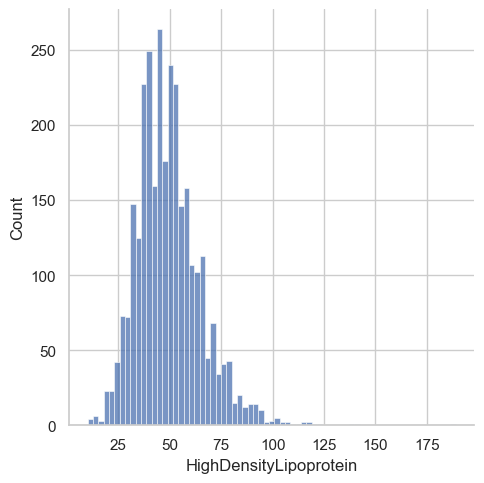

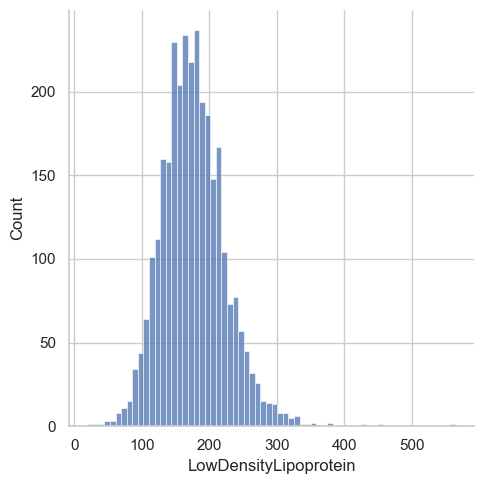

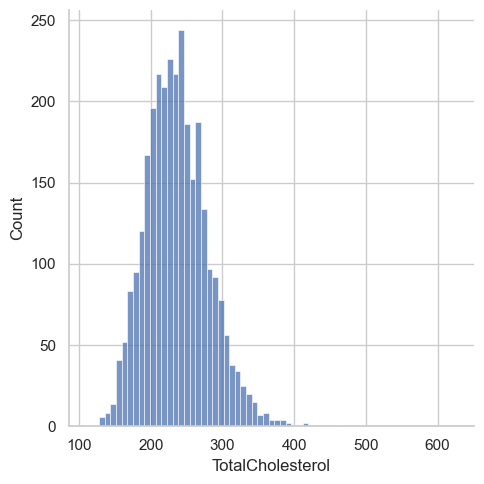

In [34]:
sns.displot(Heart['BodyMassIndex']);

sns.displot(Heart['CigarettesPerDay']);

sns.displot(Heart['SystolicBloodPressure']);

sns.displot(Heart['DiastolicBloodPressure']);

sns.displot(Heart['HeartRate']);

sns.displot(Heart['Glucose']);

sns.displot(Heart['HighDensityLipoprotein']);

sns.displot(Heart['LowDensityLipoprotein']);

sns.displot(Heart['TotalCholesterol']);

**7. Boxen Plot**

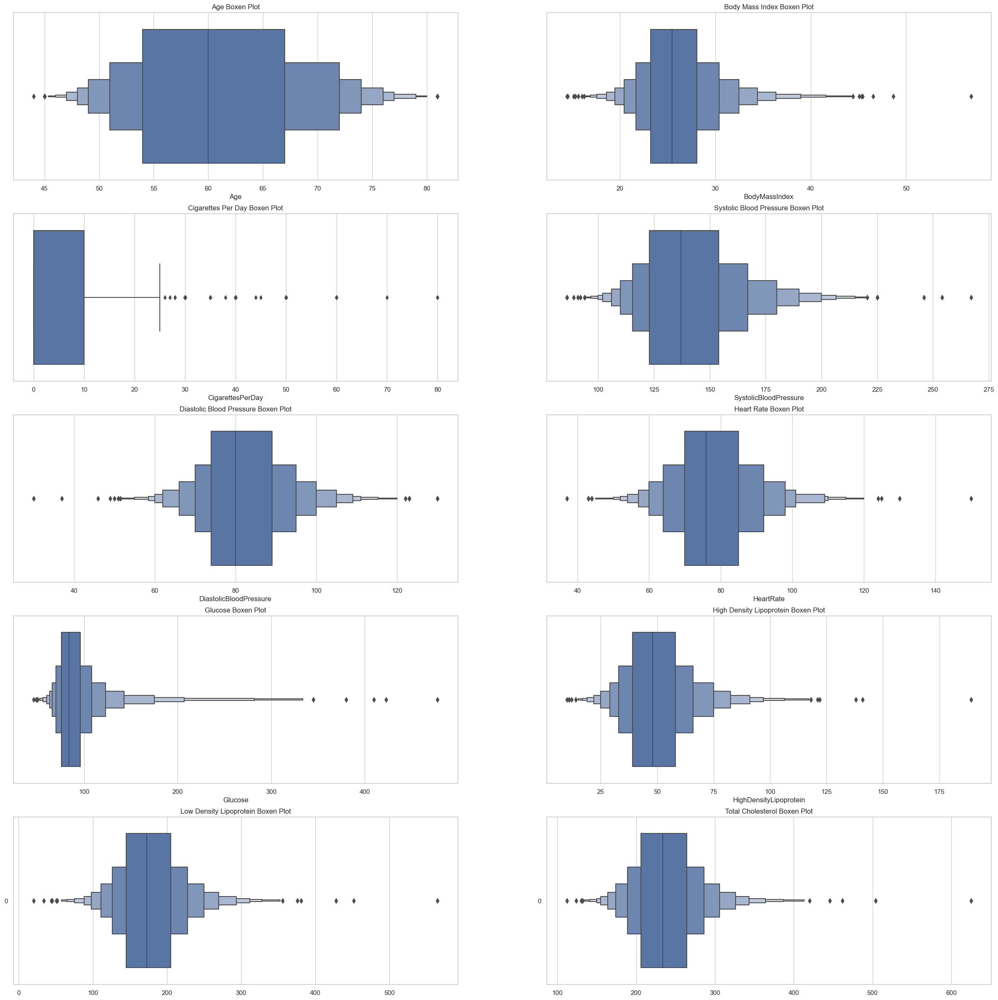

In [35]:
Fig, ((ax1, ax2), (ax3, ax4),(ax5, ax6),(ax7,ax8), (ax9,ax10)) = plt.subplots(nrows=5,
                                            ncols=2,
                                            figsize=(30 , 30))
sns.boxenplot(x = Heart['Age'],ax=ax1, orient='h').set_title('Age Boxen Plot');

sns.boxenplot(x = Heart['BodyMassIndex'],ax=ax2, orient='h').set_title('Body Mass Index Boxen Plot');

sns.boxplot(x = Heart['CigarettesPerDay'], ax=ax3, orient='h').set_title('Cigarettes Per Day Boxen Plot');

sns.boxenplot(x = Heart['SystolicBloodPressure'], ax=ax4, orient='h').set_title('Systolic Blood Pressure Boxen Plot');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], ax=ax5, orient='h').set_title('Diastolic Blood Pressure Boxen Plot');

sns.boxenplot(x =Heart['HeartRate'], ax=ax6, orient='h').set_title('Heart Rate Boxen Plot');

sns.boxenplot(x = Heart['Glucose'], ax=ax7, orient='h').set_title('Glucose Boxen Plot');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], ax=ax8, orient='h').set_title('High Density Lipoprotein Boxen Plot');

sns.boxenplot(Heart['LowDensityLipoprotein'], ax=ax9, orient='h').set_title('Low Density Lipoprotein Boxen Plot');

sns.boxenplot(Heart['TotalCholesterol'], ax=ax10, orient='h').set_title('Total Cholesterol Boxen Plot');

**B. Categeoriacl**

**1. Count Plot**

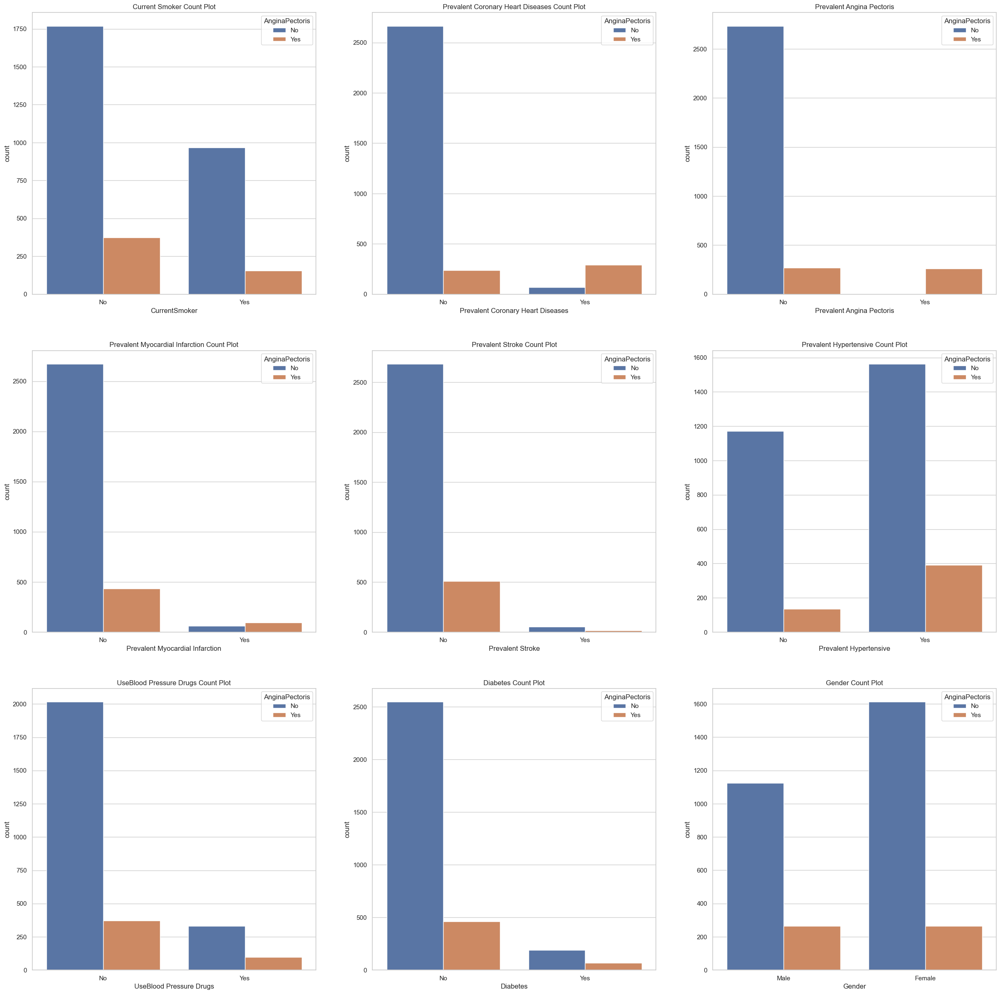

In [36]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
                                           
sns.countplot(x = Heart['CurrentSmoker'],                       ax=ax1, hue=Heart['AnginaPectoris']).set_title('Current Smoker Count Plot');
ax1.set(xlabel='CurrentSmoker');

sns.countplot(x =  Heart['PrevalentCoronaryHeartDiseases'],      ax=ax2, hue=Heart['AnginaPectoris']).set_title('Prevalent Coronary Heart Diseases Count Plot');
ax2.set(xlabel='Prevalent Coronary Heart Diseases')

sns.countplot(x = Heart['PrevalentAnginaPectoris'],             ax=ax3, hue=Heart['AnginaPectoris']).set_title('Prevalent Angina Pectoris');
ax3.set(xlabel='Prevalent Angina Pectoris');

sns.countplot(x =  Heart['PrevalentMyocardialInfarction'],       ax=ax4, hue=Heart['AnginaPectoris']).set_title('Prevalent Myocardial Infarction Count Plot');
ax4.set(xlabel='Prevalent Myocardial Infarction')

sns.countplot(x =  Heart['PrevalentStroke'],                      ax=ax5, hue=Heart['AnginaPectoris']).set_title('Prevalent Stroke Count Plot');
ax5.set(xlabel='Prevalent Stroke');

sns.countplot(x =  Heart['PrevalentHypertensive'],               ax=ax6, hue=Heart['AnginaPectoris']).set_title('Prevalent Hypertensive Count Plot');
ax6.set(xlabel='Prevalent Hypertensive');

sns.countplot(x =  Heart['UseBloodPressureDrugs'],               ax=ax7, hue=Heart['AnginaPectoris']).set_title('UseBlood Pressure Drugs Count Plot');
ax7.set(xlabel='UseBlood Pressure Drugs');

sns.countplot(x = Heart['Diabetes'],                            ax=ax8, hue=Heart['AnginaPectoris']).set_title('Diabetes Count Plot');
ax8.set(xlabel='Diabetes');

sns.countplot(x = Heart['Gender'],                              ax=ax9, hue=Heart['AnginaPectoris']).set_title('Gender Count Plot');
ax9.set(xlabel='Gender');

**2. Pie Chart**

**A. Gender**

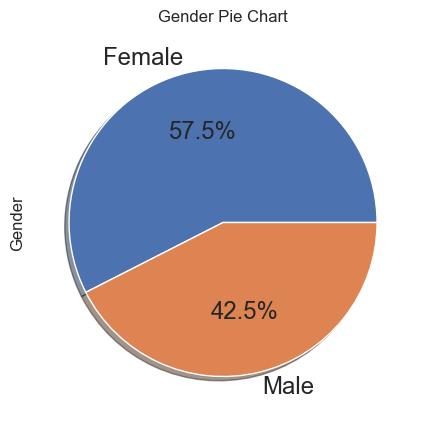

In [37]:
Heart['Gender'].value_counts().plot.pie(autopct = '%0.1f%%',
                                    textprops={'size':'x-large'},
                                    shadow = True,
                                    title = "Gender Pie Chart",
                                    figsize = (5,5),
                                    ylabel = 'Gender');

**B. Current Smoker**

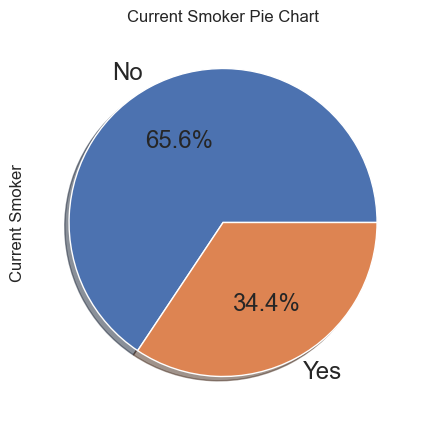

In [38]:
y = Heart['CurrentSmoker'].value_counts().plot.pie(autopct = '%0.1f%%',
                                           textprops = {'size': 'x-large'},
                                           shadow = True,
                                           title = 'Current Smoker Pie Chart',
                                           figsize = (5,5),
                                           ylabel = 'Current Smoker');

**C. Prevalent Coronary Heart Diseases**

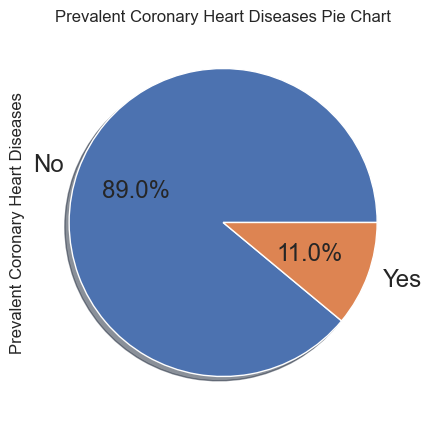

In [39]:
y = Heart['PrevalentCoronaryHeartDiseases'].value_counts().plot.pie(autopct = '%0.1f%%',
                                                            textprops = {'size': 'x-large'},
                                                            shadow = True,
                                                            title = 'Prevalent Coronary Heart Diseases Pie Chart',
                                                            figsize = (5,5),
                                                            ylabel = 'Prevalent Coronary Heart Diseases');

**D. Prevalent Angina Pectoris**

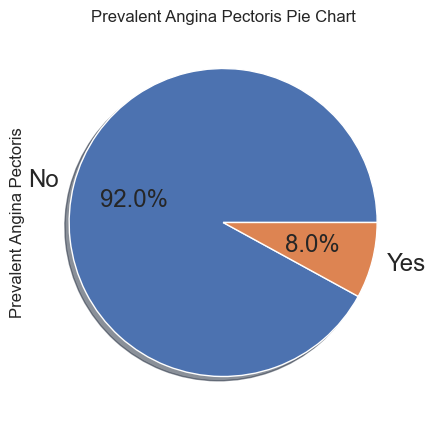

In [40]:
y = Heart['PrevalentAnginaPectoris'].value_counts().plot.pie(autopct = '%0.1f%%',
                                                    textprops = {'size': 'x-large'},
                                                    shadow = True,
                                                    title = 'Prevalent Angina Pectoris Pie Chart',
                                                    figsize = (5,5),
                                                    ylabel = 'Prevalent Angina Pectoris')

**E. Prevalent Myocardial Infarction**

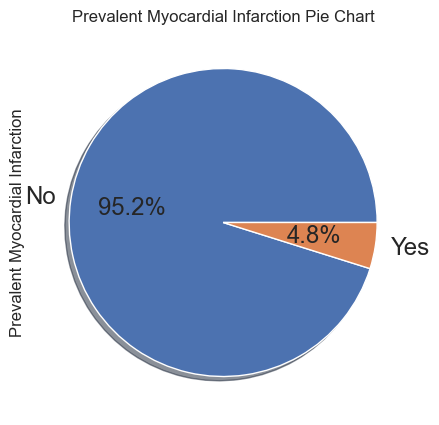

In [41]:
y = Heart['PrevalentMyocardialInfarction'].value_counts().plot.pie(autopct = '%0.1f%%',
                                                           textprops = {'size': 'x-large'},
                                                           shadow = True,
                                                           title = "Prevalent Myocardial Infarction Pie Chart",
                                                           figsize = (5,5),
                                                           ylabel = 'Prevalent Myocardial Infarction');

**F. Prevalent Stroke**

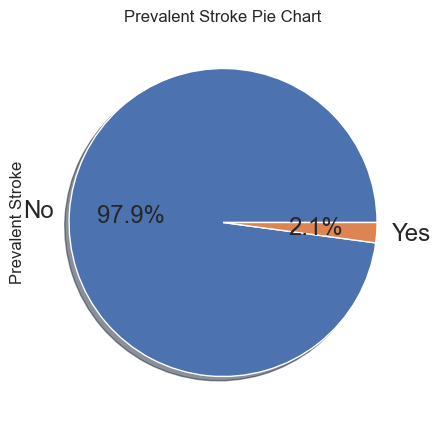

In [42]:
y = Heart['PrevalentStroke'].value_counts().plot.pie(autopct = "%0.1f%%",
                                             textprops = {'size':'x-large'},
                                             shadow = True,
                                             title = 'Prevalent Stroke Pie Chart',
                                             figsize = (5,5),
                                             ylabel = 'Prevalent Stroke');

**G. Prevalent Hypertensive**

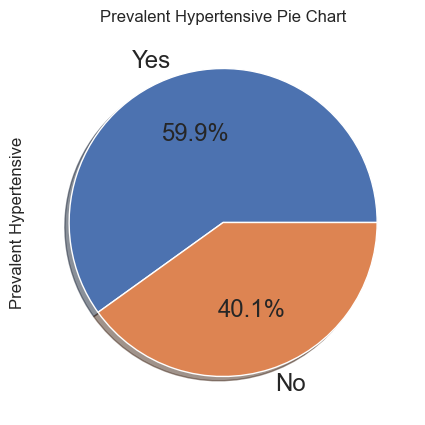

In [43]:
y = Heart['PrevalentHypertensive'].value_counts().plot.pie(autopct = '%0.1f%%',
                                                   textprops = {'size': 'x-large'},
                                                   shadow = True,
                                                   title = 'Prevalent Hypertensive Pie Chart',
                                                   figsize = (5,5),
                                                   ylabel = 'Prevalent Hypertensive');

**J. Use Blood Pressure Drugs**

<Axes: title={'center': 'Use Blood Pressure Drugs Pie Chart'}, ylabel='Use Blood Pressure Drugs'>

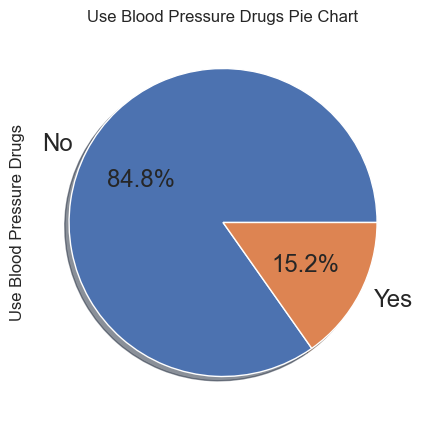

In [44]:
Heart['UseBloodPressureDrugs'].value_counts().plot.pie(autopct = '%0.1f%%',
                                                   textprops = {'size': 'x-large'},
                                                   shadow = True,
                                                   title = 'Use Blood Pressure Drugs Pie Chart',
                                                   figsize = (5,5),
                                                   ylabel = 'Use Blood Pressure Drugs')

**H. Diabetes**

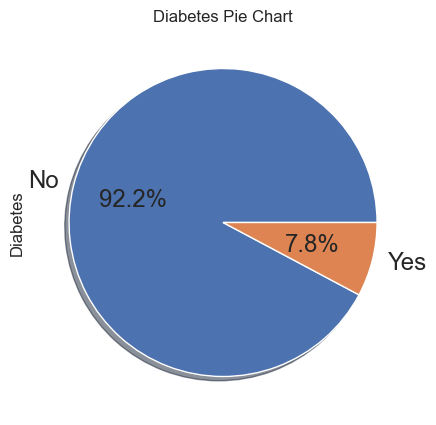

In [45]:
y = Heart['Diabetes'].value_counts().plot.pie(autopct = "%0.1f%%",
                                      textprops = {'size': 'x-large'},
                                      shadow = True,
                                      title = 'Diabetes Pie Chart',
                                      figsize = (5,5),
                                      ylabel ='Diabetes');

# Bivariate Data Analysis

**1.Pair Plot**

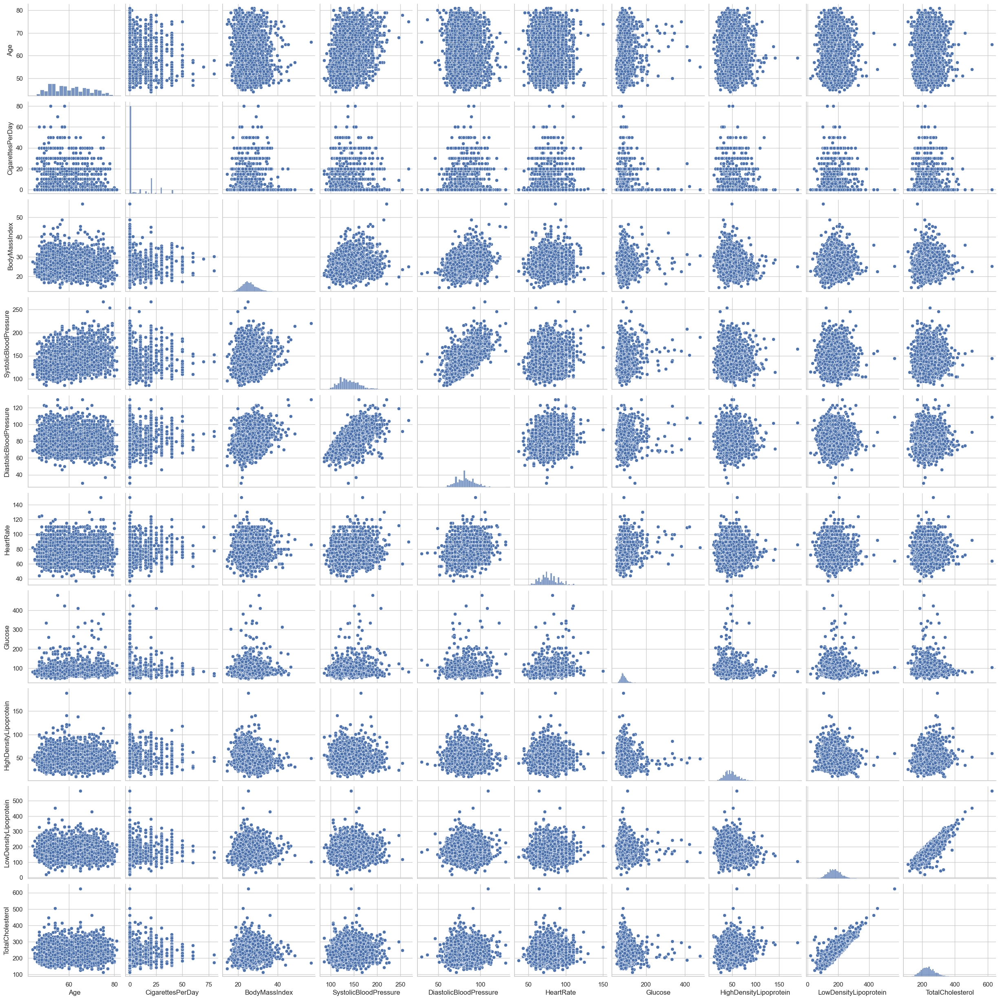

In [46]:
sns.pairplot(Heart);

**2.Scatter Plot**

**A. Age**

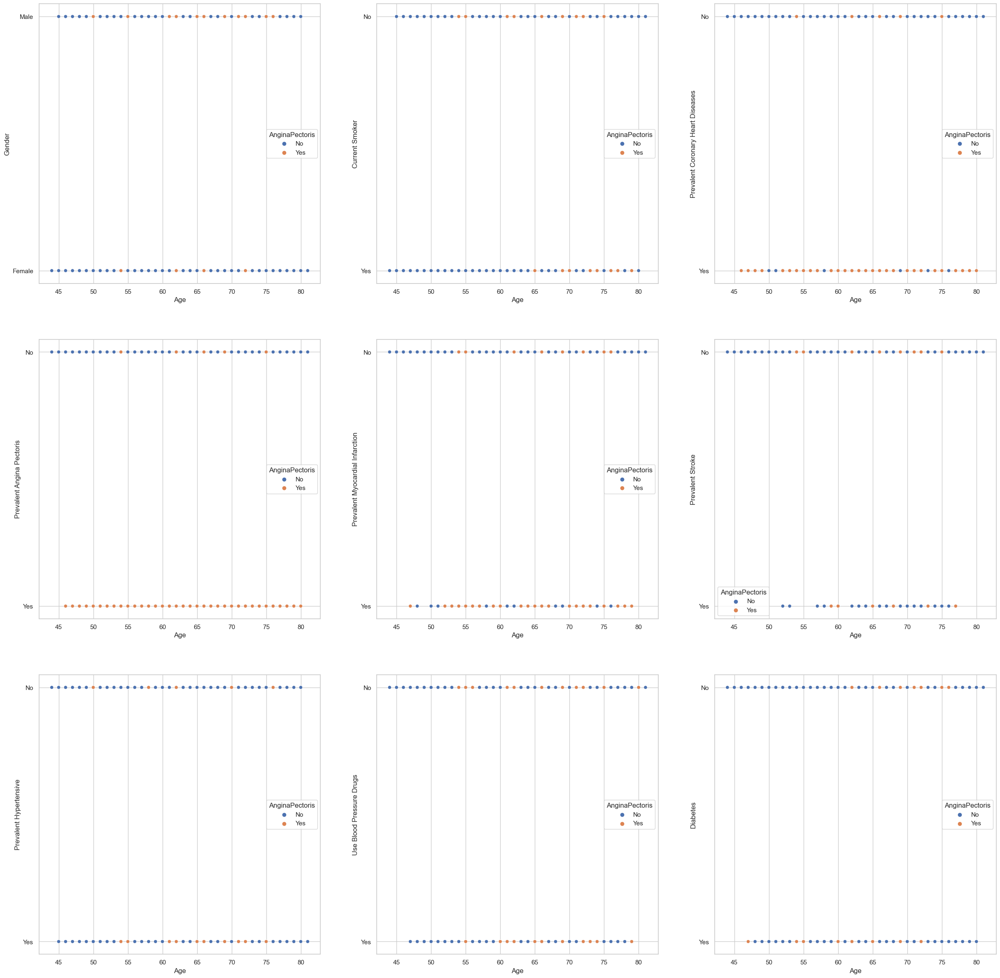

In [47]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x = Heart['Age'], y = Heart['Gender'],                              ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Age', ylabel='Gender');

sns.scatterplot(x = Heart['Age'], y = Heart['CurrentSmoker'],                       ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Age', ylabel='Current Smoker');

sns.scatterplot(x = Heart['Age'], y = Heart['PrevalentCoronaryHeartDiseases'],      ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Age', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['Age'], y = Heart['PrevalentAnginaPectoris'],             ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Age', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x = Heart['Age'], y = Heart['PrevalentMyocardialInfarction'],       ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Age', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x = Heart['Age'], y = Heart['PrevalentStroke'] ,                    ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Age', ylabel='Prevalent Stroke');

sns.scatterplot(x = Heart['Age'], y = Heart['PrevalentHypertensive'],               ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Age', ylabel='Prevalent Hypertensive');

sns.scatterplot(x = Heart['Age'], y =  Heart['UseBloodPressureDrugs'],               ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Age', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x = Heart['Age'], y = Heart['Diabetes'],                            ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Age', ylabel='Diabetes');

**B. Cigarettes Per Day**

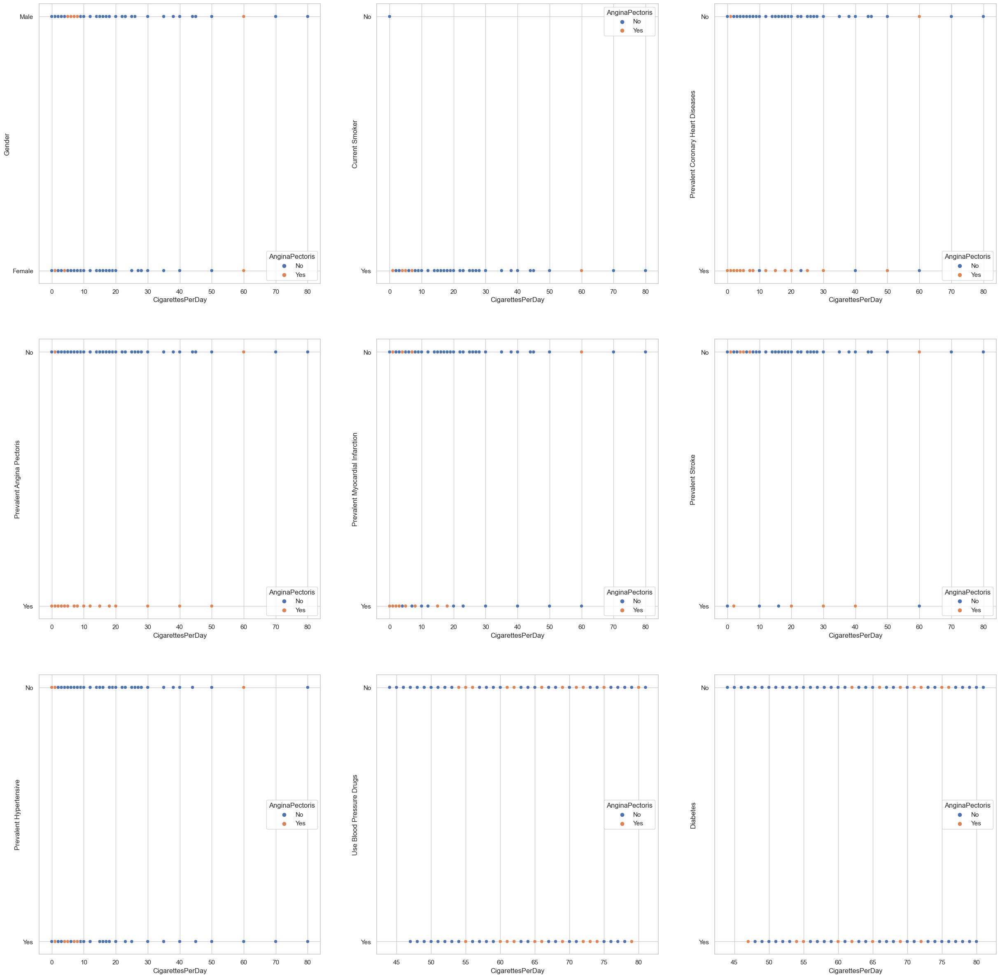

In [48]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['Gender'],                              ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='CigarettesPerDay', ylabel='Gender');

sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['CurrentSmoker'],                       ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='CigarettesPerDay', ylabel='Current Smoker');

sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentCoronaryHeartDiseases'],      ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='CigarettesPerDay', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentAnginaPectoris'],             ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='CigarettesPerDay', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentMyocardialInfarction'],       ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='CigarettesPerDay', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentStroke'] ,                    ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='CigarettesPerDay', ylabel='Prevalent Stroke');

sns.scatterplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentHypertensive'],               ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='CigarettesPerDay', ylabel='Prevalent Hypertensive');

sns.scatterplot(x = Heart['Age'], y =  Heart['UseBloodPressureDrugs'],               ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='CigarettesPerDay', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x = Heart['Age'], y = Heart['Diabetes'],                            ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='CigarettesPerDay', ylabel='Diabetes');

**C. Body Mass Index**

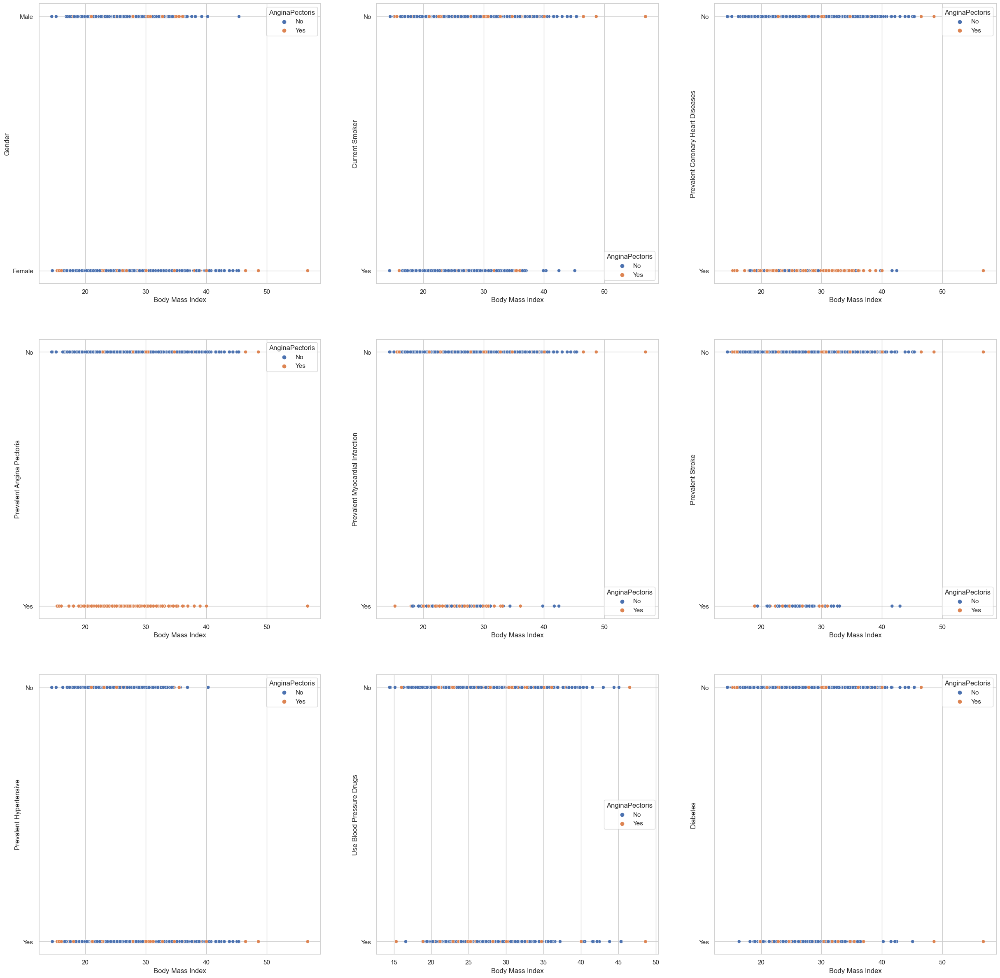

In [49]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Body Mass Index', ylabel='Gender');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Body Mass Index', ylabel='Current Smoker');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Body Mass Index', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Body Mass Index', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Body Mass Index', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Body Mass Index', ylabel='Prevalent Stroke');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Body Mass Index', ylabel='Prevalent Hypertensive');

sns.scatterplot(x = Heart['BodyMassIndex'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Body Mass Index', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x = Heart['BodyMassIndex'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Body Mass Index', ylabel='Diabetes');                      

**D. Systolic Blood Pressure**

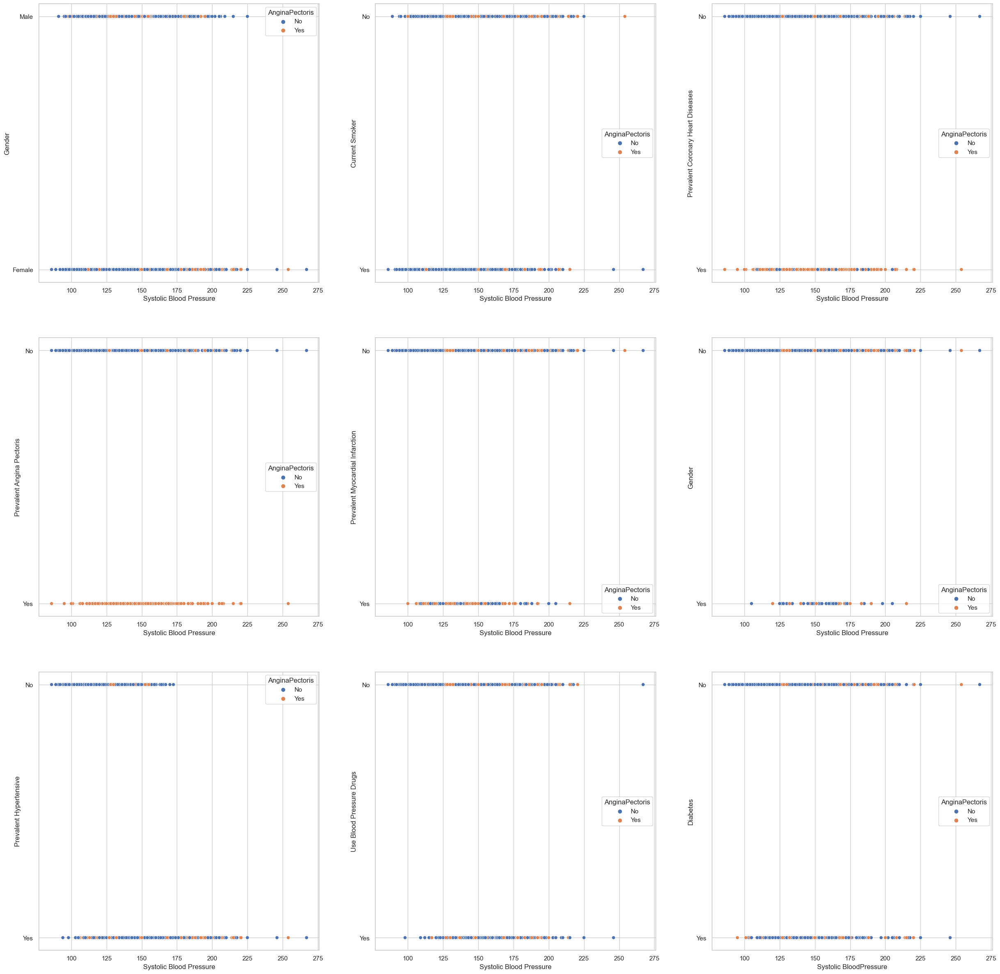

In [50]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x = Heart['SystolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Systolic Blood Pressure', ylabel='Current Smoker');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.scatterplot(x = Heart['SystolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Systolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x = Heart['SystolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Systolic BloodPressure', ylabel='Diabetes');                     

**E. Diastolic Blood Pressure**

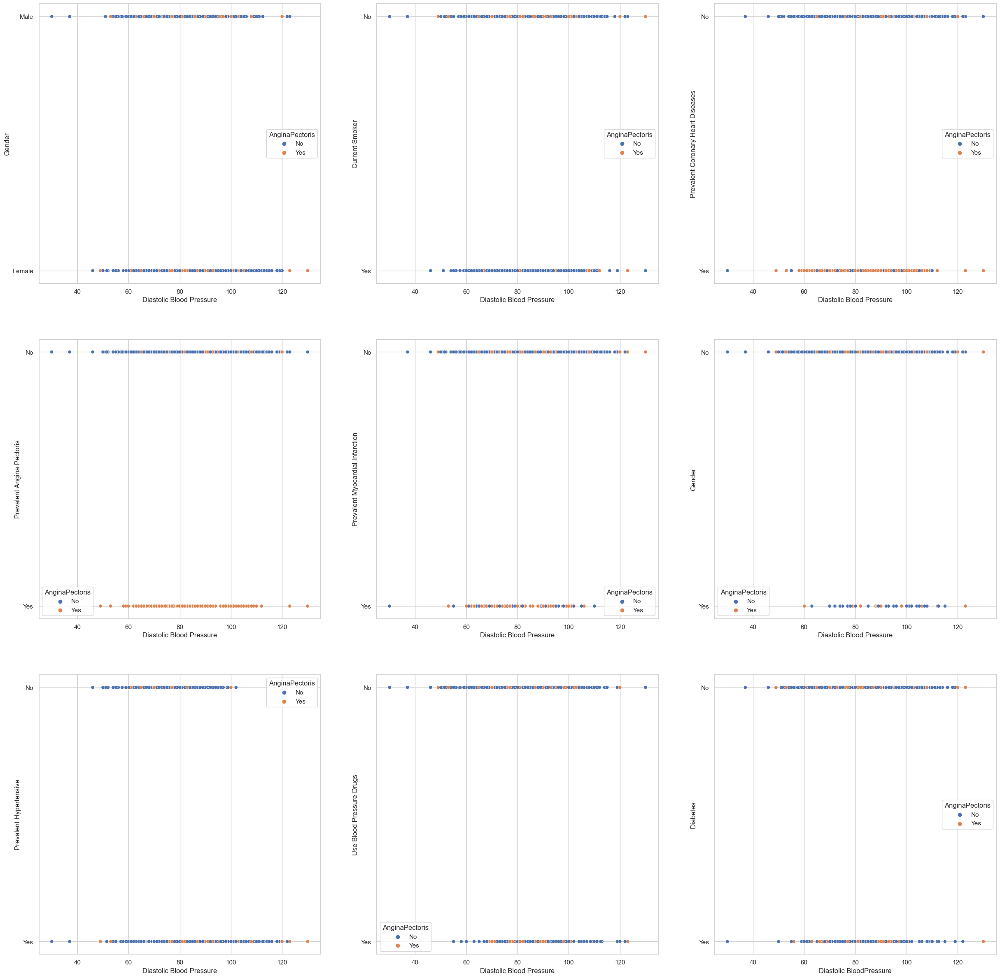

In [51]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x = Heart['DiastolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Diastolic Blood Pressure', ylabel='Current Smoker');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.scatterplot(x = Heart['DiastolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Diastolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x = Heart['DiastolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Diastolic BloodPressure', ylabel='Diabetes');                                         

**F. Heart Rate**

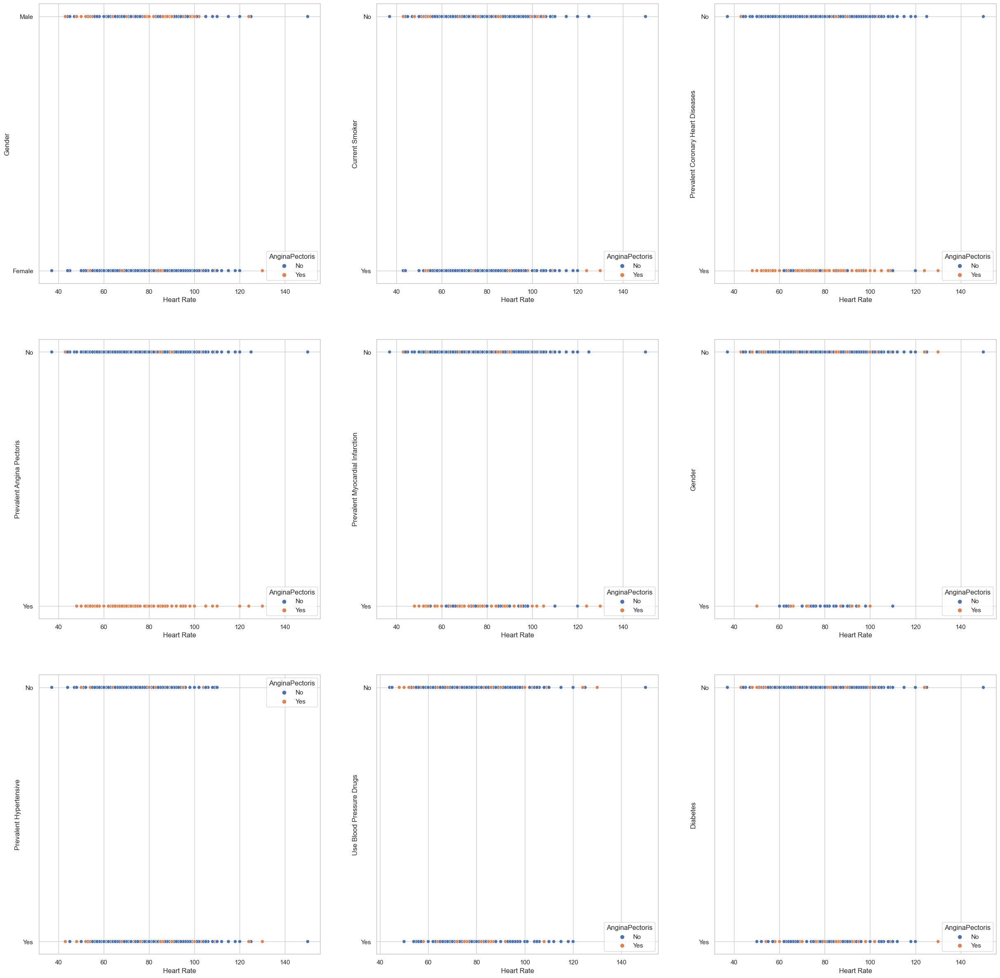

In [52]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x = Heart['HeartRate'], y =Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Heart Rate', ylabel='Gender');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Heart Rate', ylabel='Current Smoker');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Heart Rate', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Heart Rate', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Heart Rate', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Heart Rate', ylabel='Gender');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Heart Rate', ylabel='Prevalent Hypertensive');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Heart Rate', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x = Heart['HeartRate'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Heart Rate', ylabel='Diabetes');                                         

**F. Glucose**

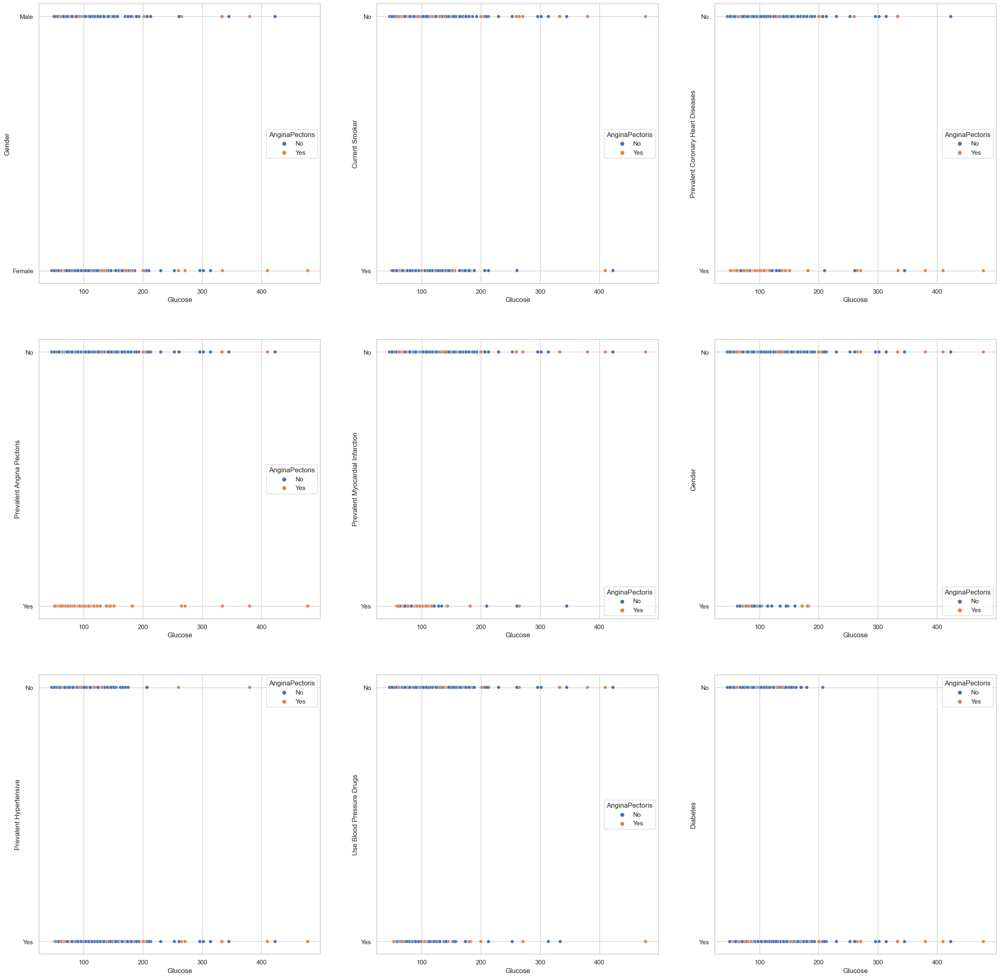

In [53]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x = Heart['Glucose'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Glucose', ylabel='Gender');

sns.scatterplot(x = Heart['Glucose'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Glucose', ylabel='Current Smoker');

sns.scatterplot(x = Heart['Glucose'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Glucose', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x = Heart['Glucose'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Glucose', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x =Heart['Glucose'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Glucose', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x =Heart['Glucose'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Glucose', ylabel='Gender');

sns.scatterplot(x =Heart['Glucose'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Glucose', ylabel='Prevalent Hypertensive');

sns.scatterplot(x =Heart['Glucose'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Glucose', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x =Heart['Glucose'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Glucose', ylabel='Diabetes'); 

**G. High Density Lipoprotein**

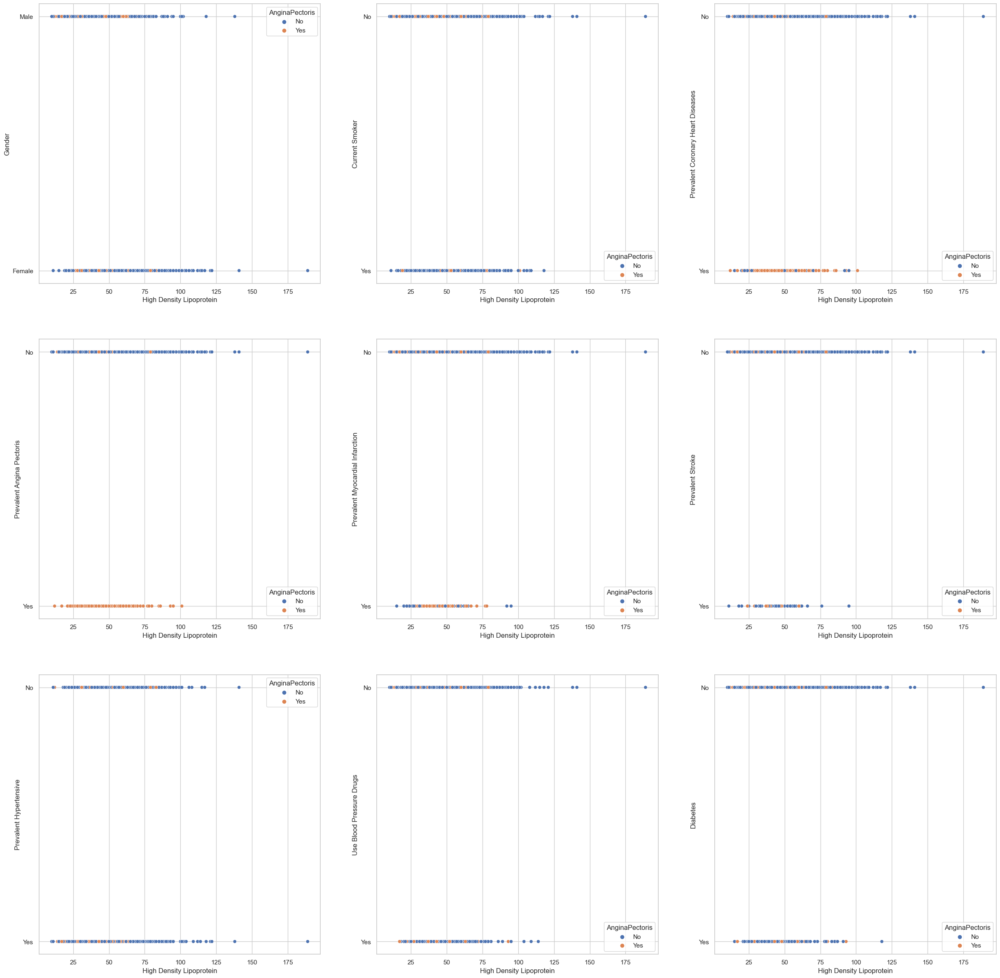

In [54]:
# H. HighDensityLipoprotein
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x =Heart['HighDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='High Density Lipoprotein', ylabel='Gender');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='High Density Lipoprotein', ylabel='Current Smoker');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Stroke');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.scatterplot(x =Heart['HighDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='High Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x =Heart['HighDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='High Density Lipoprotein', ylabel='Diabetes');  

**J. Low Density Lipoprotein**

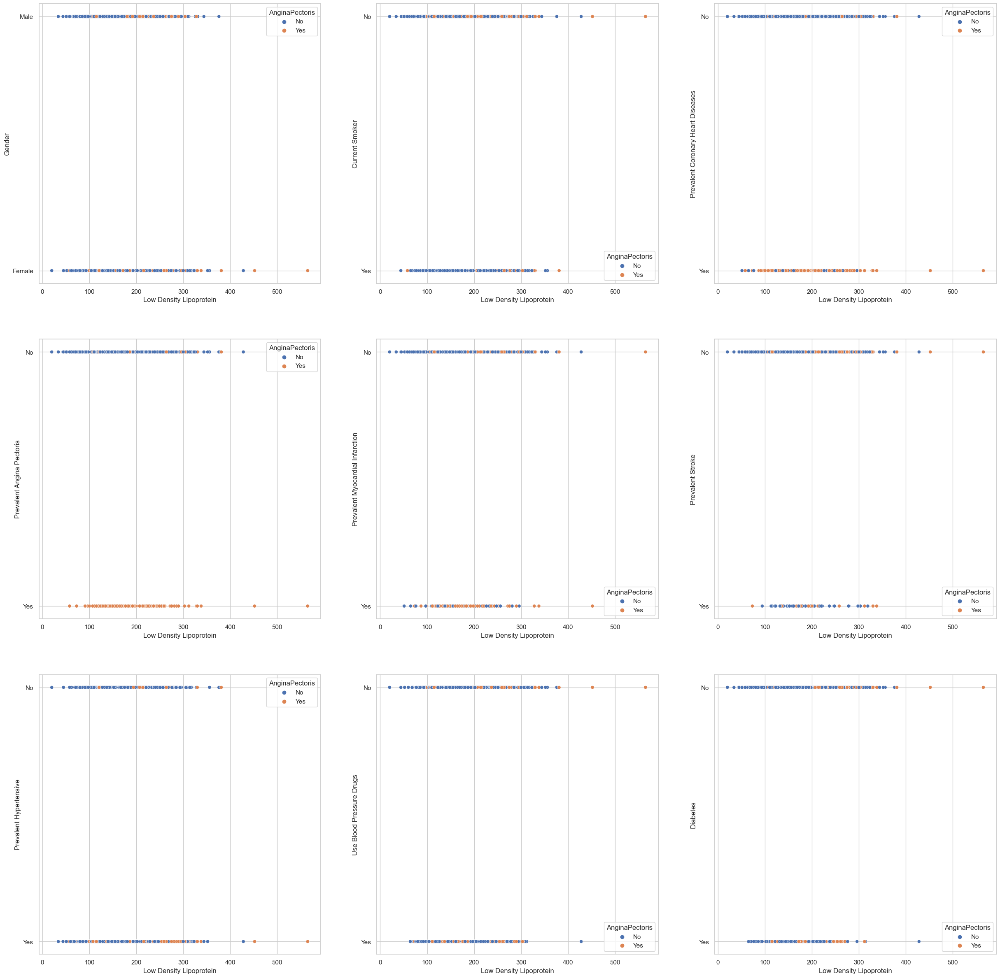

In [55]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x= Heart['LowDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Low Density Lipoprotein', ylabel='Gender');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Low Density Lipoprotein', ylabel='Current Smoker');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Stroke');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.scatterplot(x =Heart['LowDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Low Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x =Heart['LowDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Low Density Lipoprotein', ylabel='Diabetes');  

**K. Total Cholesterol**

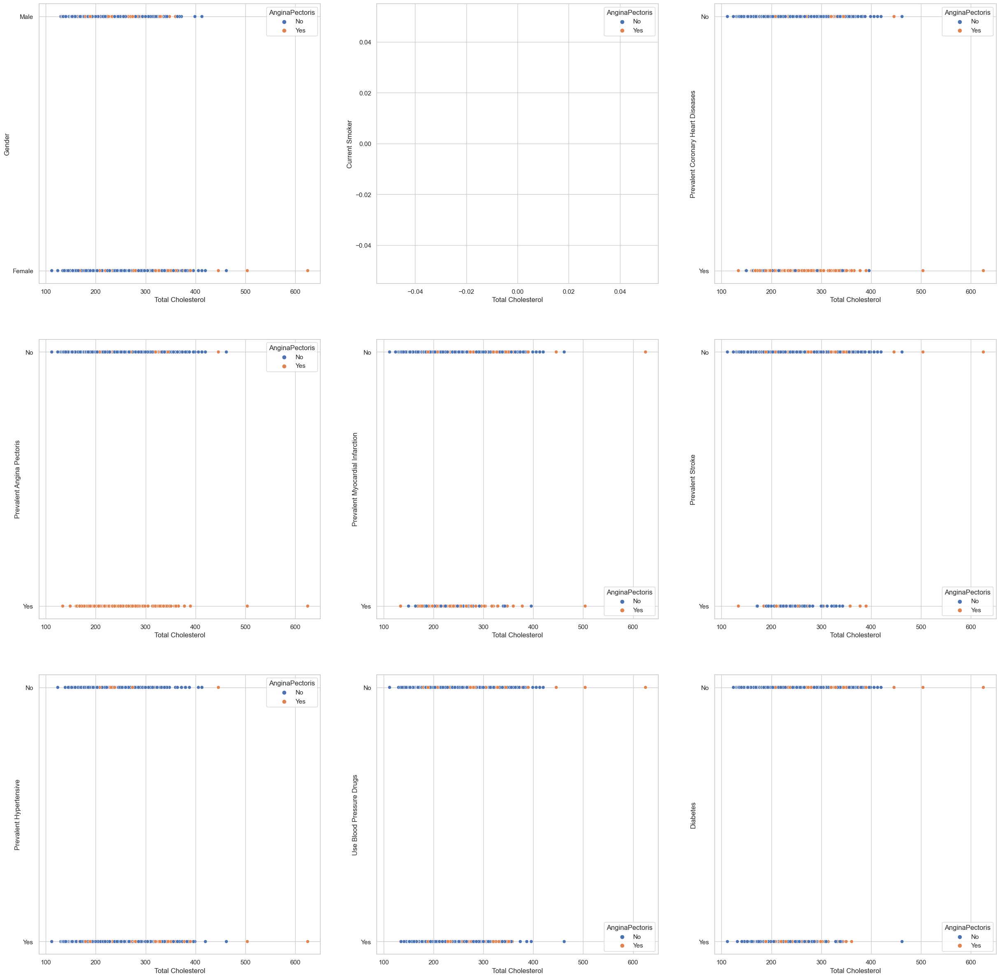

In [56]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.scatterplot(x =Heart['TotalCholesterol'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Total Cholesterol', ylabel='Gender');

sns.scatterplot(x =Heart['TotalCholesterol'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Total Cholesterol', ylabel='Current Smoker');

sns.scatterplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Total Cholesterol', ylabel='Prevalent Coronary Heart Diseases');

sns.scatterplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Total Cholesterol', ylabel='Prevalent Angina Pectoris');

sns.scatterplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Total Cholesterol', ylabel='Prevalent Myocardial Infarction');

sns.scatterplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Total Cholesterol', ylabel='Prevalent Stroke');

sns.scatterplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Total Cholesterol', ylabel='Prevalent Hypertensive');

sns.scatterplot(x =Heart['TotalCholesterol'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Total Cholesterol', ylabel='Use Blood Pressure Drugs');

sns.scatterplot(x =Heart['TotalCholesterol'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Total Cholesterol', ylabel='Diabetes');                       

**3. Box Plot**

**A. Age**

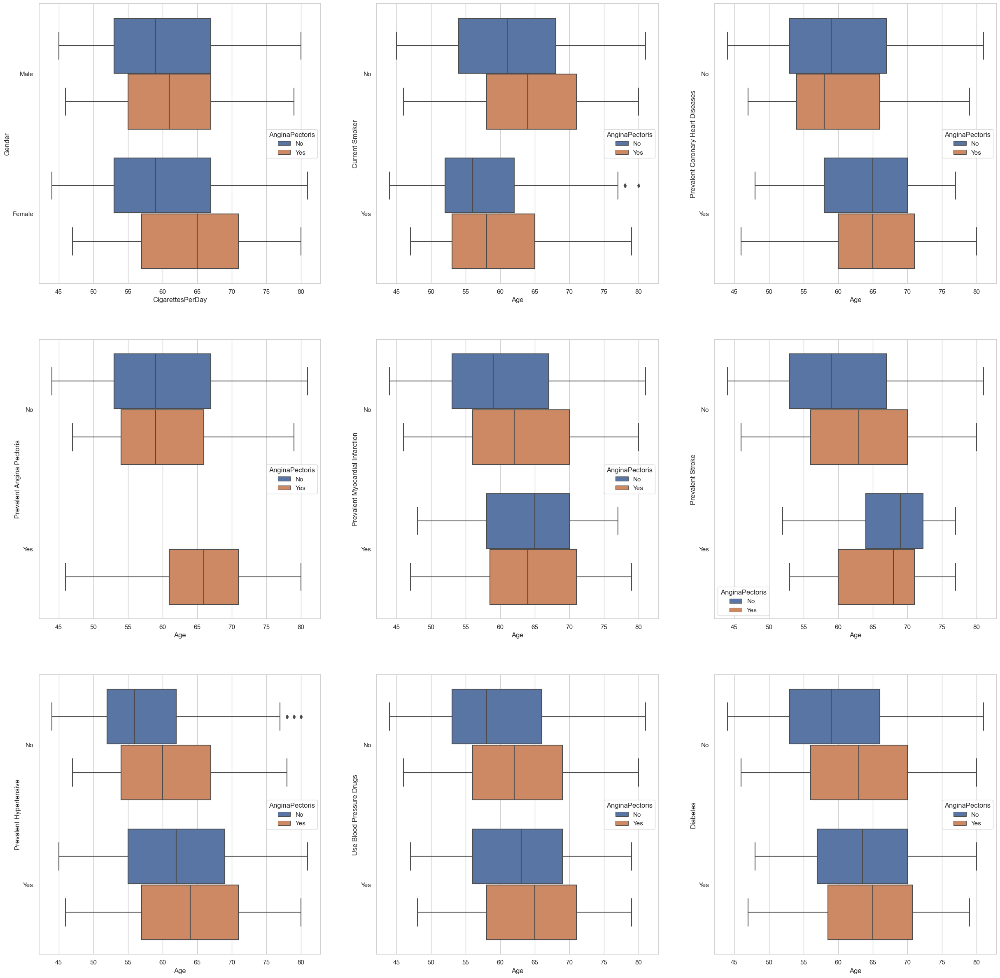

In [57]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x =Heart['Age'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='CigarettesPerDay', ylabel='Gender');

sns.boxplot(x =Heart['Age'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Age', ylabel='Current Smoker');

sns.boxplot(x =Heart['Age'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Age', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x =Heart['Age'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Age', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x =Heart['Age'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Age', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x =Heart['Age'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Age', ylabel='Prevalent Stroke');

sns.boxplot(x =Heart['Age'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Age', ylabel='Prevalent Hypertensive');

sns.boxplot(x =Heart['Age'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Age', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x =Heart['Age'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Age', ylabel='Diabetes');

**B. Cigarettes Per Day**

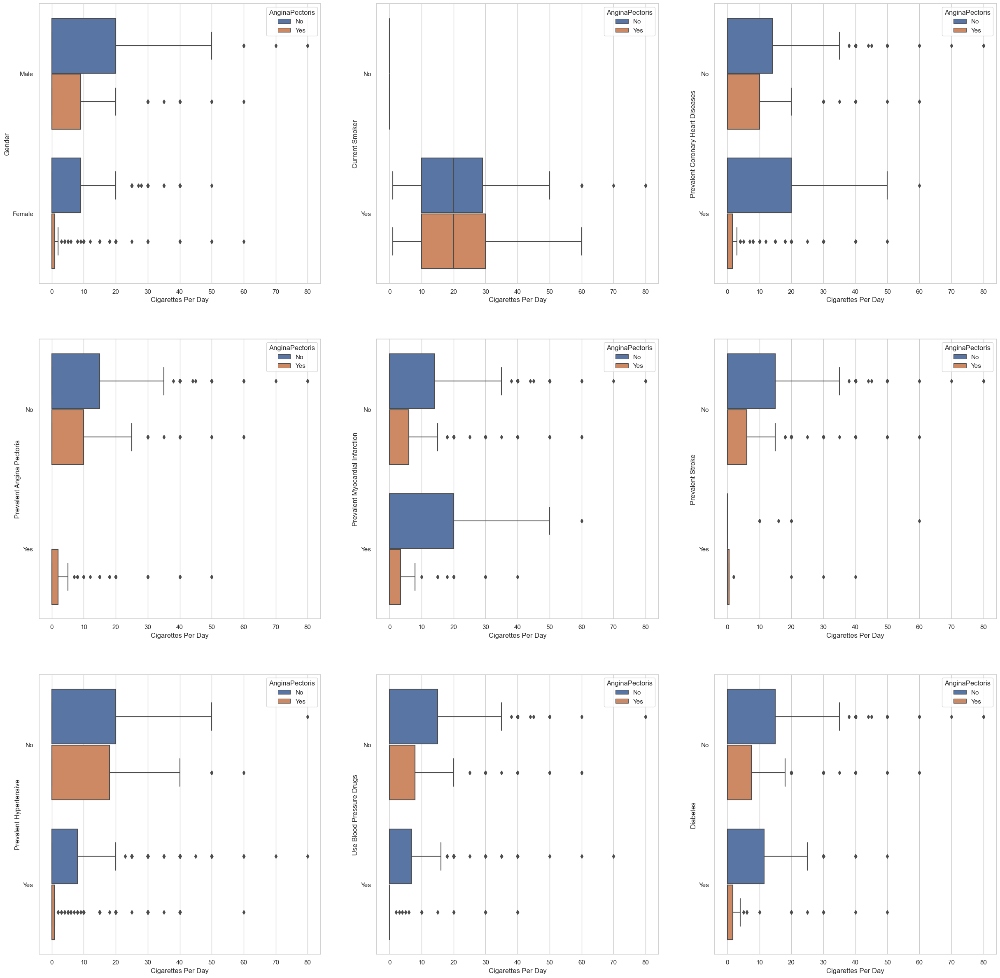

In [58]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x =Heart['CigarettesPerDay'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Cigarettes Per Day', ylabel='Gender');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Cigarettes Per Day', ylabel='Current Smoker');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Stroke');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Hypertensive');

sns.boxplot(x =Heart['CigarettesPerDay'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Cigarettes Per Day', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x =Heart['CigarettesPerDay'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Cigarettes Per Day', ylabel='Diabetes');

**C. Body Mass Index**

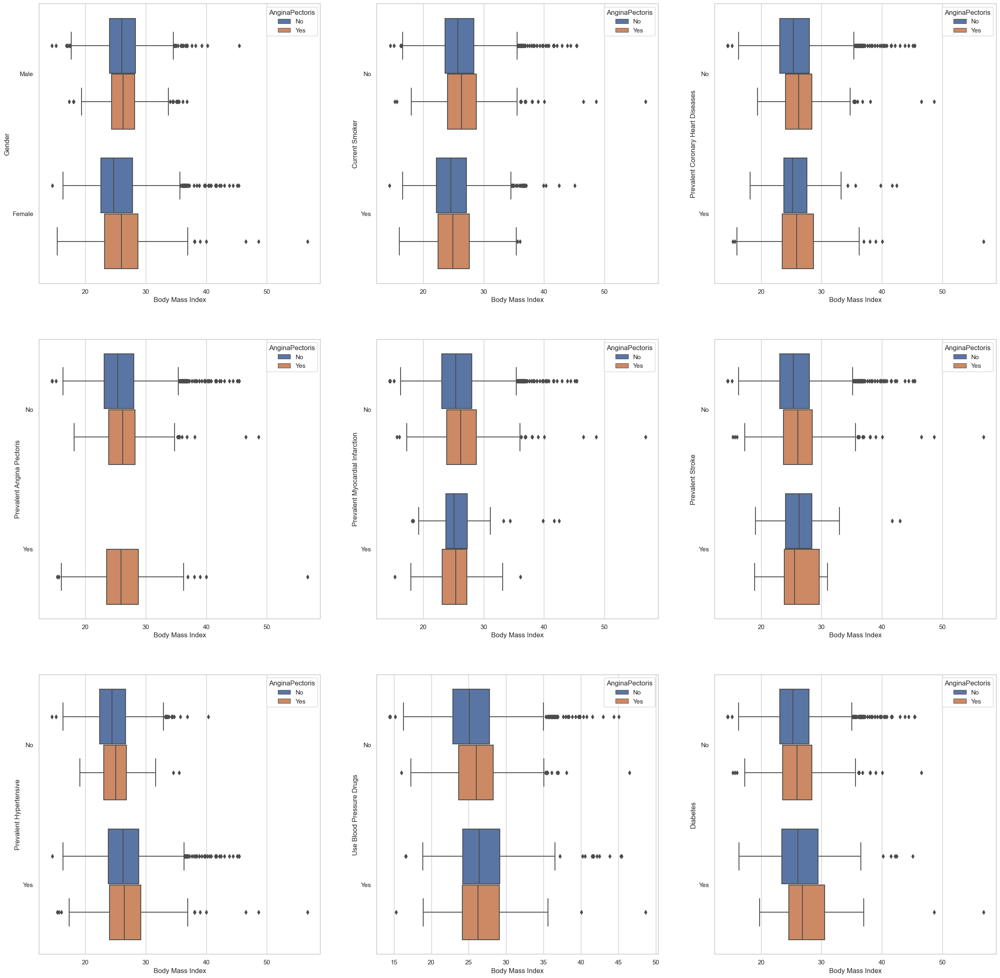

In [59]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x =Heart['BodyMassIndex'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Body Mass Index', ylabel='Gender');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Body Mass Index', ylabel='Current Smoker');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Body Mass Index', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Body Mass Index', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Body Mass Index', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Body Mass Index', ylabel='Prevalent Stroke');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Body Mass Index', ylabel='Prevalent Hypertensive');

sns.boxplot(x =Heart['BodyMassIndex'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Body Mass Index', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x =Heart['BodyMassIndex'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Body Mass Index', ylabel='Diabetes');                       

**D. Systolic Blood Pressure**

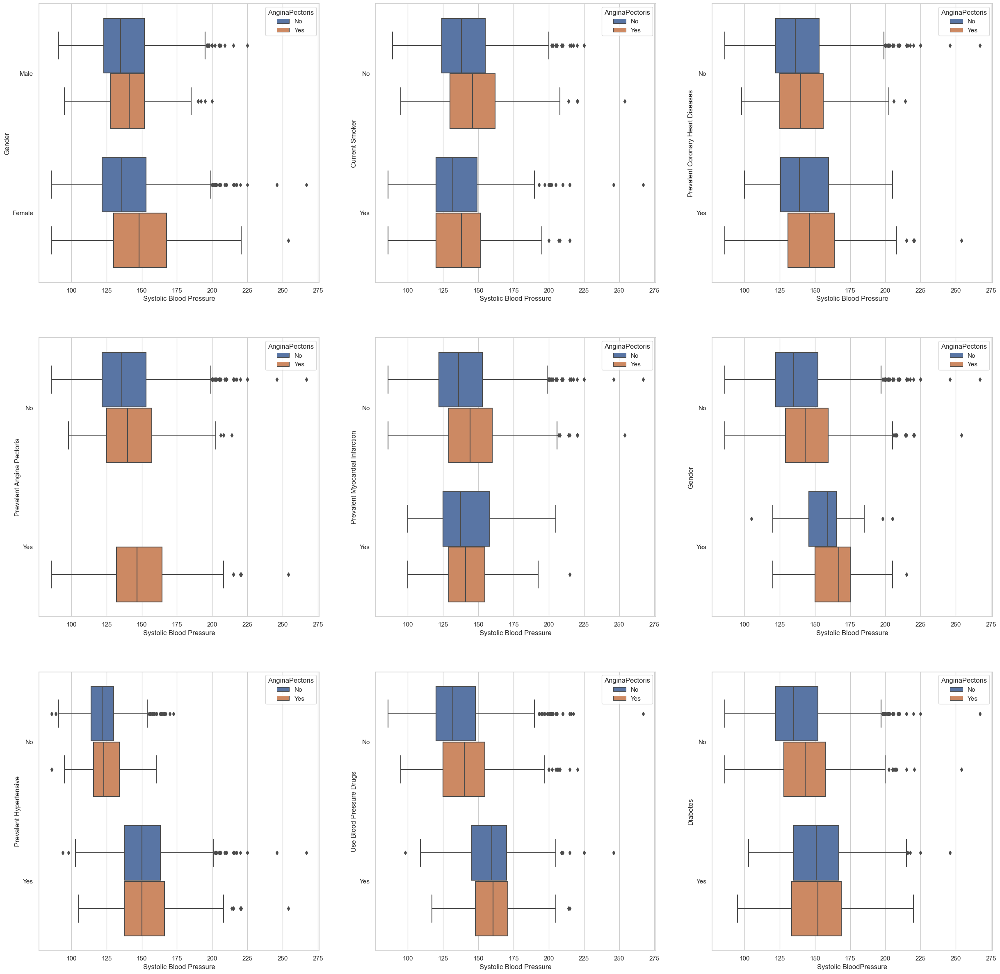

In [60]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x =Heart['SystolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Systolic Blood Pressure', ylabel='Current Smoker');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.boxplot(x =Heart['SystolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Systolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x =Heart['SystolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Systolic BloodPressure', ylabel='Diabetes');                       

**E. Diastolic Blood Pressure**

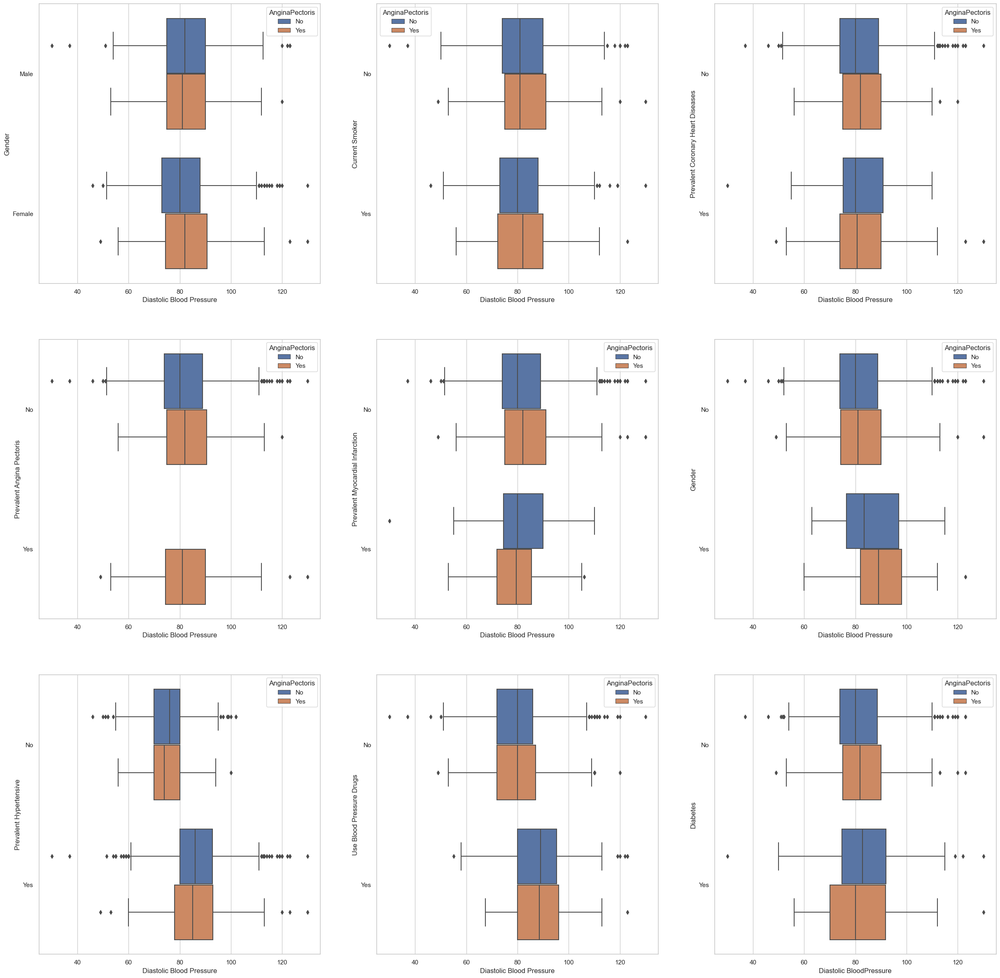

In [61]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['DiastolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Diastolic Blood Pressure', ylabel='Current Smoker');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['DiastolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Diastolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['DiastolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Diastolic BloodPressure', ylabel='Diabetes');                                      

**F. Heart Rate**

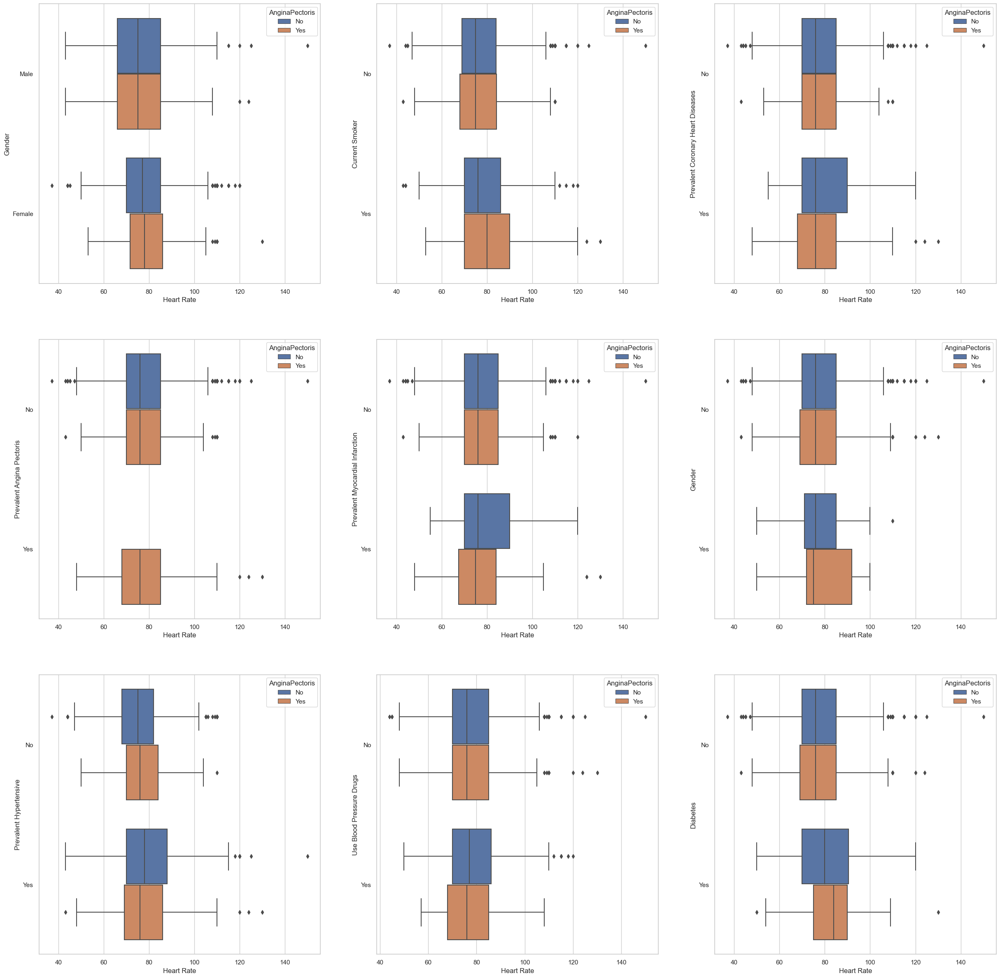

In [62]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['HeartRate'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Heart Rate', ylabel='Gender');

sns.boxplot(x = Heart['HeartRate'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Heart Rate', ylabel='Current Smoker');

sns.boxplot(x = Heart['HeartRate'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Heart Rate', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['HeartRate'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Heart Rate', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['HeartRate'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Heart Rate', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['HeartRate'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Heart Rate', ylabel='Gender');

sns.boxplot(x = Heart['HeartRate'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Heart Rate', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['HeartRate'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Heart Rate', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['HeartRate'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Heart Rate', ylabel='Diabetes');                                          

**G. Glucose**

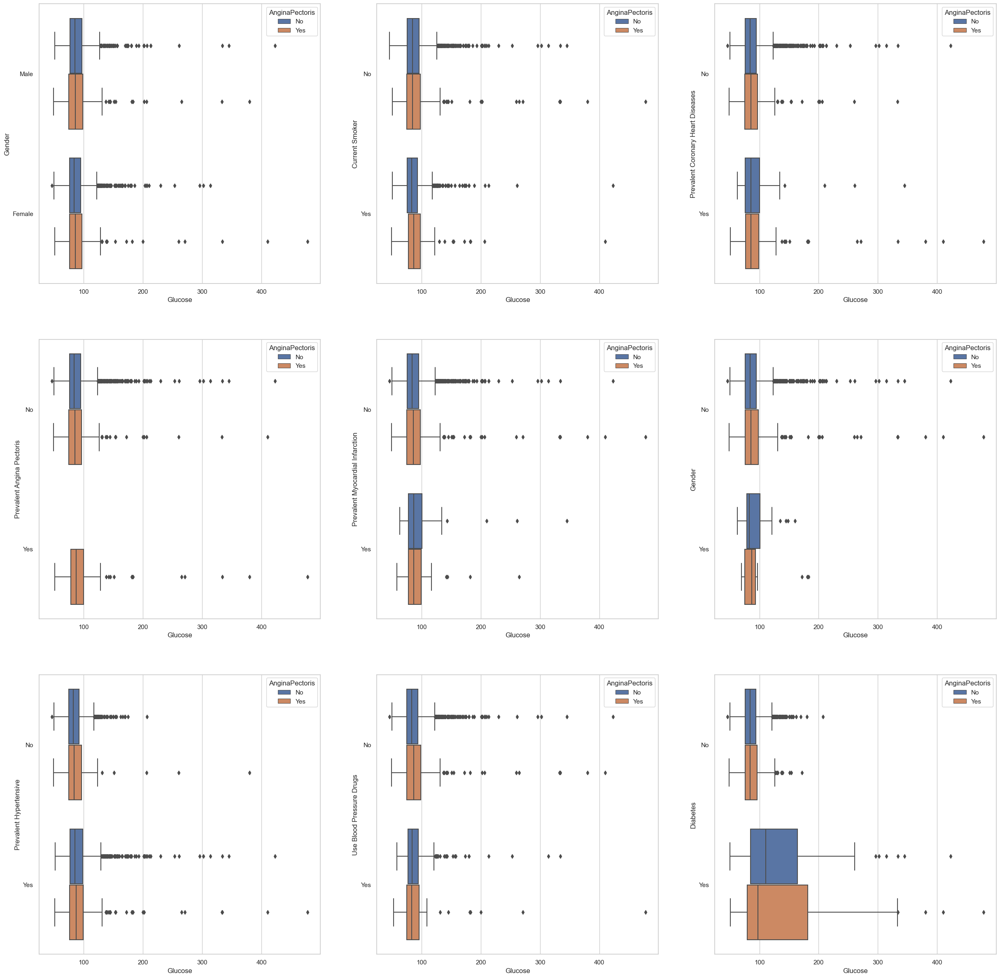

In [63]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['Glucose'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Glucose', ylabel='Gender');

sns.boxplot(x = Heart['Glucose'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Glucose', ylabel='Current Smoker');

sns.boxplot(x = Heart['Glucose'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Glucose', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['Glucose'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Glucose', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['Glucose'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Glucose', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['Glucose'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Glucose', ylabel='Gender');

sns.boxplot(x = Heart['Glucose'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Glucose', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['Glucose'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Glucose', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['Glucose'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Glucose', ylabel='Diabetes');

**H. High Density Lipoprotein**

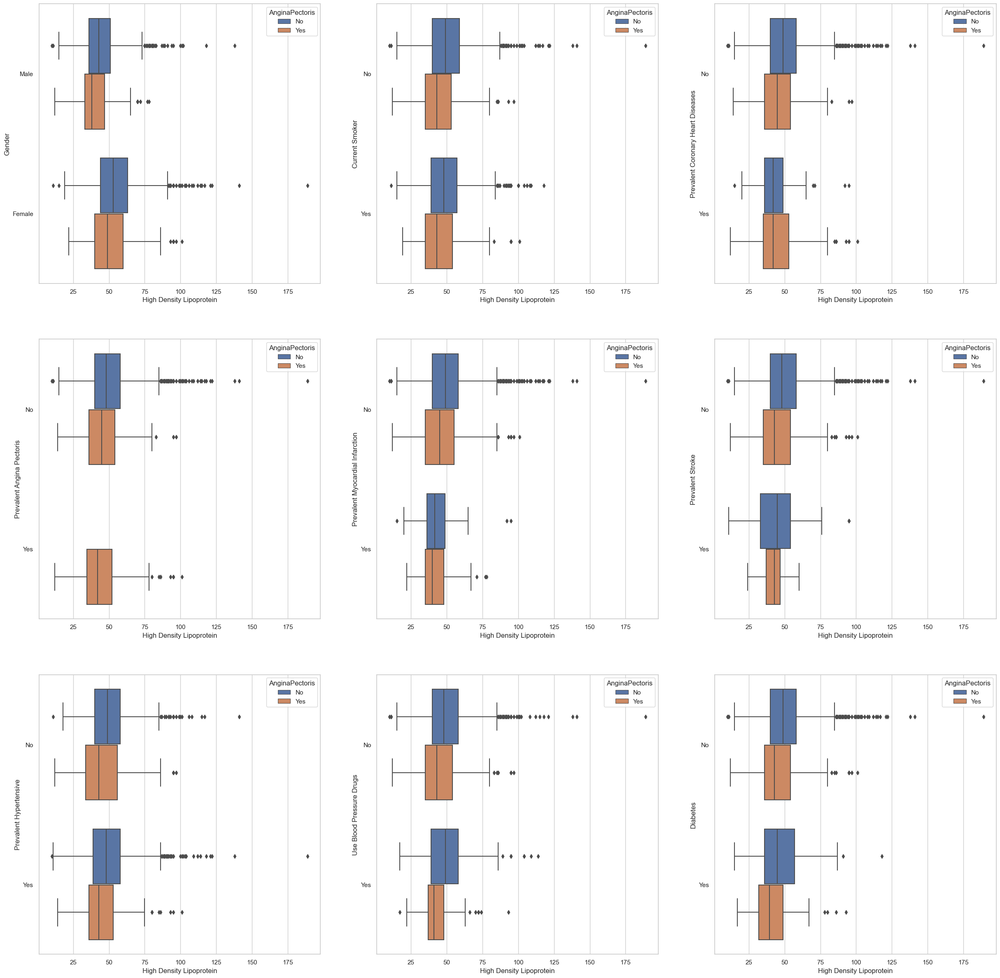

In [64]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['HighDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='High Density Lipoprotein', ylabel='Gender');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='High Density Lipoprotein', ylabel='Current Smoker');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Stroke');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['HighDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='High Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['HighDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='High Density Lipoprotein', ylabel='Diabetes');

**J. Low Density Lipoprotein**

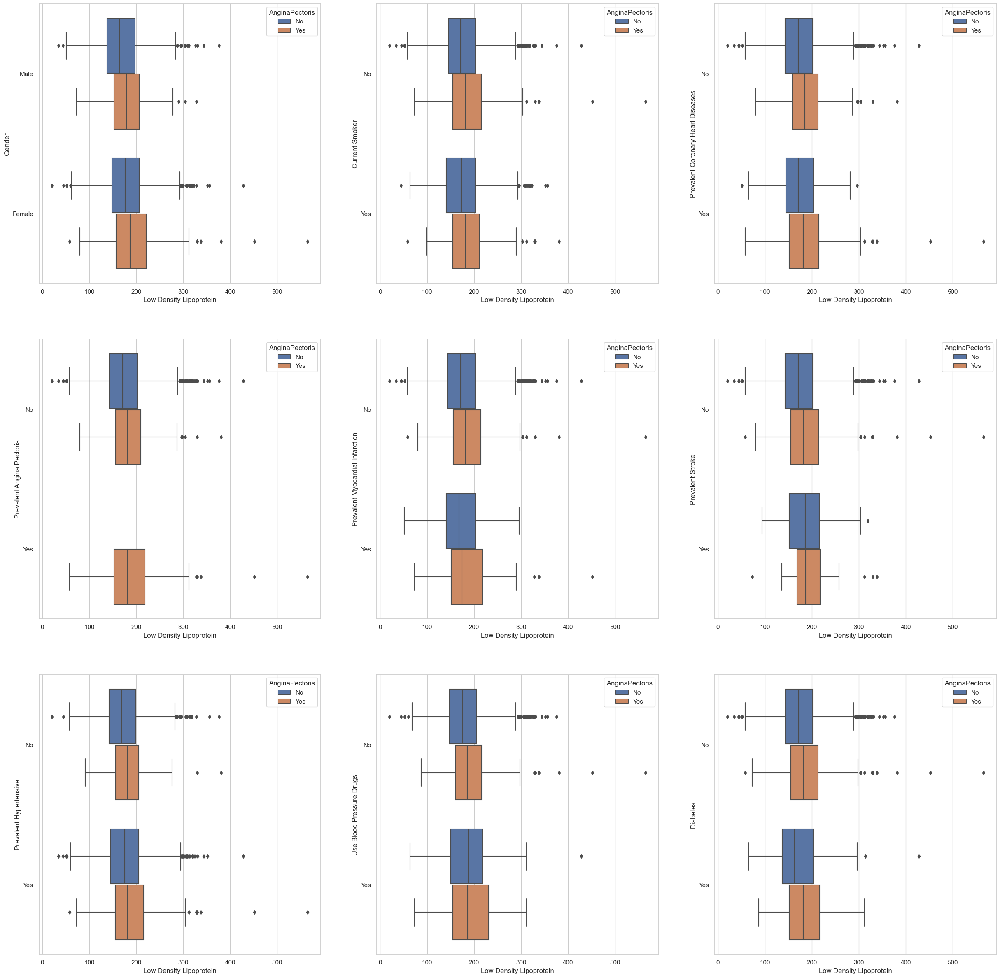

In [65]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['LowDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Low Density Lipoprotein', ylabel='Gender');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Low Density Lipoprotein', ylabel='Current Smoker');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Stroke');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['LowDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Low Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['LowDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Low Density Lipoprotein', ylabel='Diabetes');

**K. Total Cholesterol**

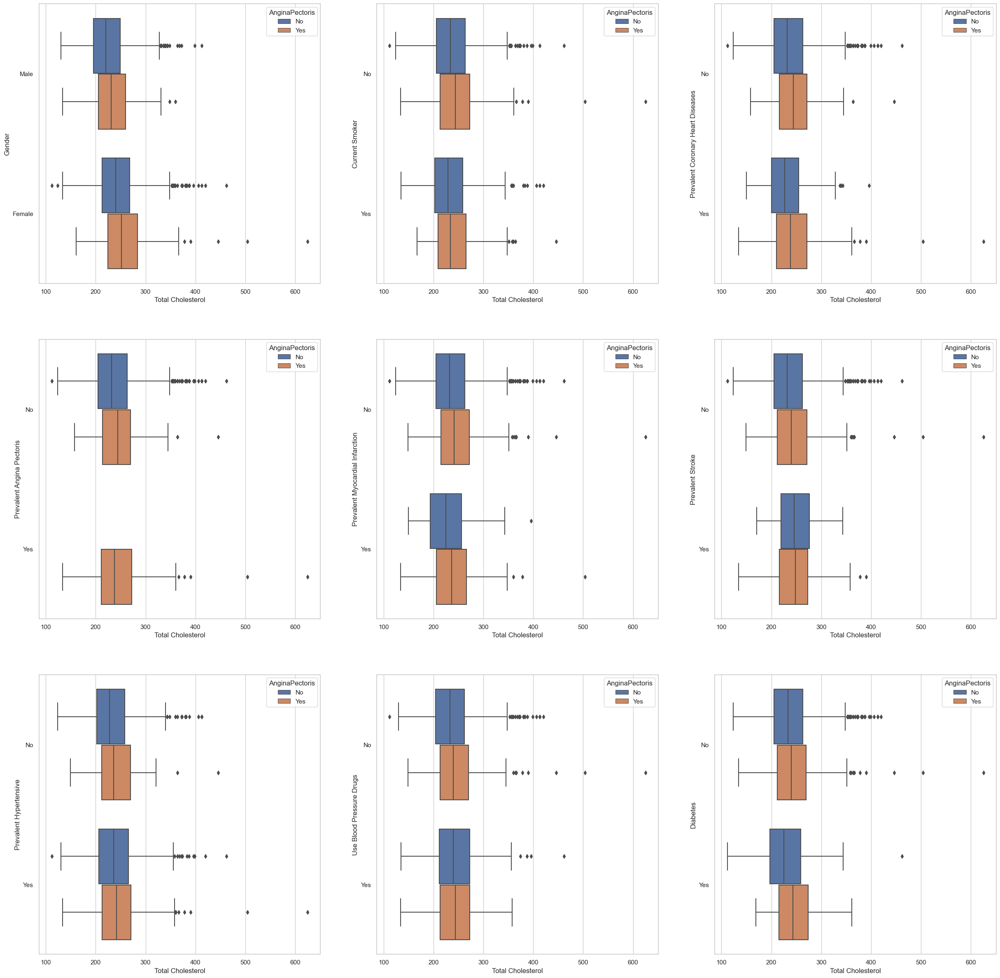

In [66]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['TotalCholesterol'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Total Cholesterol', ylabel='Gender');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Total Cholesterol', ylabel='Current Smoker');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Total Cholesterol', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Total Cholesterol', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Total Cholesterol', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Total Cholesterol', ylabel='Prevalent Stroke');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Total Cholesterol', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['TotalCholesterol'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Total Cholesterol', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['TotalCholesterol'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Total Cholesterol', ylabel='Diabetes');                  

**4. Bar Plot**

**A. Age**

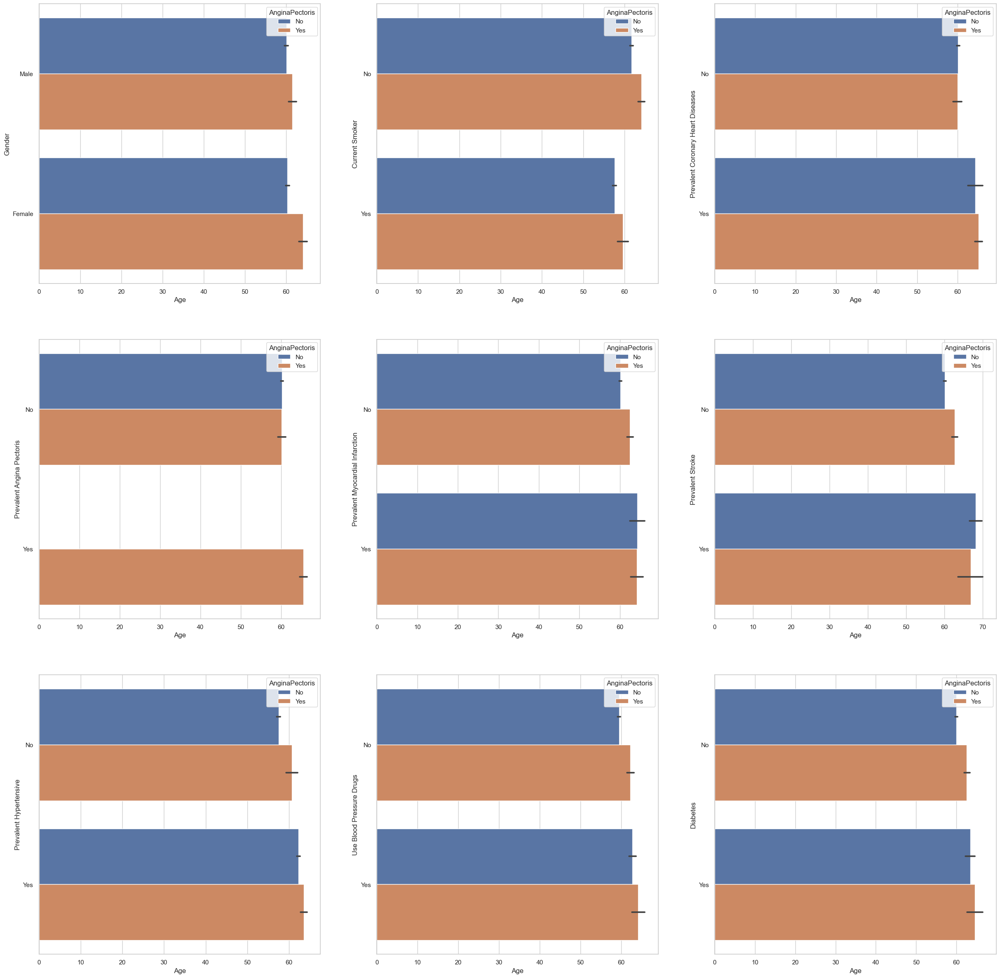

In [67]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['Age'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Age', ylabel='Gender');

sns.barplot(x = Heart['Age'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Age', ylabel='Current Smoker');

sns.barplot(x = Heart['Age'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Age', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['Age'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Age', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['Age'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Age', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['Age'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Age', ylabel='Prevalent Stroke');

sns.barplot(x = Heart['Age'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Age', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['Age'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Age', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['Age'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Age', ylabel='Diabetes');

**B. Cigarettes Per Day**

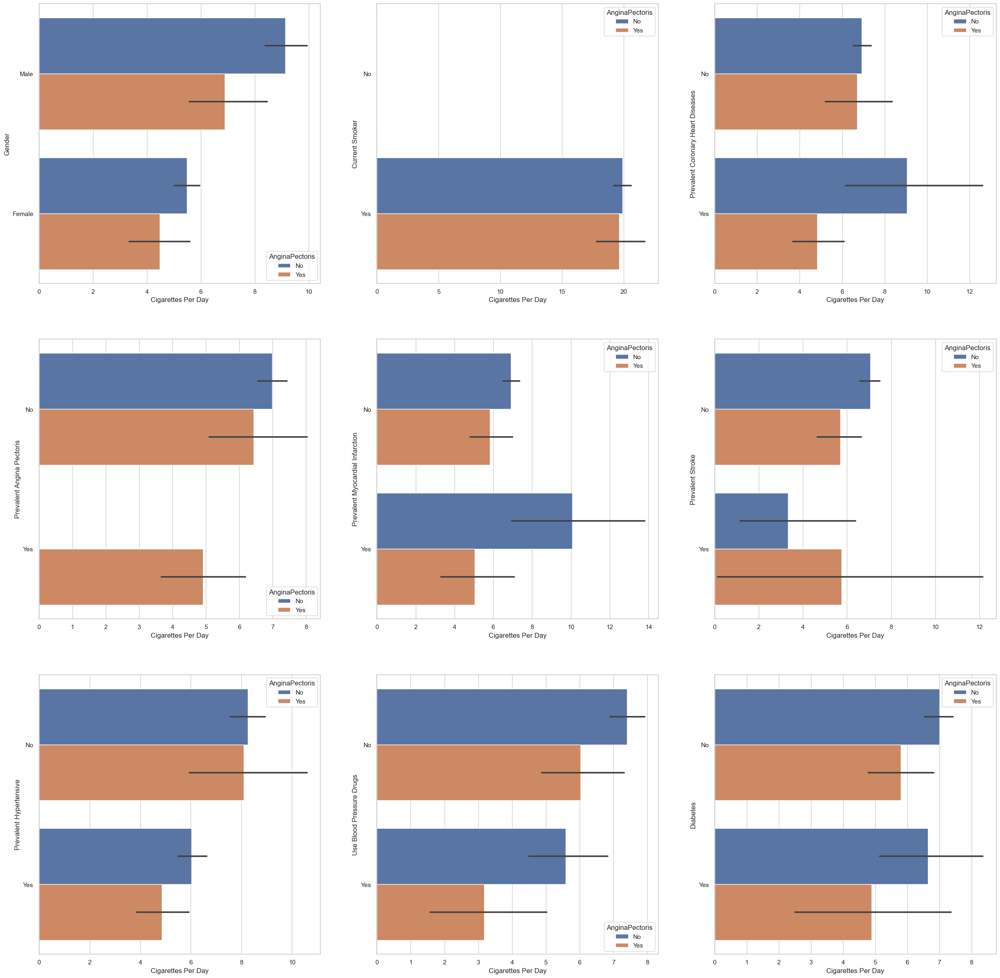

In [68]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['CigarettesPerDay'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Cigarettes Per Day', ylabel='Gender');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Cigarettes Per Day', ylabel='Current Smoker');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Stroke');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['CigarettesPerDay'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Cigarettes Per Day', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['CigarettesPerDay'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Cigarettes Per Day', ylabel='Diabetes');

**C. Body Mass Index**

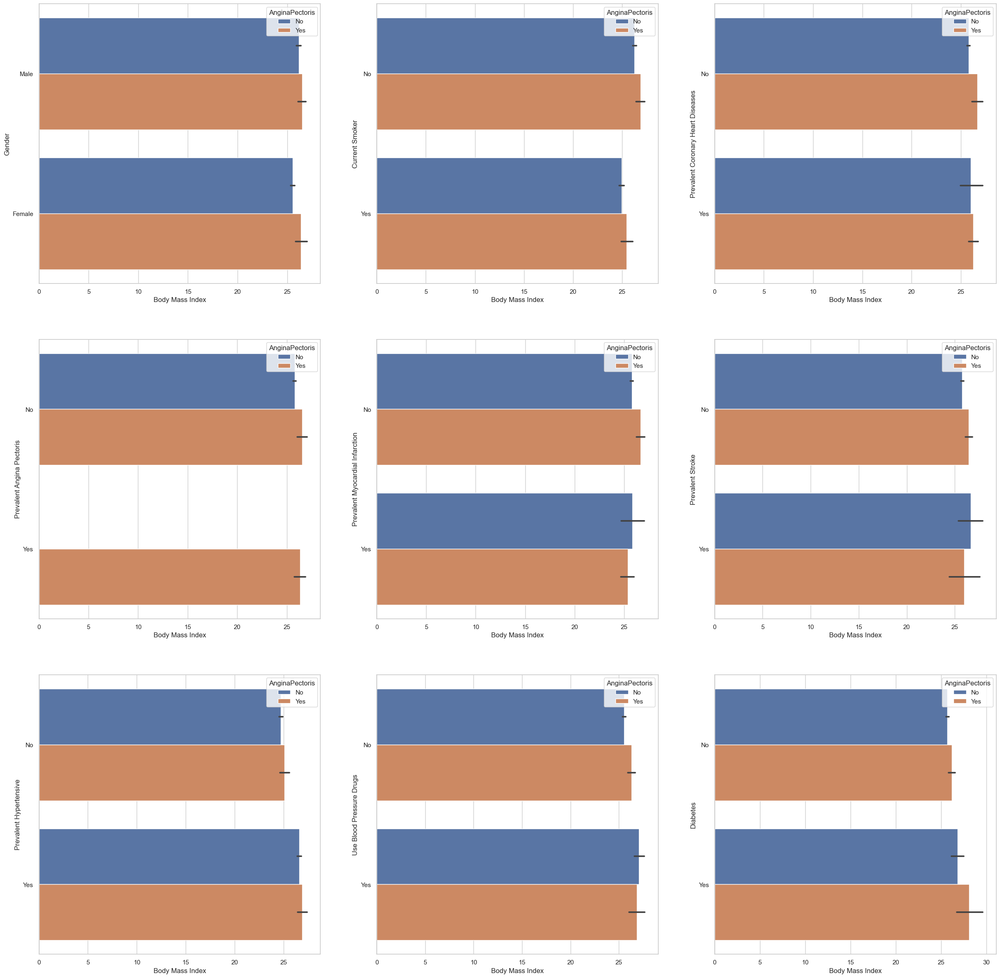

In [69]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['BodyMassIndex'], y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Body Mass Index', ylabel='Gender');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Body Mass Index', ylabel='Current Smoker');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Body Mass Index', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Body Mass Index', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Body Mass Index', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Body Mass Index', ylabel='Prevalent Stroke');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Body Mass Index', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['BodyMassIndex'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Body Mass Index', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['BodyMassIndex'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Body Mass Index', ylabel='Diabetes');                    

**D. Systolic Blood Pressure**

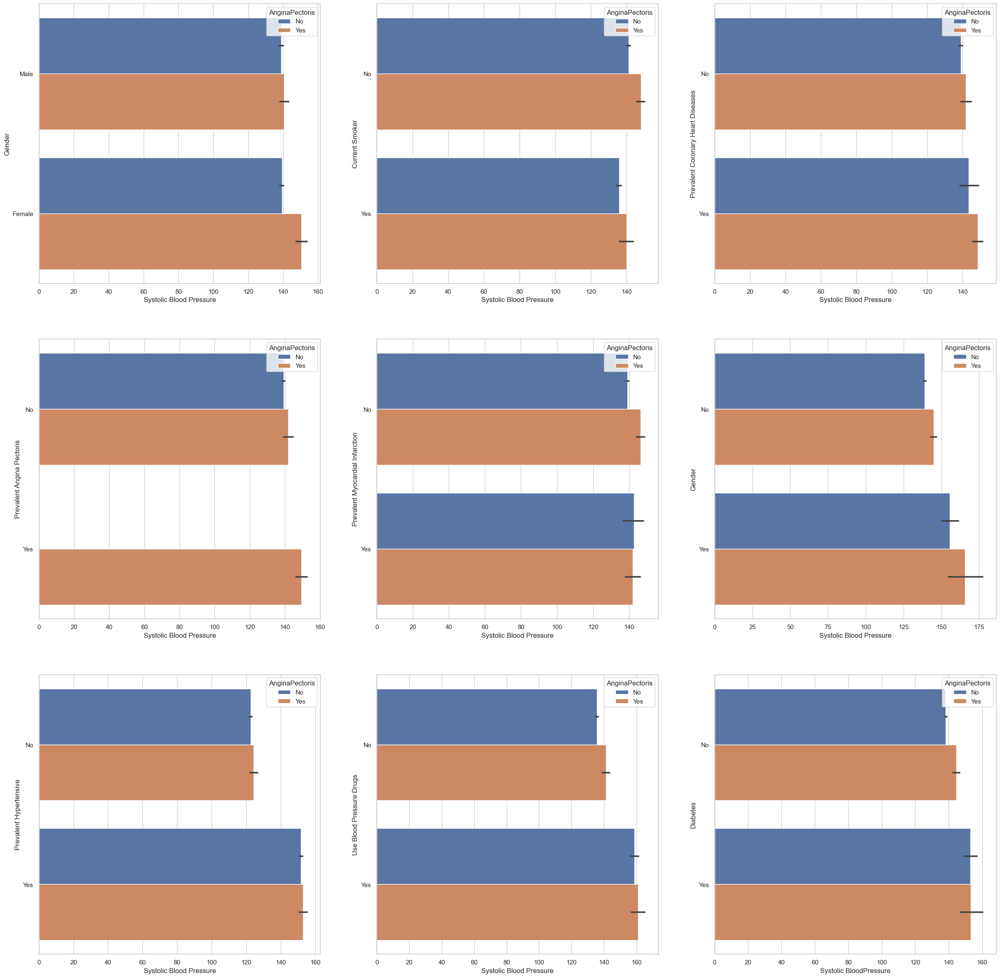

In [70]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x =Heart['SystolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Systolic Blood Pressure', ylabel='Current Smoker');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.barplot(x =Heart['SystolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Systolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.barplot(x =Heart['SystolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Systolic BloodPressure', ylabel='Diabetes');                      

**E. Diastolic Blood Pressure**

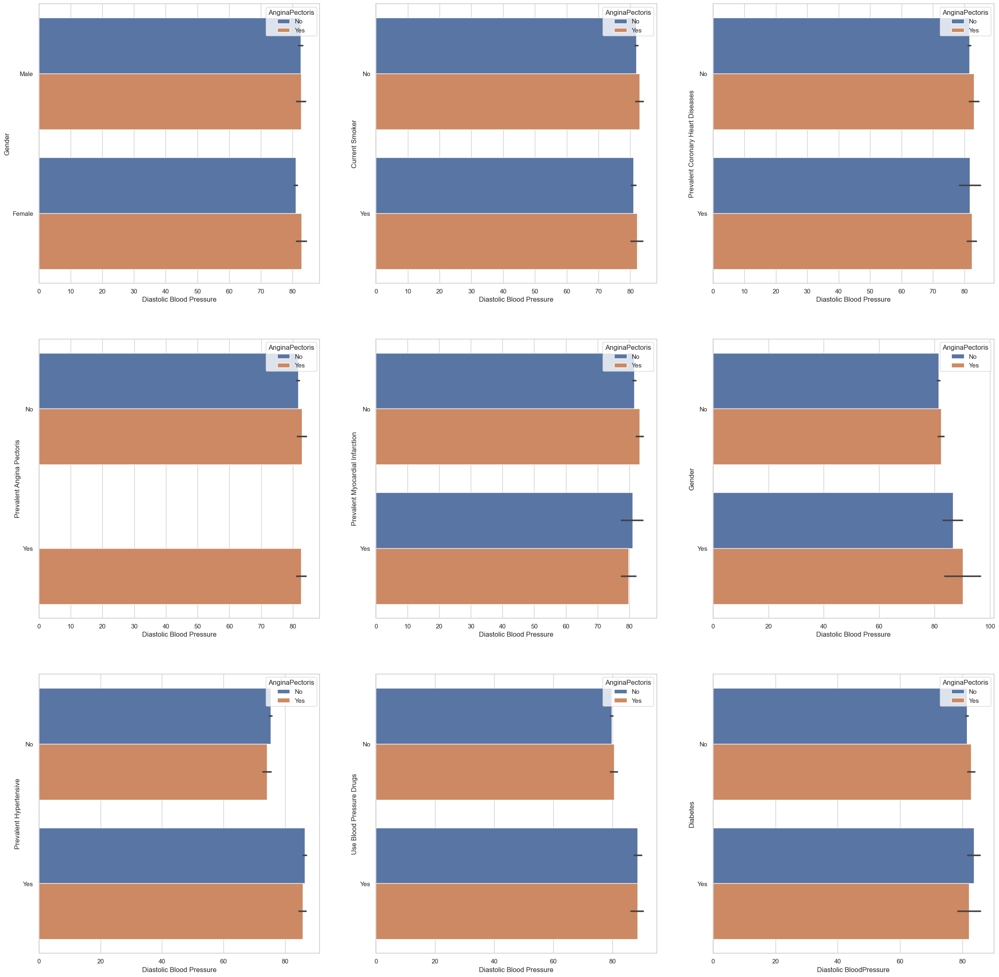

In [71]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['DiastolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Diastolic Blood Pressure', ylabel='Current Smoker');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['DiastolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Diastolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['DiastolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Diastolic BloodPressure', ylabel='Diabetes');                                          

**F. Heart Rate**

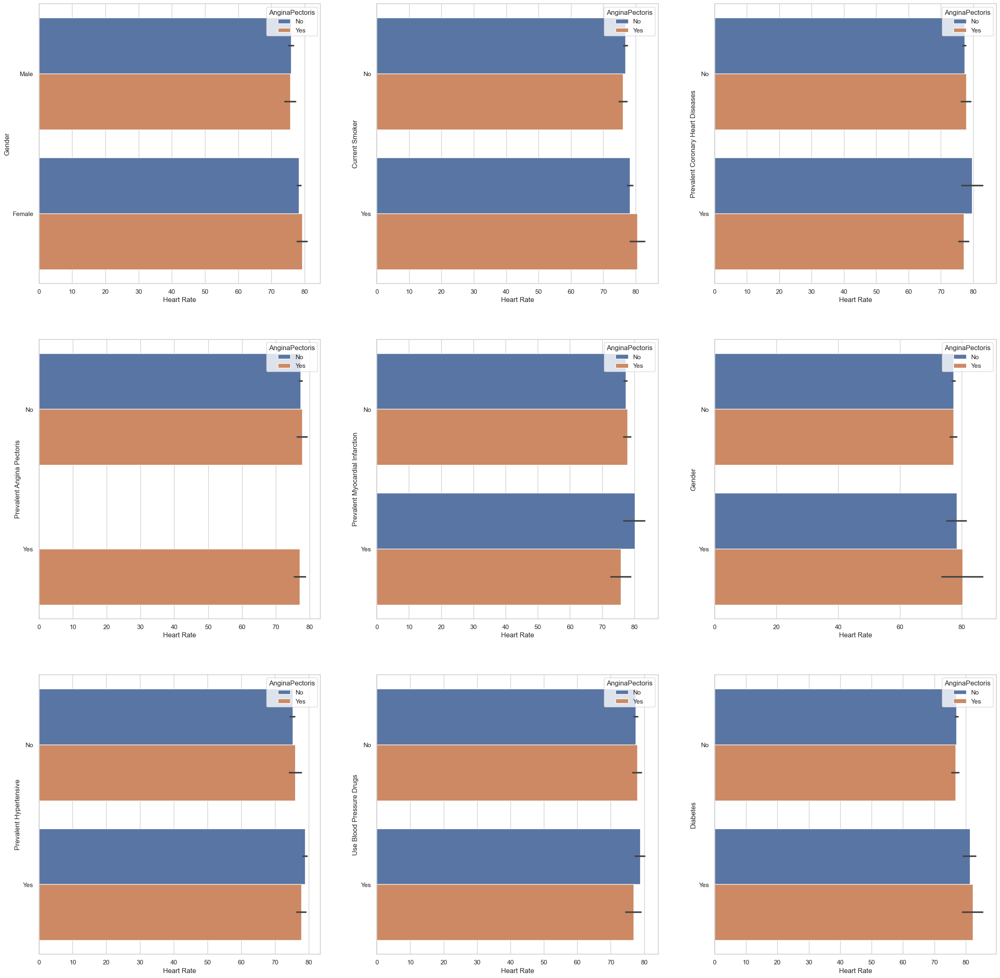

In [72]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['HeartRate'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Heart Rate', ylabel='Gender');

sns.barplot(x = Heart['HeartRate'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Heart Rate', ylabel='Current Smoker');

sns.barplot(x = Heart['HeartRate'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Heart Rate', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['HeartRate'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Heart Rate', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['HeartRate'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Heart Rate', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['HeartRate'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Heart Rate', ylabel='Gender');

sns.barplot(x = Heart['HeartRate'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Heart Rate', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['HeartRate'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Heart Rate', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['HeartRate'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Heart Rate', ylabel='Diabetes');                                          

**G. Glucose**

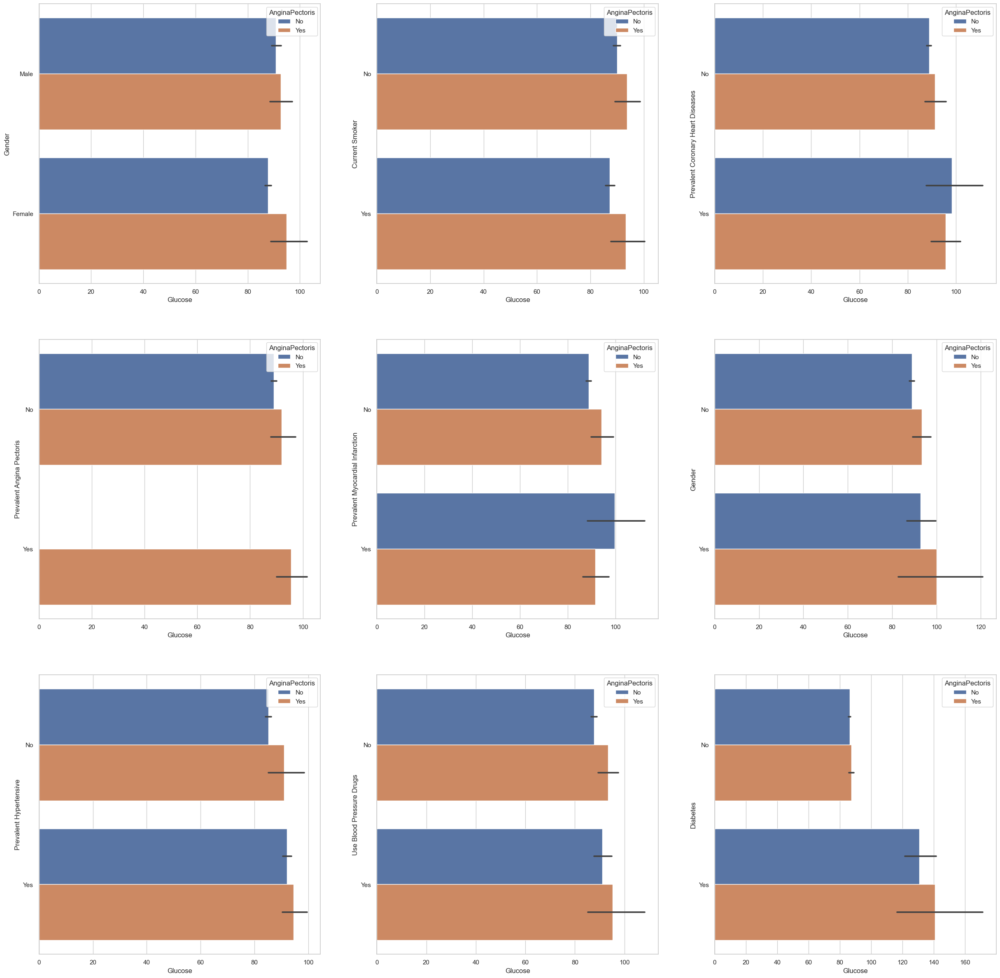

In [73]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['Glucose'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Glucose', ylabel='Gender');

sns.barplot(x = Heart['Glucose'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Glucose', ylabel='Current Smoker');

sns.barplot(x = Heart['Glucose'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Glucose', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['Glucose'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Glucose', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['Glucose'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Glucose', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['Glucose'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Glucose', ylabel='Gender');

sns.barplot(x = Heart['Glucose'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Glucose', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['Glucose'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Glucose', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['Glucose'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Glucose', ylabel='Diabetes');  

**H. High Density Lipoprotein**

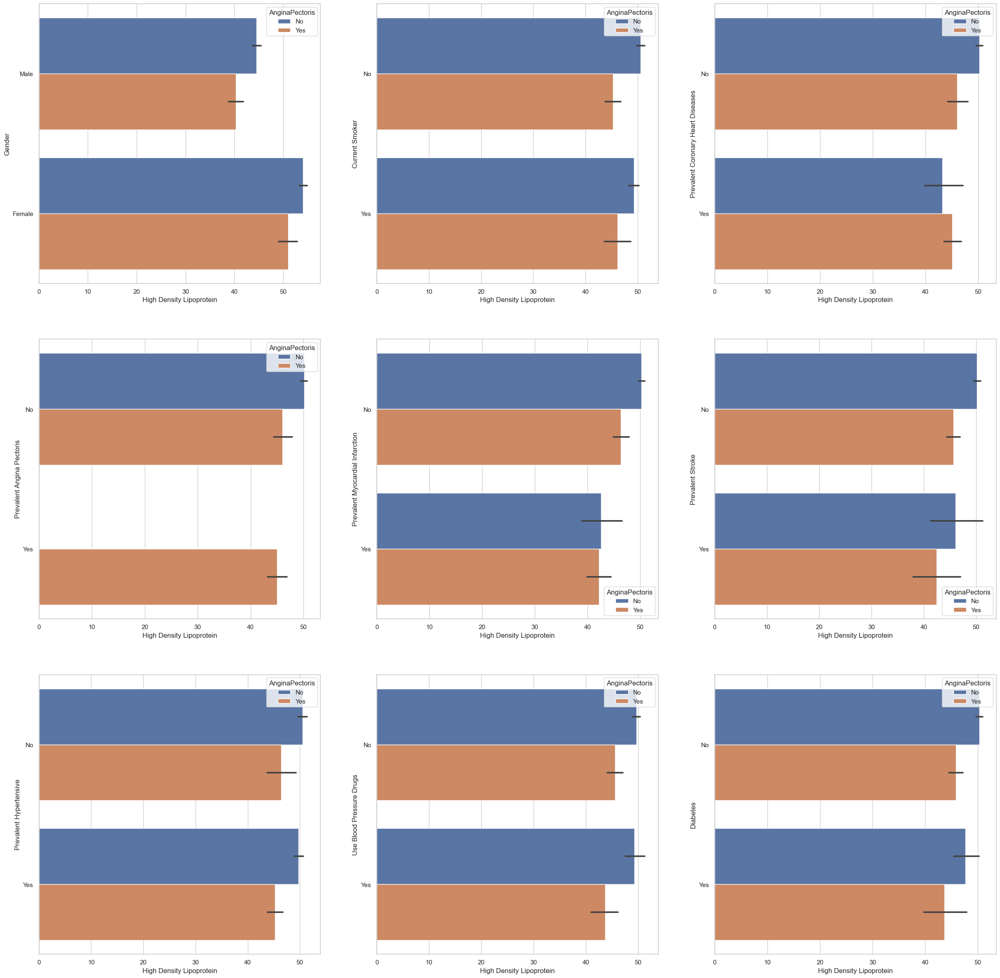

In [74]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['HighDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='High Density Lipoprotein', ylabel='Gender');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='High Density Lipoprotein', ylabel='Current Smoker');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Stroke');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['HighDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='High Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['HighDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='High Density Lipoprotein', ylabel='Diabetes');  

**J. Low Density Lipoprotein**

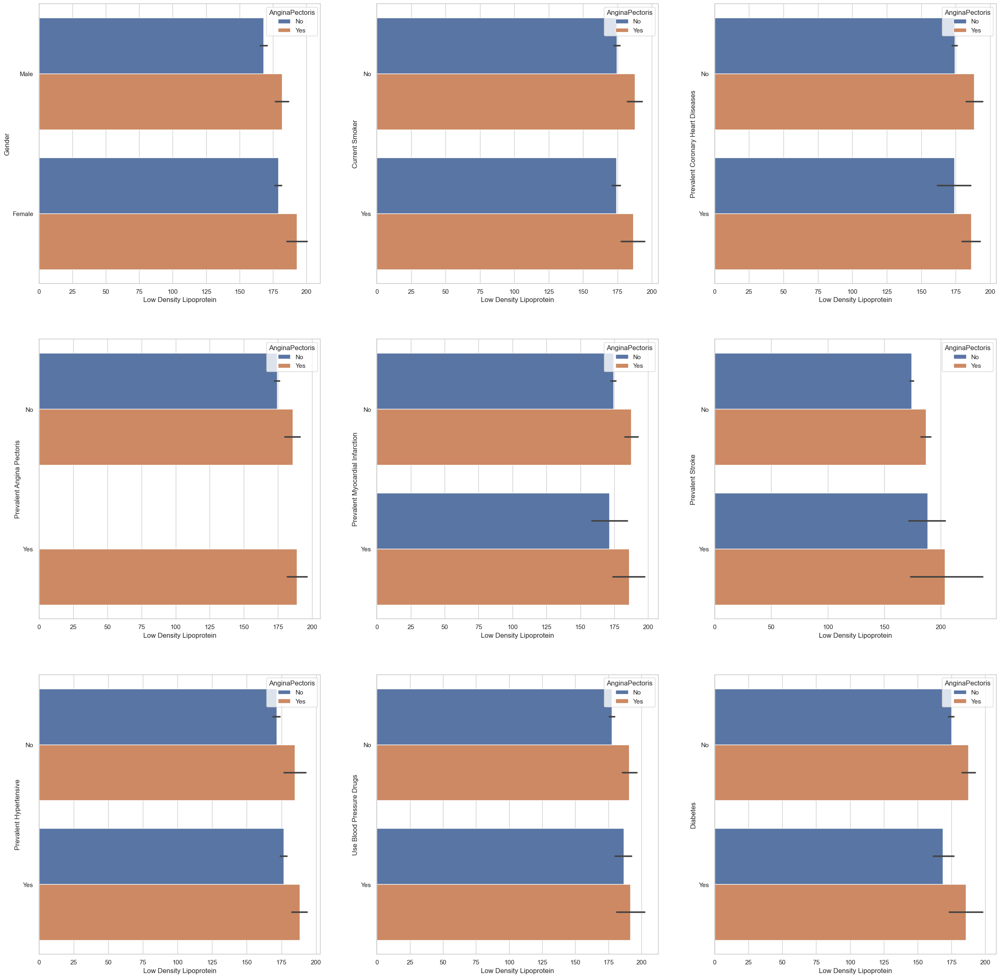

In [75]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['LowDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Low Density Lipoprotein', ylabel='Gender');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Low Density Lipoprotein', ylabel='Current Smoker');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Stroke');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['LowDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Low Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['LowDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Low Density Lipoprotein', ylabel='Diabetes');  

**K. Total Cholesterol**

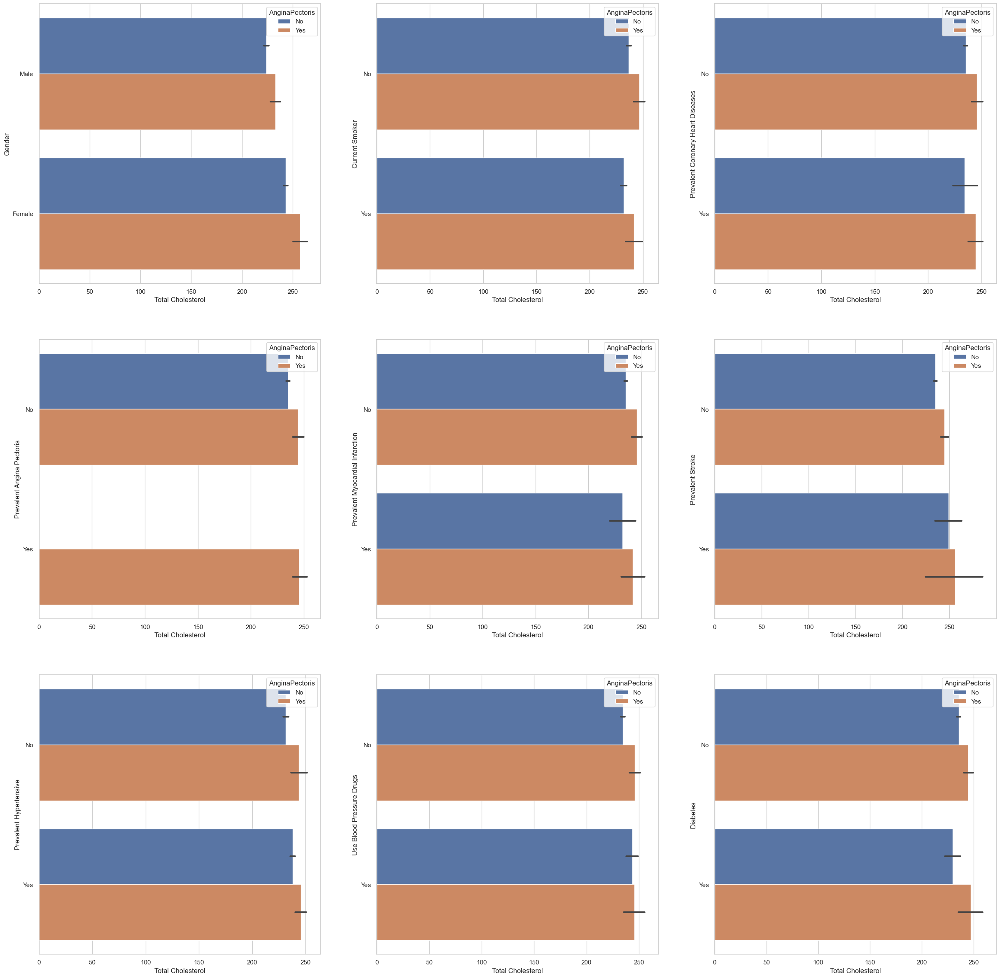

In [76]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.barplot(x = Heart['TotalCholesterol'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Total Cholesterol', ylabel='Gender');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Total Cholesterol', ylabel='Current Smoker');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Total Cholesterol', ylabel='Prevalent Coronary Heart Diseases');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Total Cholesterol', ylabel='Prevalent Angina Pectoris');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Total Cholesterol', ylabel='Prevalent Myocardial Infarction');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Total Cholesterol', ylabel='Prevalent Stroke');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Total Cholesterol', ylabel='Prevalent Hypertensive');

sns.barplot(x = Heart['TotalCholesterol'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Total Cholesterol', ylabel='Use Blood Pressure Drugs');

sns.barplot(x = Heart['TotalCholesterol'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Total Cholesterol', ylabel='Diabetes');                      

**5. Strip Plot**

**A. Age**

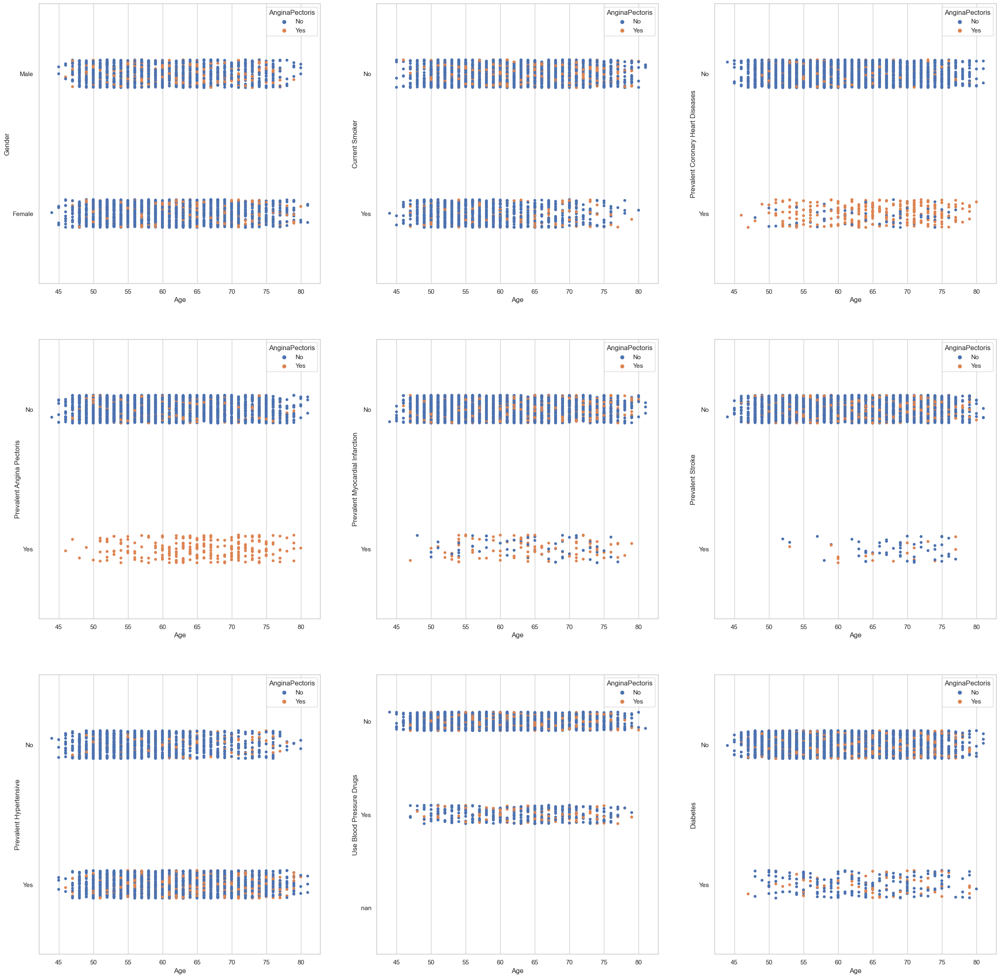

In [77]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['Age'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Age', ylabel='Gender');

sns.stripplot(x = Heart['Age'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Age', ylabel='Current Smoker');

sns.stripplot(x = Heart['Age'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Age', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['Age'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Age', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['Age'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Age', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['Age'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Age', ylabel='Prevalent Stroke');

sns.stripplot(x = Heart['Age'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Age', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['Age'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Age', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['Age'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Age', ylabel='Diabetes');

**B. Cigarettes Per Day**

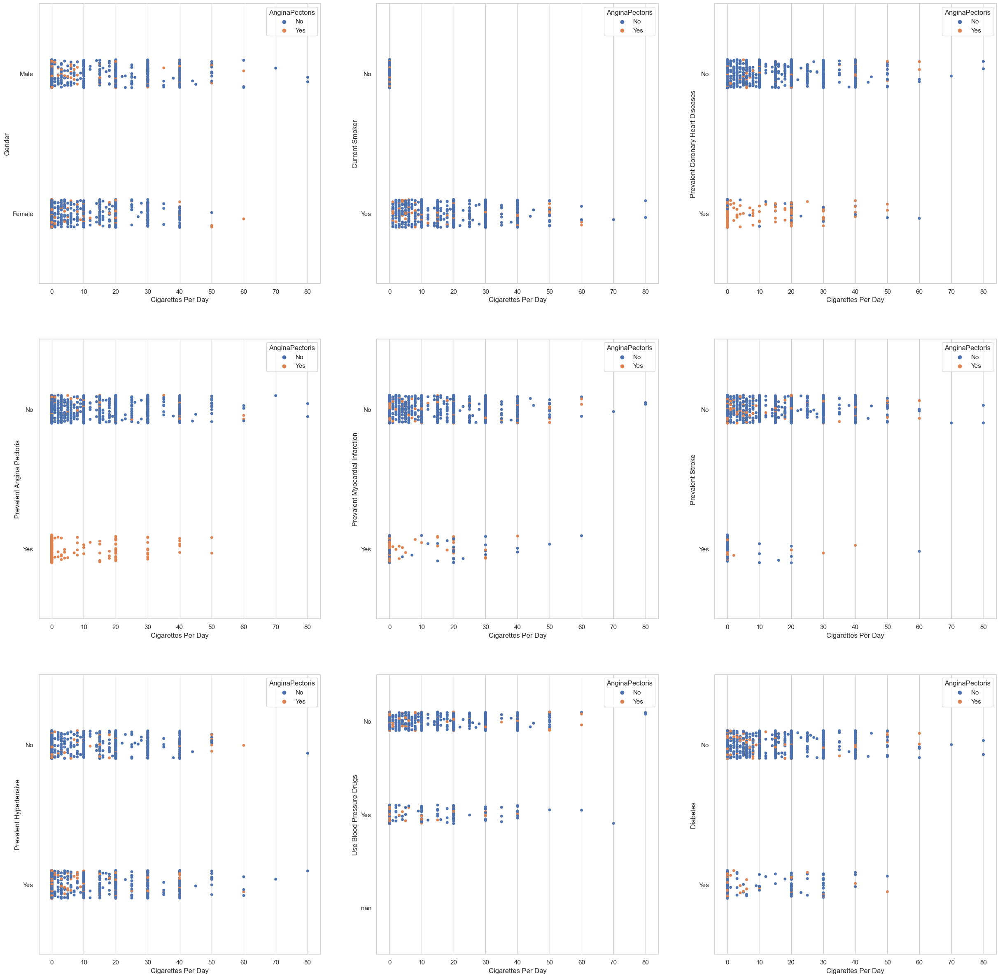

In [78]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['CigarettesPerDay'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Cigarettes Per Day', ylabel='Gender');

sns.stripplot(x = Heart['CigarettesPerDay'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Cigarettes Per Day', ylabel='Current Smoker');

sns.stripplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Stroke');

sns.stripplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['CigarettesPerDay'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Cigarettes Per Day', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['CigarettesPerDay'],  y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Cigarettes Per Day', ylabel='Diabetes');

**C. Body Mass Index**

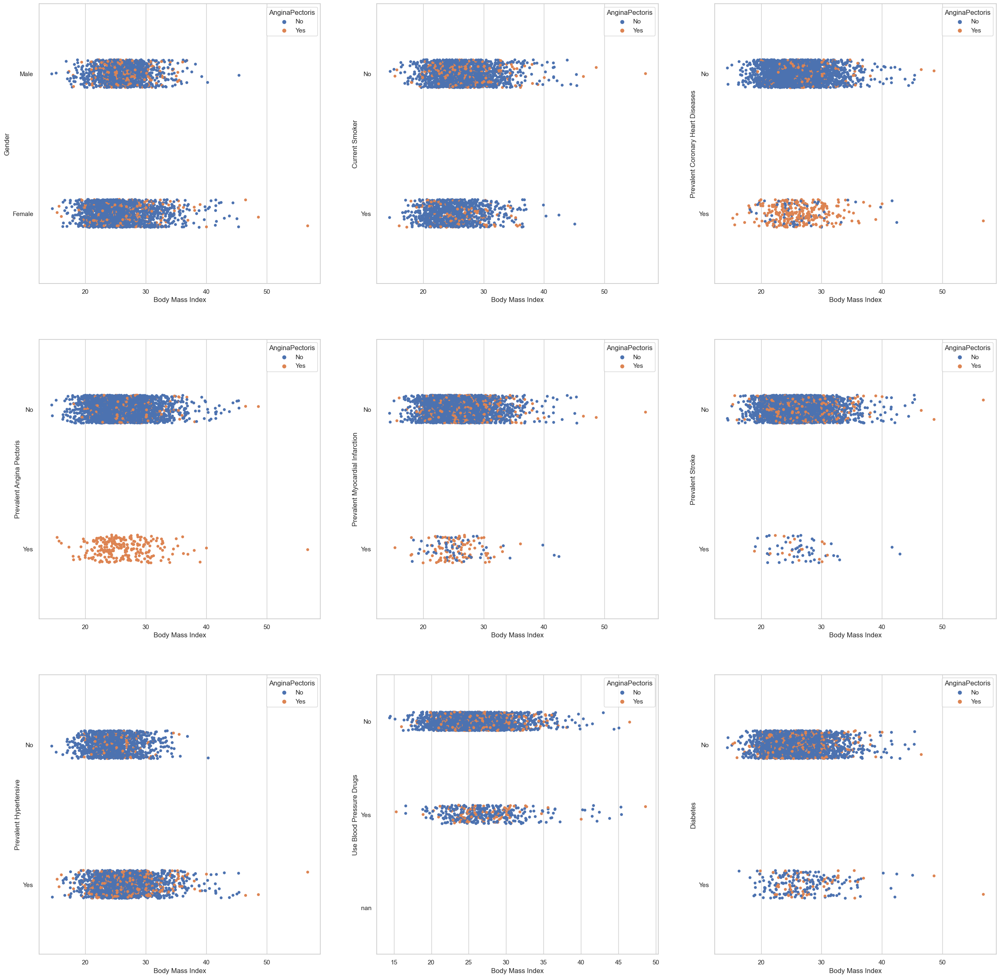

In [79]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Body Mass Index', ylabel='Gender');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Body Mass Index', ylabel='Current Smoker');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Body Mass Index', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Body Mass Index', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Body Mass Index', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Body Mass Index', ylabel='Prevalent Stroke');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Body Mass Index', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['BodyMassIndex'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Body Mass Index', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['BodyMassIndex'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Body Mass Index', ylabel='Diabetes');                    

**D. Systolic Blood Pressure**

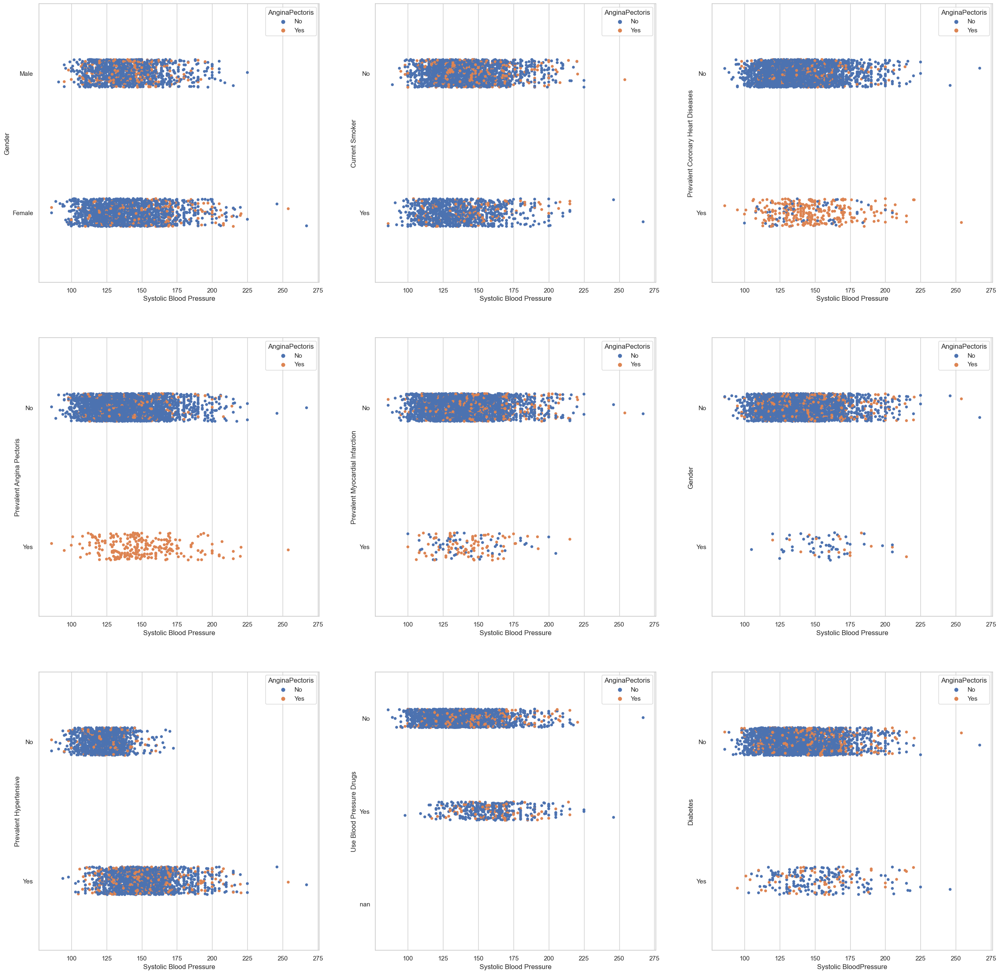

In [80]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['SystolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Systolic Blood Pressure', ylabel='Current Smoker');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['SystolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Systolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['SystolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Systolic BloodPressure', ylabel='Diabetes');                       

**E. Diastolic Blood Pressure**

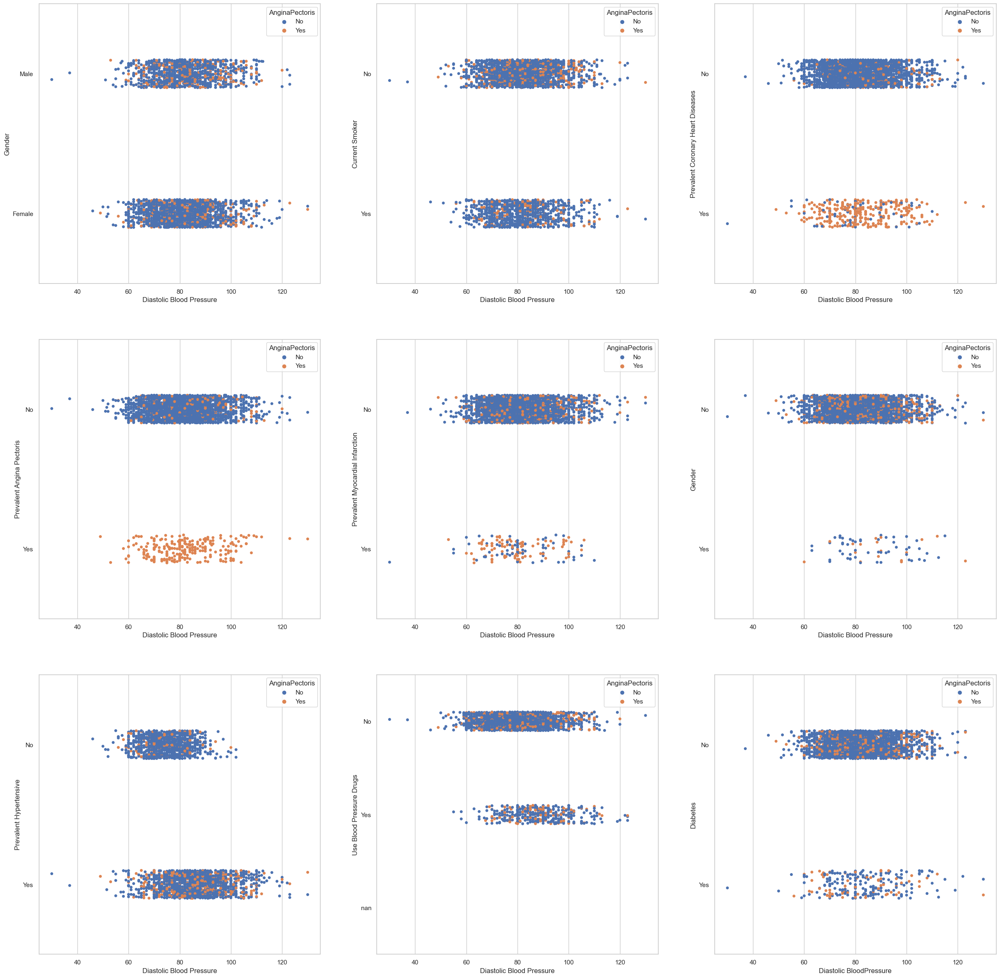

In [81]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['DiastolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Diastolic Blood Pressure', ylabel='Current Smoker');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['DiastolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Diastolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['DiastolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Diastolic BloodPressure', ylabel='Diabetes');                                          

**F. Heart Rate**

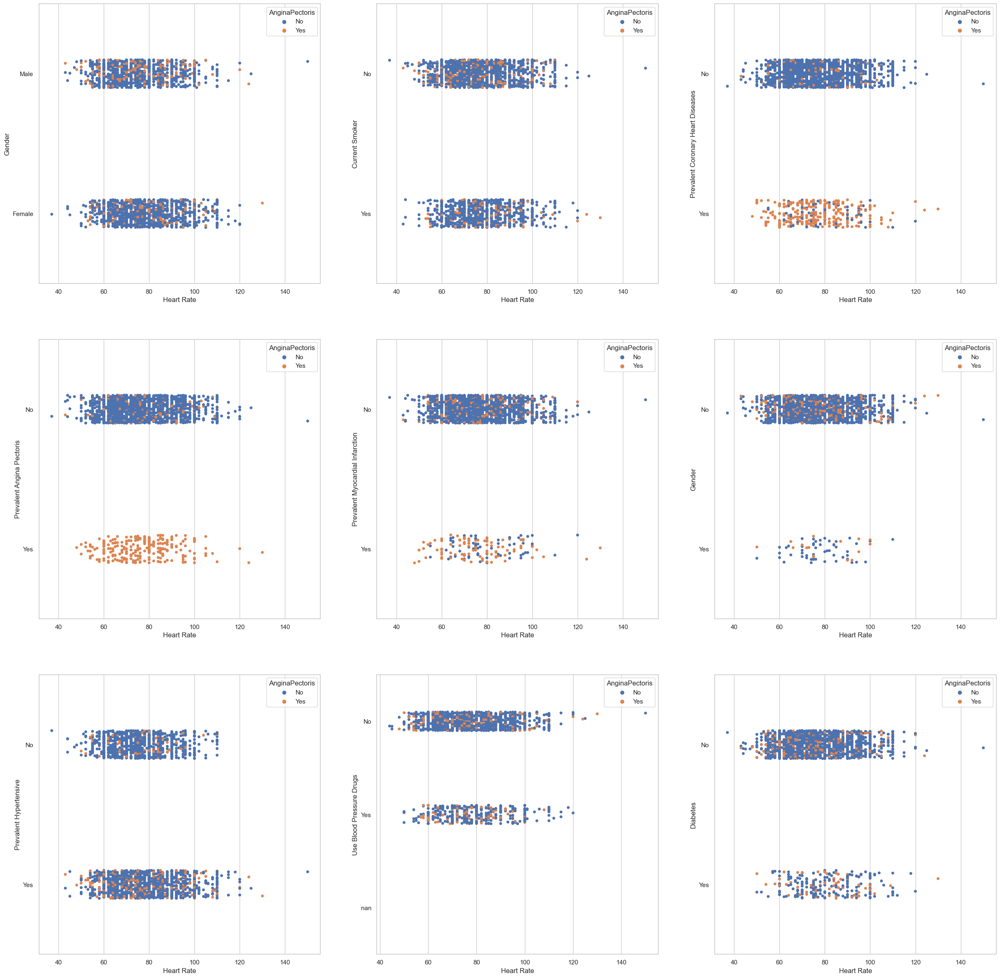

In [82]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['HeartRate'], y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Heart Rate', ylabel='Gender');

sns.stripplot(x = Heart['HeartRate'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Heart Rate', ylabel='Current Smoker');

sns.stripplot(x = Heart['HeartRate'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Heart Rate', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['HeartRate'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Heart Rate', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['HeartRate'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Heart Rate', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['HeartRate'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Heart Rate', ylabel='Gender');

sns.stripplot(x = Heart['HeartRate'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Heart Rate', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['HeartRate'], y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Heart Rate', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['HeartRate'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Heart Rate', ylabel='Diabetes');                                          

**G. Glucose**

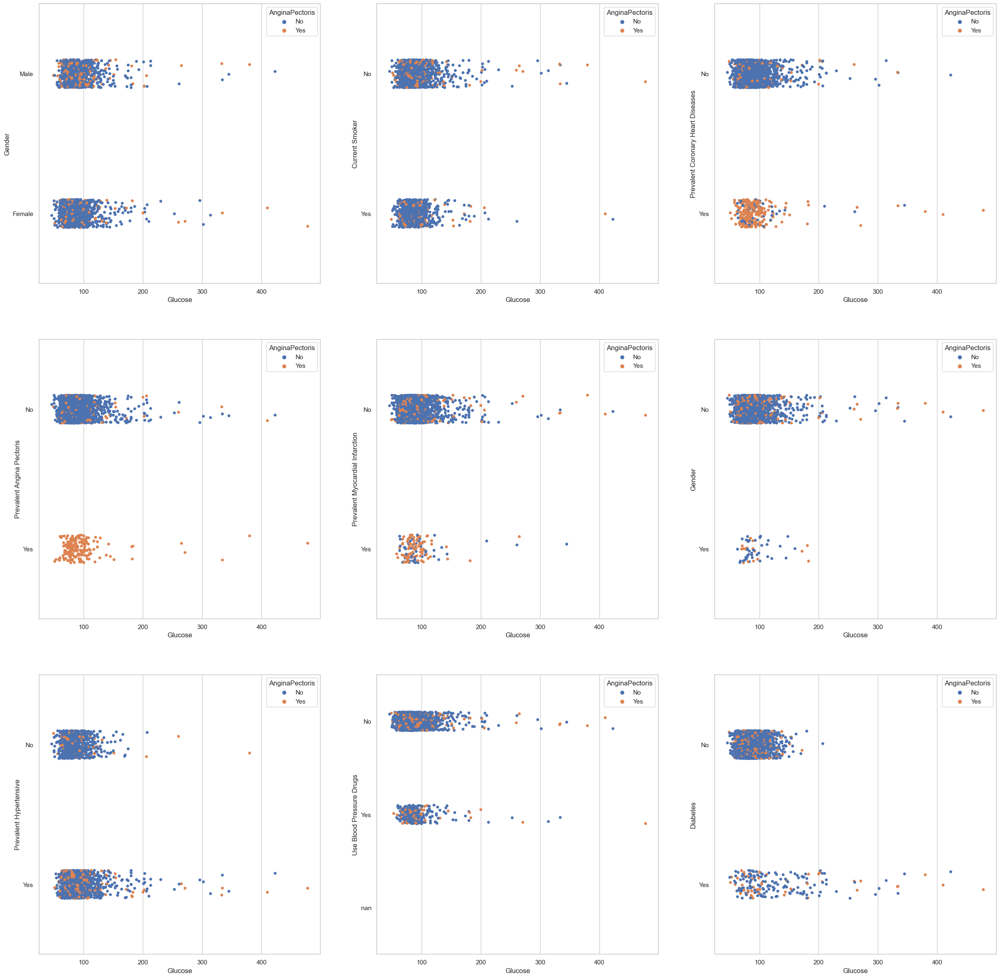

In [83]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['Glucose'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Glucose', ylabel='Gender');

sns.stripplot(x = Heart['Glucose'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Glucose', ylabel='Current Smoker');

sns.stripplot(x = Heart['Glucose'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Glucose', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['Glucose'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Glucose', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['Glucose'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Glucose', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['Glucose'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Glucose', ylabel='Gender');

sns.stripplot(x = Heart['Glucose'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Glucose', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['Glucose'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Glucose', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['Glucose'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Glucose', ylabel='Diabetes');

**H. High Density Lipoprotein**

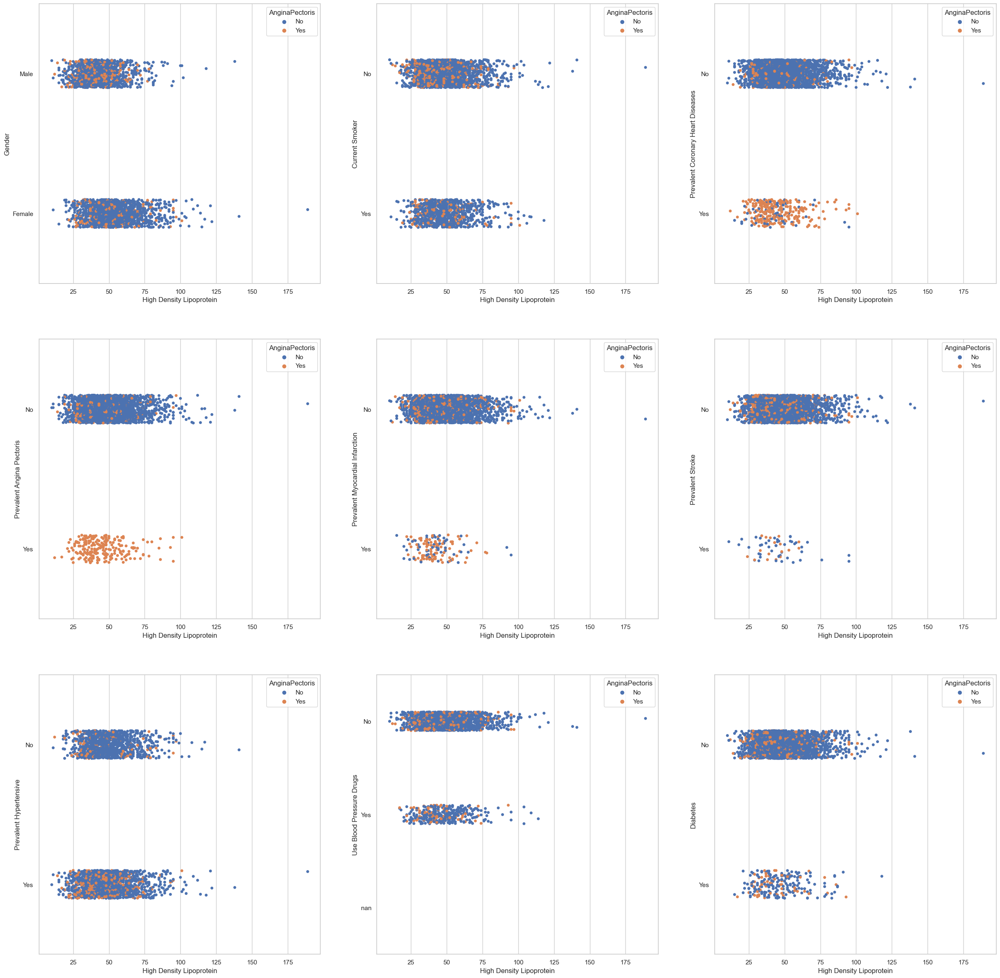

In [84]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['HighDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='High Density Lipoprotein', ylabel='Gender');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='High Density Lipoprotein', ylabel='Current Smoker');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Stroke');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['HighDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='High Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['HighDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='High Density Lipoprotein', ylabel='Diabetes'); 

**H. Low Density Lipoprotein**

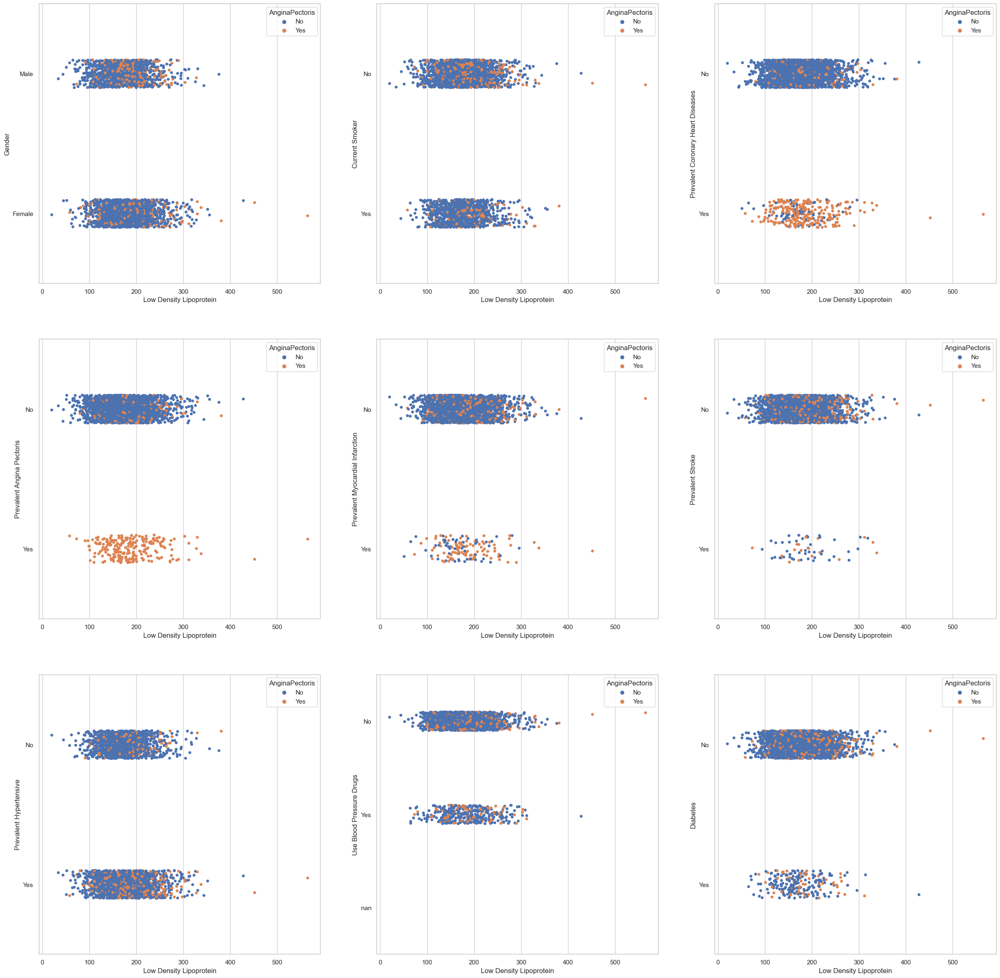

In [85]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['LowDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Low Density Lipoprotein', ylabel='Gender');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Low Density Lipoprotein', ylabel='Current Smoker');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Stroke');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['LowDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Low Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['LowDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Low Density Lipoprotein', ylabel='Diabetes');  

**K. Total Cholesterol**

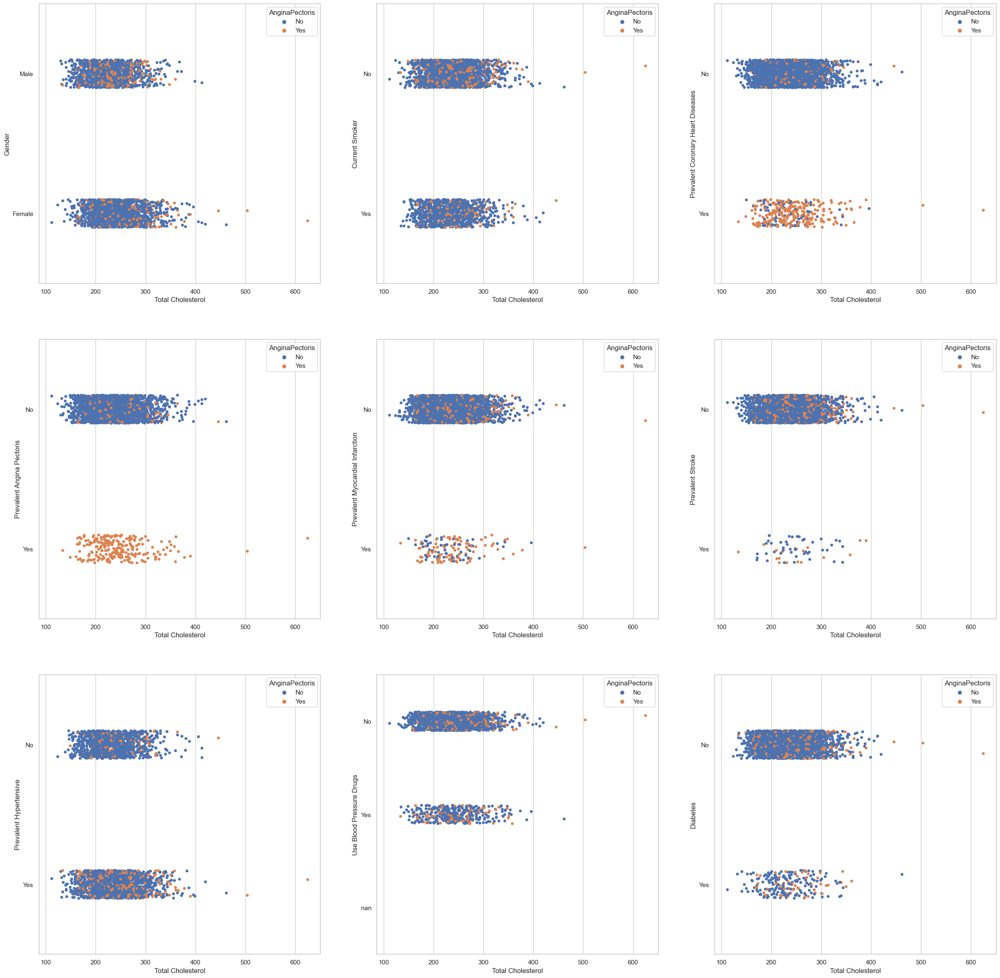

In [86]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.stripplot(x = Heart['TotalCholesterol'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Total Cholesterol', ylabel='Gender');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Total Cholesterol', ylabel='Current Smoker');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Total Cholesterol', ylabel='Prevalent Coronary Heart Diseases');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Total Cholesterol', ylabel='Prevalent Angina Pectoris');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Total Cholesterol', ylabel='Prevalent Myocardial Infarction');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Total Cholesterol', ylabel='Prevalent Stroke');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Total Cholesterol', ylabel='Prevalent Hypertensive');

sns.stripplot(x = Heart['TotalCholesterol'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Total Cholesterol', ylabel='Use Blood Pressure Drugs');

sns.stripplot(x = Heart['TotalCholesterol'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Total Cholesterol', ylabel='Diabetes');                                         

**6. Boxen Plot**

**A. Age**

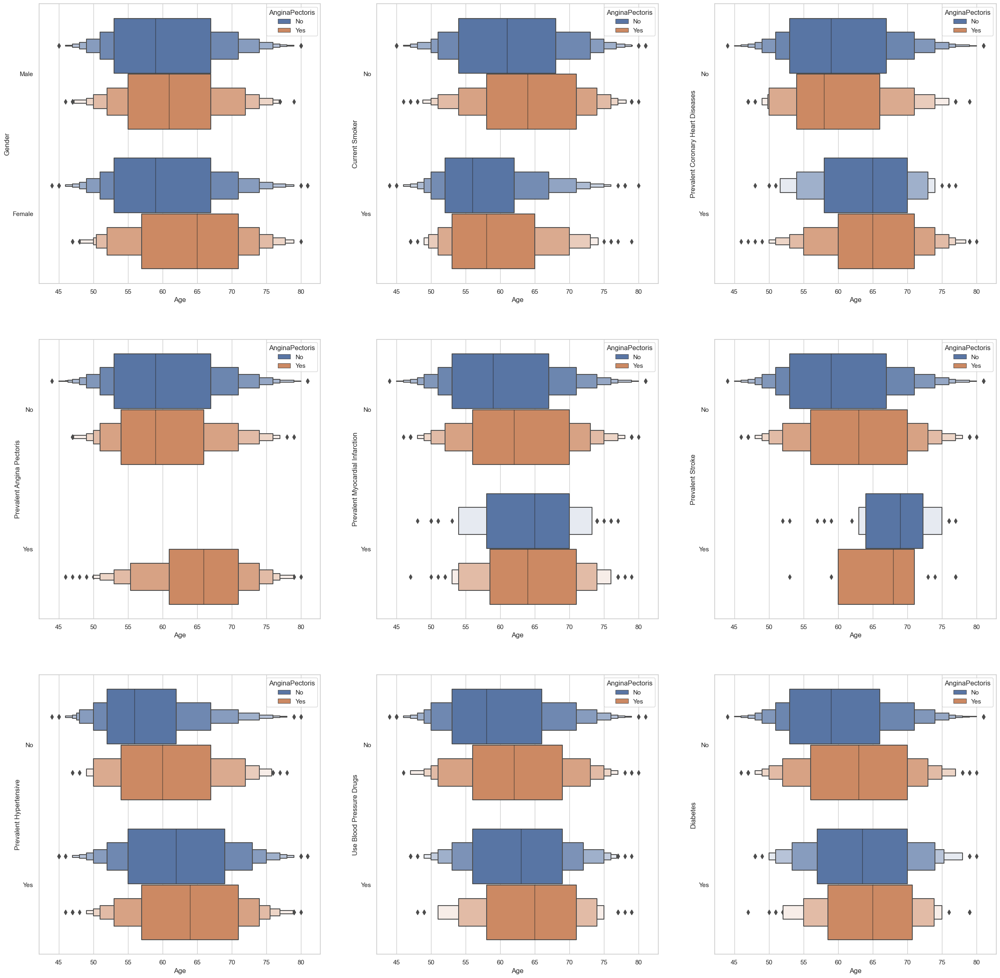

In [87]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x = Heart['Age'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Age', ylabel='Gender');

sns.boxenplot(x = Heart['Age'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Age', ylabel='Current Smoker');

sns.boxenplot(x = Heart['Age'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Age', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x = Heart['Age'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Age', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x = Heart['Age'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Age', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x = Heart['Age'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Age', ylabel='Prevalent Stroke');

sns.boxenplot(x = Heart['Age'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Age', ylabel='Prevalent Hypertensive');

sns.boxenplot(x = Heart['Age'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Age', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x = Heart['Age'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Age', ylabel='Diabetes');

**B. Cigarettes Per Day**

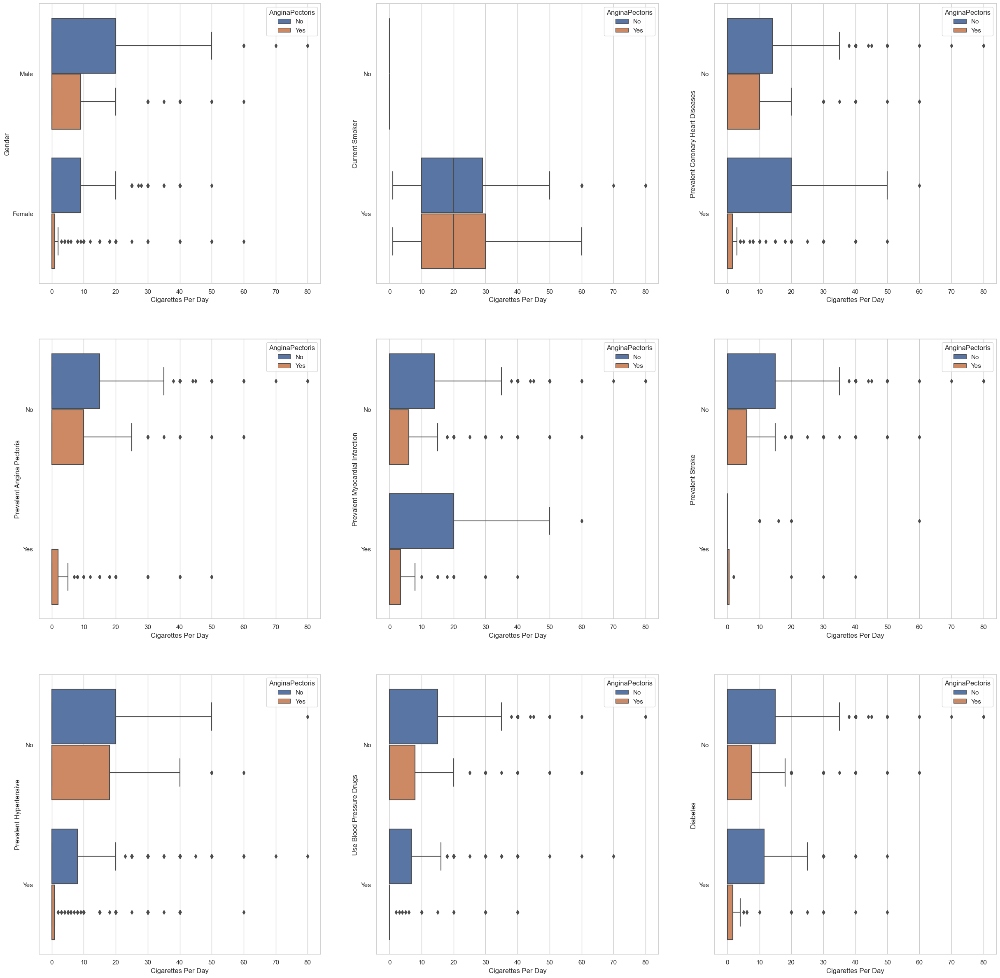

In [88]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Cigarettes Per Day', ylabel='Gender');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Cigarettes Per Day', ylabel='Current Smoker');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Coronary Heart Diseases');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Angina Pectoris');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Myocardial Infarction');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Stroke');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Cigarettes Per Day', ylabel='Prevalent Hypertensive');

sns.boxplot(x = Heart['CigarettesPerDay'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Cigarettes Per Day', ylabel='Use Blood Pressure Drugs');

sns.boxplot(x = Heart['CigarettesPerDay'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Cigarettes Per Day', ylabel='Diabetes');

**C. Body Mass Index**

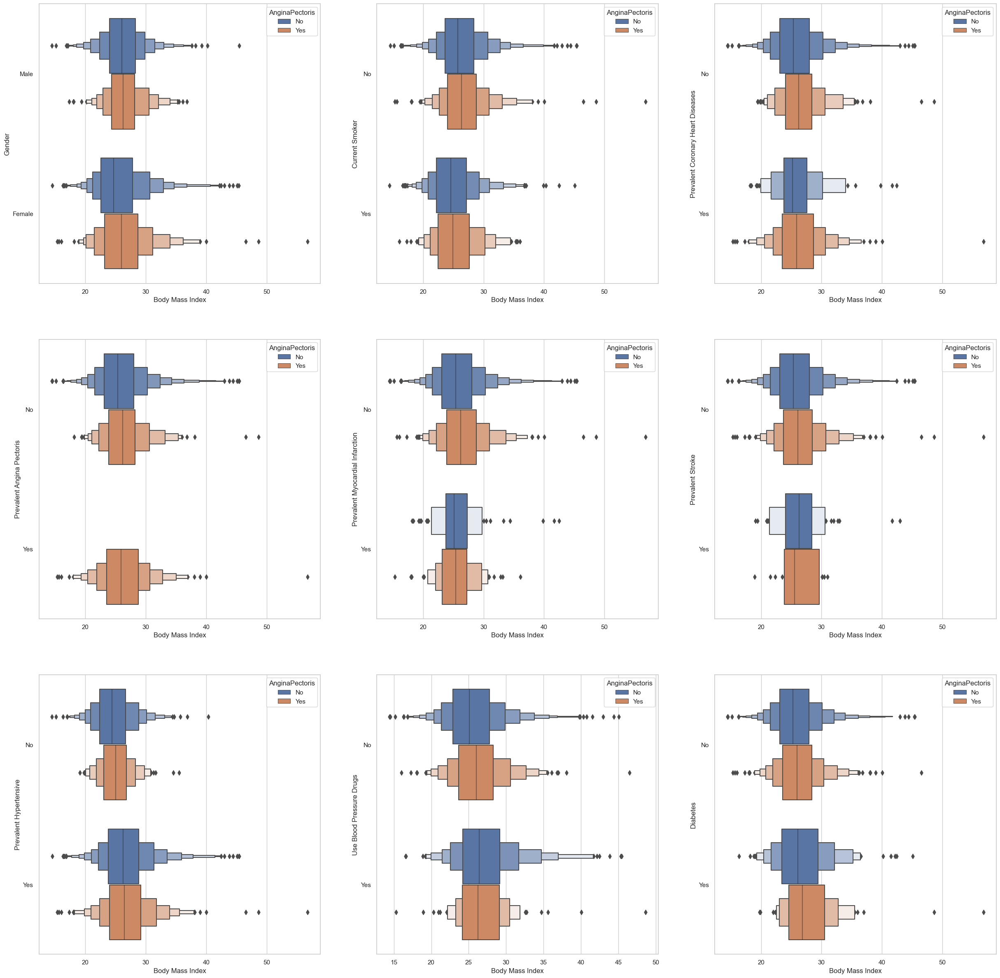

In [89]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                            figsize=(30 , 30))
sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Body Mass Index', ylabel='Gender');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Body Mass Index', ylabel='Current Smoker');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Body Mass Index', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Body Mass Index', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Body Mass Index', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Body Mass Index', ylabel='Prevalent Stroke');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Body Mass Index', ylabel='Prevalent Hypertensive');

sns.boxenplot(x = Heart['BodyMassIndex'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Body Mass Index', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x = Heart['BodyMassIndex'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Body Mass Index', ylabel='Diabetes');                     

**D. Systolic Blood Pressure**

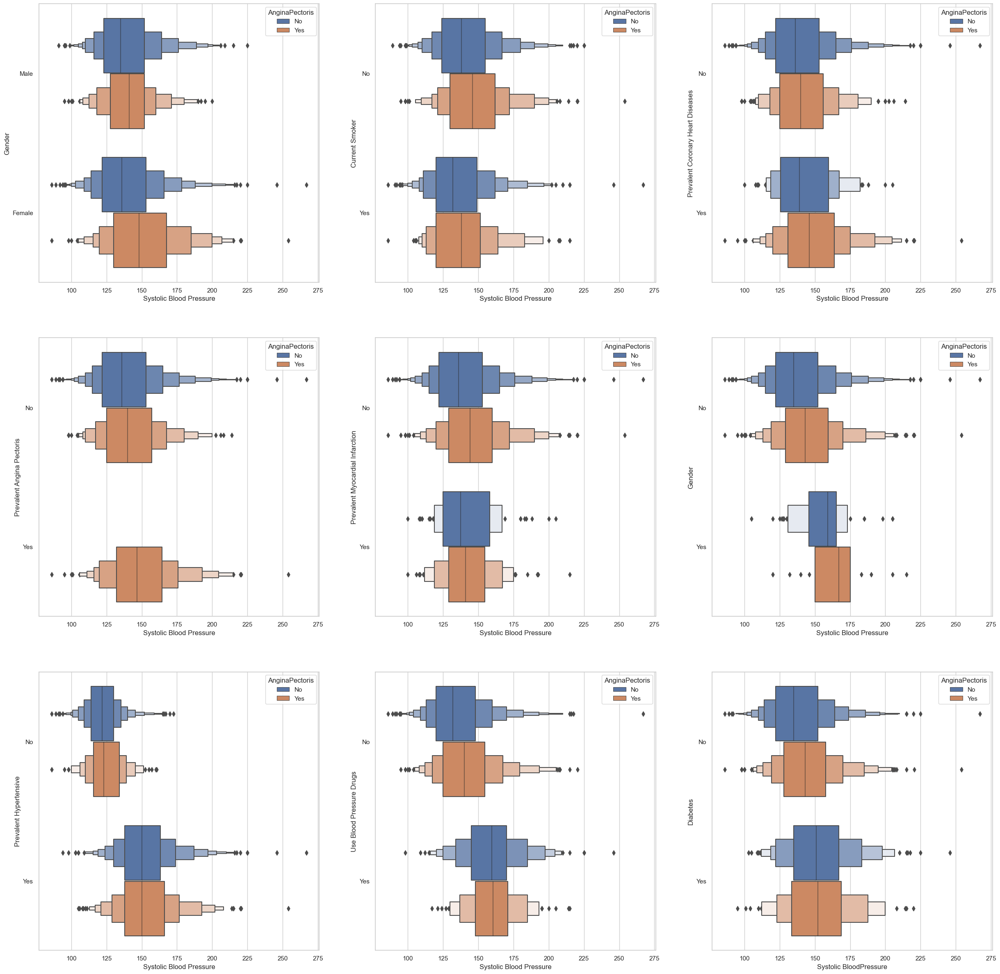

In [90]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x = Heart['SystolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Systolic Blood Pressure', ylabel='Current Smoker');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Systolic Blood Pressure', ylabel='Gender');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Systolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.boxenplot(x = Heart['SystolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Systolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x = Heart['SystolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Systolic BloodPressure', ylabel='Diabetes');                      

**E. Diastolic Blood Pressure**

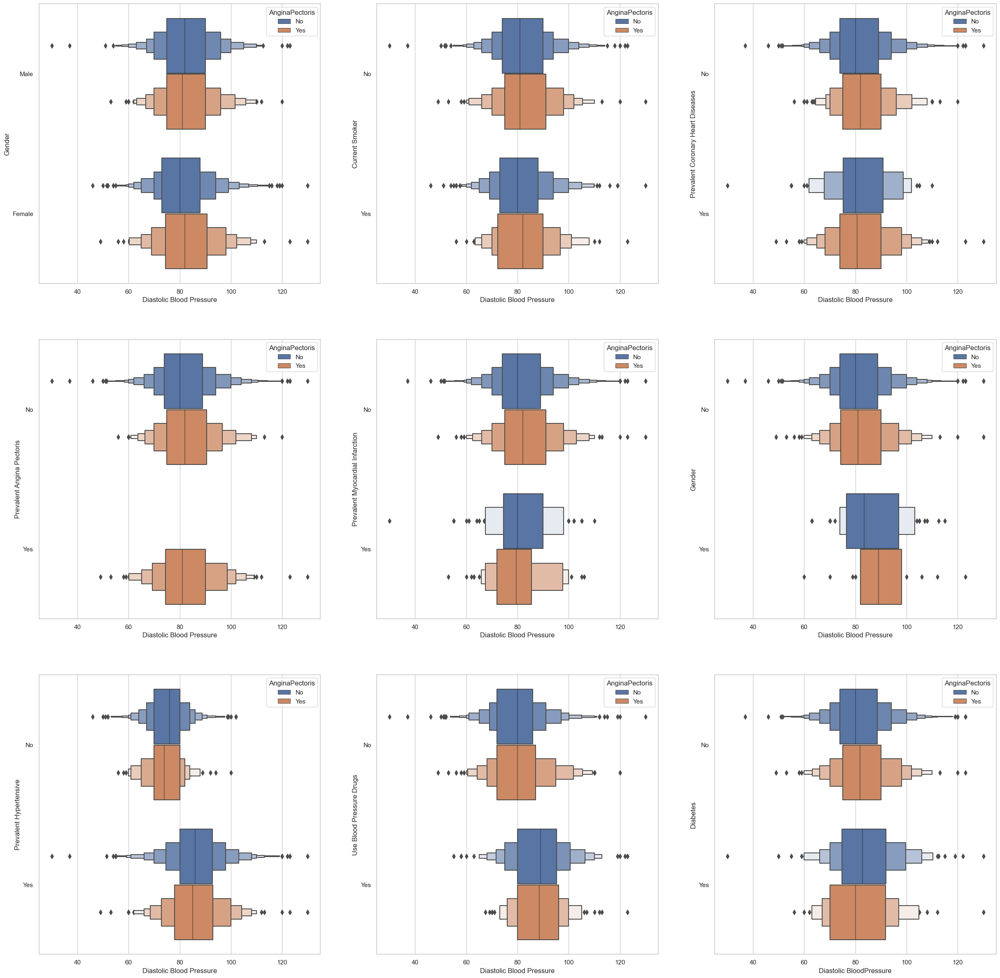

In [91]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x = Heart['DiastolicBloodPressure'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Diastolic Blood Pressure', ylabel='Current Smoker');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Diastolic Blood Pressure', ylabel='Gender');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Diastolic Blood Pressure', ylabel='Prevalent Hypertensive');

sns.boxenplot(x = Heart['DiastolicBloodPressure'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Diastolic Blood Pressure', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x = Heart['DiastolicBloodPressure'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Diastolic BloodPressure', ylabel='Diabetes');                                         

**F. Heart Rate**

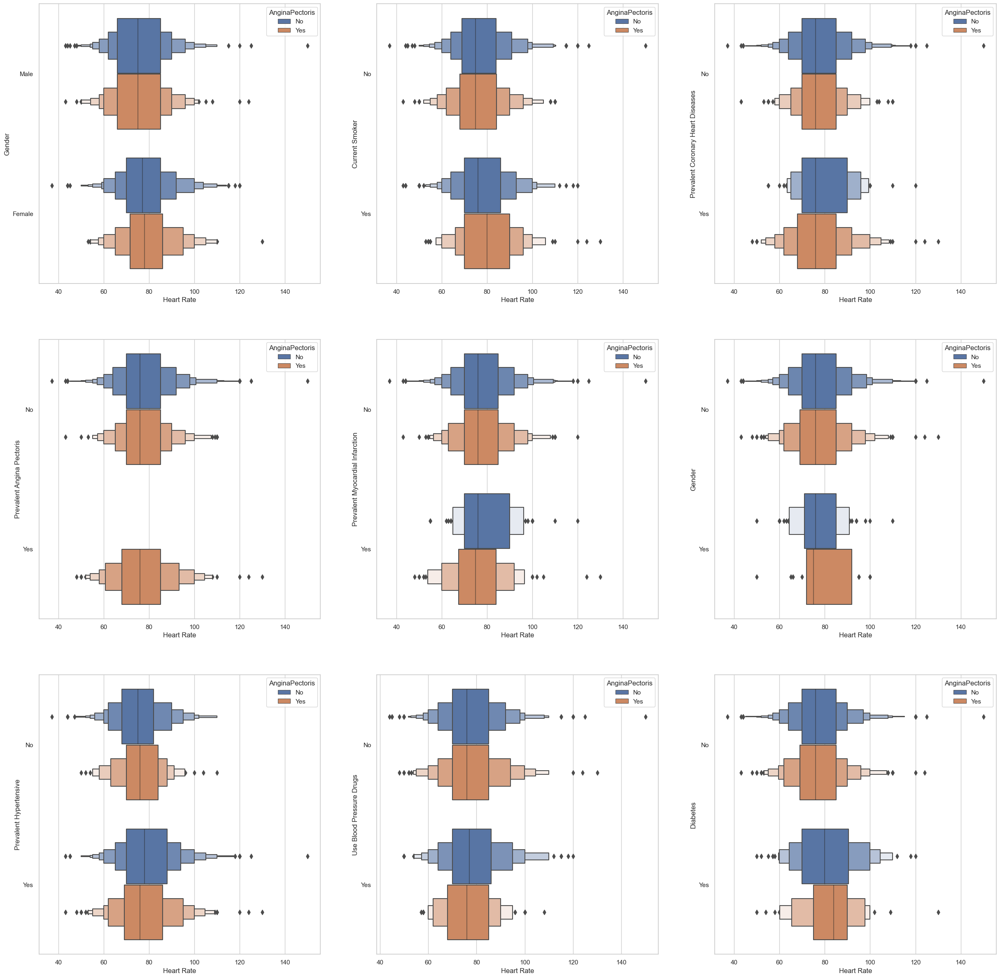

In [92]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x =Heart['HeartRate'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Heart Rate', ylabel='Gender');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Heart Rate', ylabel='Current Smoker');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Heart Rate', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Heart Rate', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Heart Rate', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Heart Rate', ylabel='Gender');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Heart Rate', ylabel='Prevalent Hypertensive');

sns.boxenplot(x =Heart['HeartRate'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Heart Rate', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x =Heart['HeartRate'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Heart Rate', ylabel='Diabetes');                                         

**G. Glucose**

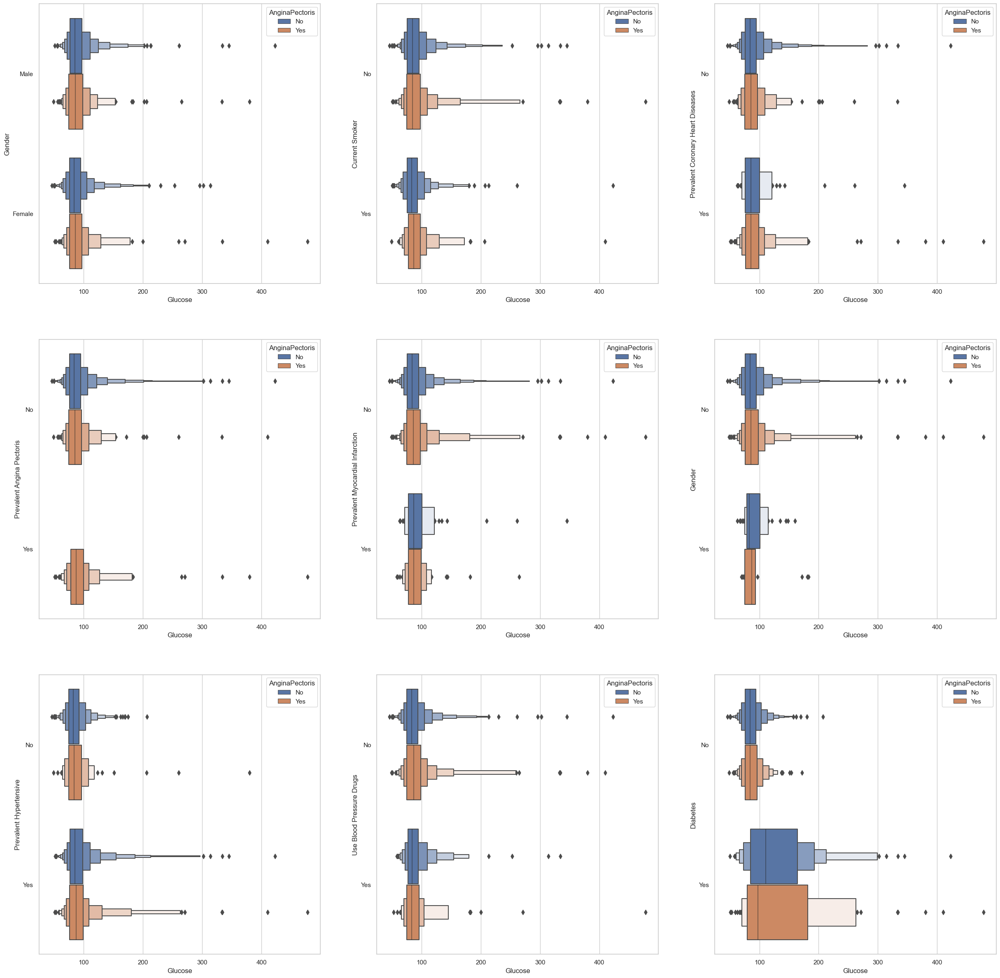

In [93]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x = Heart['Glucose'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Glucose', ylabel='Gender');

sns.boxenplot(x = Heart['Glucose'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Glucose', ylabel='Current Smoker');

sns.boxenplot(x = Heart['Glucose'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Glucose', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x = Heart['Glucose'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Glucose', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x = Heart['Glucose'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Glucose', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x = Heart['Glucose'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Glucose', ylabel='Gender');

sns.boxenplot(x = Heart['Glucose'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Glucose', ylabel='Prevalent Hypertensive');

sns.boxenplot(x = Heart['Glucose'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Glucose', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x = Heart['Glucose'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Glucose', ylabel='Diabetes'); 

**H. High Density Lipoprotein**

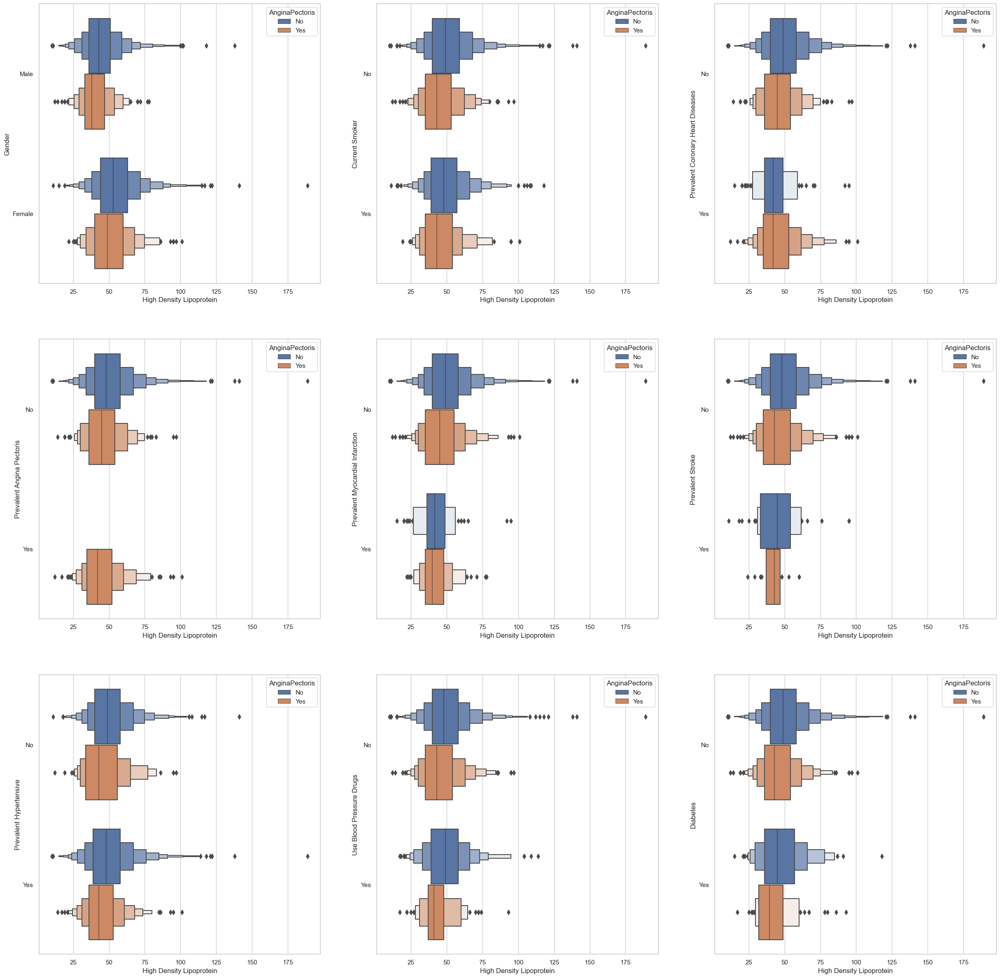

In [94]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x = Heart['HighDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='High Density Lipoprotein', ylabel='Gender');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='High Density Lipoprotein', ylabel='Current Smoker');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Stroke');

sns.boxenplot(x = Heart['HighDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='High Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.boxenplot(x =Heart['HighDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='High Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x =Heart['HighDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='High Density Lipoprotein', ylabel='Diabetes'); 

**J. Low Density Lipoprotein**

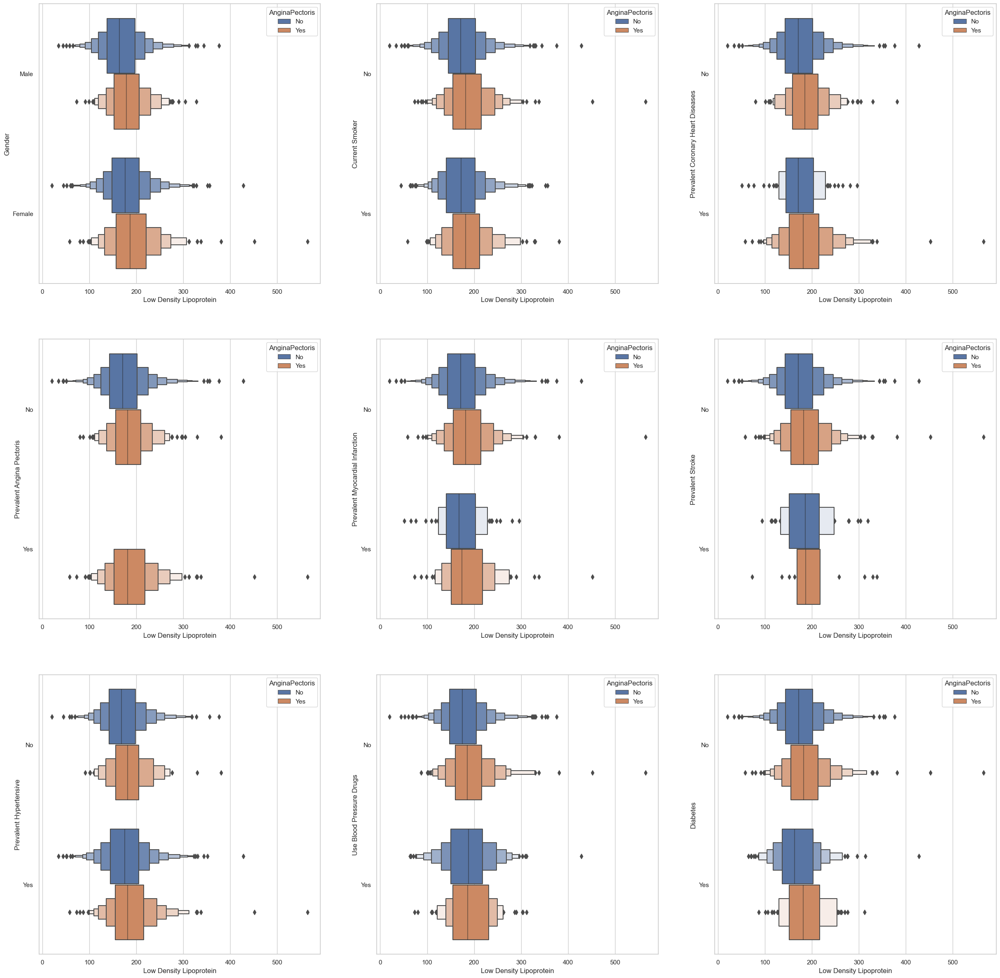

In [95]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x =Heart['LowDensityLipoprotein'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Low Density Lipoprotein', ylabel='Gender');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Low Density Lipoprotein', ylabel='Current Smoker');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Stroke');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Low Density Lipoprotein', ylabel='Prevalent Hypertensive');

sns.boxenplot(x =Heart['LowDensityLipoprotein'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Low Density Lipoprotein', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x =Heart['LowDensityLipoprotein'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Low Density Lipoprotein', ylabel='Diabetes'); 

**K. Total Cholesterol**

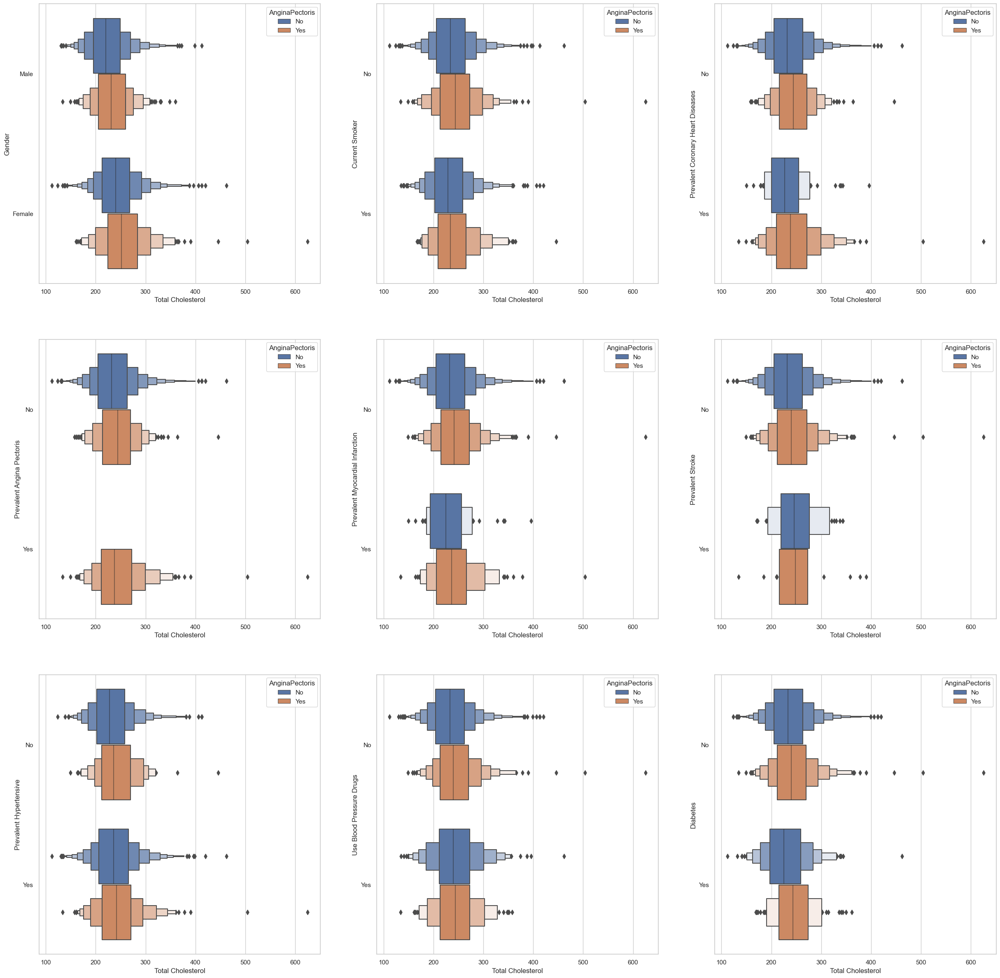

In [96]:
Fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9)) = plt.subplots(nrows=3,
                                            ncols=3,
                                           figsize=(30 , 30))
sns.boxenplot(x =Heart['TotalCholesterol'],y = Heart['Gender'],                          ax=ax1 , hue=Heart['AnginaPectoris']);
ax1.set(xlabel='Total Cholesterol', ylabel='Gender');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['CurrentSmoker'],                   ax=ax2,  hue=Heart['AnginaPectoris']);
ax2.set(xlabel='Total Cholesterol', ylabel='Current Smoker');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentCoronaryHeartDiseases'],  ax=ax3,  hue=Heart['AnginaPectoris']);
ax3.set(xlabel='Total Cholesterol', ylabel='Prevalent Coronary Heart Diseases');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentAnginaPectoris'],         ax=ax4,  hue=Heart['AnginaPectoris']);
ax4.set(xlabel='Total Cholesterol', ylabel='Prevalent Angina Pectoris');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentMyocardialInfarction'],   ax=ax5,  hue=Heart['AnginaPectoris']);
ax5.set(xlabel='Total Cholesterol', ylabel='Prevalent Myocardial Infarction');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentStroke'] ,                ax=ax6,  hue=Heart['AnginaPectoris']);
ax6.set(xlabel='Total Cholesterol', ylabel='Prevalent Stroke');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['PrevalentHypertensive'],           ax=ax7,  hue=Heart['AnginaPectoris']);
ax7.set(xlabel='Total Cholesterol', ylabel='Prevalent Hypertensive');

sns.boxenplot(x =Heart['TotalCholesterol'],y =  Heart['UseBloodPressureDrugs'],           ax=ax8,  hue=Heart['AnginaPectoris']);
ax8.set(xlabel='Total Cholesterol', ylabel='Use Blood Pressure Drugs');

sns.boxenplot(x =Heart['TotalCholesterol'], y = Heart['Diabetes'],                        ax=ax9,  hue=Heart['AnginaPectoris']);
ax9.set(xlabel='Total Cholesterol', ylabel='Diabetes');                      

# Missing Values Statistics 1

In [97]:
MissingValues = Heart.isnull().sum().T
MissingValues

Gender                              0
Age                                 0
CurrentSmoker                       0
CigarettesPerDay                   14
BodyMassIndex                      17
PrevalentCoronaryHeartDiseases      0
PrevalentAnginaPectoris             0
PrevalentMyocardialInfarction       0
PrevalentStroke                     0
PrevalentHypertensive               0
UseBloodPressureDrugs             446
Diabetes                            0
SystolicBloodPressure               0
DiastolicBloodPressure              0
HeartRate                           4
Glucose                           562
HighDensityLipoprotein            236
LowDensityLipoprotein             237
TotalCholesterol                  214
AnginaPectoris                      0
MyocardialInfarction                0
dtype: int64

# Encoding Categorical Values

**1. Label Encoder**

In [98]:
LabelEncoder = LabelEncoder()
Heart['Gender'] = LabelEncoder.fit_transform(Heart['Gender'])
Heart['CurrentSmoker'] = LabelEncoder.fit_transform(Heart['CurrentSmoker'])
Heart['PrevalentCoronaryHeartDiseases'] = LabelEncoder.fit_transform(Heart['PrevalentCoronaryHeartDiseases'])
Heart['PrevalentAnginaPectoris'] = LabelEncoder.fit_transform(Heart['PrevalentAnginaPectoris'])
Heart['PrevalentMyocardialInfarction'] = LabelEncoder.fit_transform(Heart['PrevalentMyocardialInfarction'])
Heart['PrevalentStroke'] = LabelEncoder.fit_transform(Heart['PrevalentStroke'])
Heart['PrevalentHypertensive'] = LabelEncoder.fit_transform(Heart['PrevalentHypertensive'])
Heart['UseBloodPressureDrugs'] = LabelEncoder.fit_transform(Heart['UseBloodPressureDrugs'])
Heart['Diabetes'] = LabelEncoder.fit_transform(Heart['Diabetes'])
Heart

,Gender,Age,CurrentSmoker,CigarettesPerDay,BodyMassIndex,PrevalentCoronaryHeartDiseases,PrevalentAnginaPectoris,PrevalentMyocardialInfarction,PrevalentStroke,PrevalentHypertensive,...,Diabetes,SystolicBloodPressure,DiastolicBloodPressure,HeartRate,Glucose,HighDensityLipoprotein,LowDensityLipoprotein,TotalCholesterol,AnginaPectoris,MyocardialInfarction
0,1,52,0,0.0,NaN,0,0,0,0,0,...,0,121.0,66.0,69.0,92.0,31.0,178.0,209.0,No,Yes
1,0,58,0,0.0,28.50,0,0,0,0,0,...,0,108.0,66.0,80.0,71.0,54.0,141.0,237.0,No,No
2,0,58,1,30.0,24.61,0,0,0,0,1,...,0,155.0,90.0,74.0,NaN,NaN,NaN,NaN,No,No
3,0,55,0,0.0,31.17,0,0,0,0,1,...,1,180.0,106.0,86.0,81.0,46.0,135.0,220.0,No,No
4,0,57,1,30.0,22.02,0,0,0,0,0,...,0,110.0,46.0,75.0,87.0,34.0,286.0,320.0,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3258,1,63,1,50.0,17.38,0,0,0,0,0,...,0,120.0,80.0,76.0,NaN,NaN,NaN,NaN,No,No
3259,0,60,1,20.0,22.37,0,0,0,0,1,...,0,205.0,100.0,80.0,91.0,47.0,181.0,228.0,No,No
3260,0,56,1,35.0,21.97,0,0,0,0,1,...,0,145.0,92.0,95.0,90.0,70.0,181.0,251.0,No,No
3261,1,52,0,0.0,25.74,0,0,0,0,1,...,0,143.0,89.0,65.0,72.0,30.0,123.0,153.0,No,No


**2. One Hot Encoding**

In [99]:
# Heart = pd.get_dummies(Heart, columns=['Gender', 'CurrentSmoker', 'PrevalentCoronaryHeartDiseases',
#                                           'PrevalentAnginaPectoris', 'PrevalentMyocardialInfarction',
#                                          'PrevalentStroke', 'PrevalentHypertensive', 
#                                           'UseBloodPressureDrugs', 'Diabetes'], dummy_na=False)
# Heart

# Dealing With Missing Values

**1. Simple Imputer**

**A. Numerical Features**

In [100]:
Impute = SimpleImputer(missing_values=np.nan, strategy='mean')
Heart['CigarettesPerDay'] = Impute.fit_transform(np.array(Heart['CigarettesPerDay']).reshape(-1, 1))
Heart['BodyMassIndex'] = Impute.fit_transform(np.array(Heart['BodyMassIndex']).reshape(-1, 1))
Heart['HeartRate'] = Impute.fit_transform(np.array(Heart['HeartRate']).reshape(-1, 1))
Heart['Glucose'] = Impute.fit_transform(np.array(Heart['Glucose']).reshape(-1, 1))
Heart['HighDensityLipoprotein'] = Impute.fit_transform(np.array(Heart['HighDensityLipoprotein']).reshape(-1, 1))
Heart['LowDensityLipoprotein'] = Impute.fit_transform(np.array(Heart['LowDensityLipoprotein']).reshape(-1, 1))
Heart['TotalCholesterol'] = Impute.fit_transform(np.array(Heart['TotalCholesterol']).reshape(-1, 1))

**B. Categeorical Features**

In [101]:
Impute2 = SimpleImputer(missing_values=np.nan, strategy='most_frequent')
Heart[['UseBloodPressureDrugs']] = Impute2.fit_transform(Heart[['UseBloodPressureDrugs']])

**2. Knn Impute**

In [102]:
# KnnImpute = KNNImputer(n_neighbors=1)
# Heart['CigarettesPerDay'] = KnnImpute.fit_transform(np.array(Heart['CigarettesPerDay']).reshape(-1, 1))
# Heart['BodyMassIndex'] = KnnImpute.fit_transform(np.array(Heart['BodyMassIndex']).reshape(-1, 1))
# Heart['HeartRate'] = KnnImpute.fit_transform(np.array(Heart['HeartRate']).reshape(-1, 1))
# Heart['Glucose'] = KnnImpute.fit_transform(np.array(Heart['Glucose']).reshape(-1, 1))
# Heart['HighDensityLipoprotein'] = KnnImpute.fit_transform(np.array(Heart['HighDensityLipoprotein']).reshape(-1, 1))
# Heart['LowDensityLipoprotein'] = KnnImpute.fit_transform(np.array(Heart['LowDensityLipoprotein']).reshape(-1, 1))
# Heart['TotalCholesterol'] = KnnImpute.fit_transform(np.array(Heart['TotalCholesterol']).reshape(-1, 1))
# Heart[['UseBloodPressureDrugs']] = KnnImpute.fit_transform(Heart[['UseBloodPressureDrugs']])

# Missing Values Statistics 2

In [103]:
MissingValues2 = Heart.isnull().sum().T
MissingValues2

Gender                            0
Age                               0
CurrentSmoker                     0
CigarettesPerDay                  0
BodyMassIndex                     0
PrevalentCoronaryHeartDiseases    0
PrevalentAnginaPectoris           0
PrevalentMyocardialInfarction     0
PrevalentStroke                   0
PrevalentHypertensive             0
UseBloodPressureDrugs             0
Diabetes                          0
SystolicBloodPressure             0
DiastolicBloodPressure            0
HeartRate                         0
Glucose                           0
HighDensityLipoprotein            0
LowDensityLipoprotein             0
TotalCholesterol                  0
AnginaPectoris                    0
MyocardialInfarction              0
dtype: int64

# Normalization 

In [104]:
Norm = MinMaxScaler(feature_range=(0, 1))
Heart['Age']= Norm.fit_transform(np.array(Heart['Age']).reshape(-1,1))
Heart['BodyMassIndex']= Norm.fit_transform(np.array(Heart['BodyMassIndex']).reshape(-1,1))
Heart['Glucose']= Norm.fit_transform(np.array(Heart['Glucose']).reshape(-1,1))
Heart['CigarettesPerDay']= Norm.fit_transform(np.array(Heart['CigarettesPerDay']).reshape(-1,1))
Heart['BodyMassIndex']= Norm.fit_transform(np.array(Heart['BodyMassIndex']).reshape(-1,1))
Heart['SystolicBloodPressure']= Norm.fit_transform(np.array(Heart['SystolicBloodPressure']).reshape(-1,1))
Heart['DiastolicBloodPressure']= Norm.fit_transform(np.array(Heart['DiastolicBloodPressure']).reshape(-1,1))
Heart['HeartRate']= Norm.fit_transform(np.array(Heart['HeartRate']).reshape(-1,1))
Heart['HighDensityLipoprotein']= Norm.fit_transform(np.array(Heart['HighDensityLipoprotein']).reshape(-1,1))
Heart['LowDensityLipoprotein']= Norm.fit_transform(np.array(Heart['LowDensityLipoprotein']).reshape(-1,1))
Heart['TotalCholesterol']= Norm.fit_transform(np.array(Heart['TotalCholesterol']).reshape(-1,1))# # 

# Standardization


In [105]:
# Stand = StandardScaler()
# Heart['Age']= Stand.fit_transform(np.array(Heart['Age']).reshape(-1,1))
# Heart['BodyMassIndex']= Stand.fit_transform(np.array(Heart['BodyMassIndex']).reshape(-1,1))
# Heart['Glucose']= Stand.fit_transform(np.array(Heart['Glucose']).reshape(-1,1))
# Heart['CigarettesPerDay']= Stand.fit_transform(np.array(Heart['CigarettesPerDay']).reshape(-1,1))
# Heart['BodyMassIndex']= Stand.fit_transform(np.array(Heart['BodyMassIndex']).reshape(-1,1))
# Heart['SystolicBloodPressure']= Stand.fit_transform(np.array(Heart['SystolicBloodPressure']).reshape(-1,1))
# Heart['DiastolicBloodPressure']= Stand.fit_transform(np.array(Heart['DiastolicBloodPressure']).reshape(-1,1))
# Heart['HeartRate']= Stand.fit_transform(np.array(Heart['HeartRate']).reshape(-1,1))
# Heart['HighDensityLipoprotein']= Stand.fit_transform(np.array(Heart['HighDensityLipoprotein']).reshape(-1,1))
# Heart['LowDensityLipoprotein']= Stand.fit_transform(np.array(Heart['LowDensityLipoprotein']).reshape(-1,1))
# Heart['TotalCholesterol']= Stand.fit_transform(np.array(Heart['TotalCholesterol']).reshape(-1,1))

# Heart 

# Split The DataSet Into Independent Variables (X) And Dependent Variable (Y)

In [106]:
X = Heart.drop(["AnginaPectoris", 'MyocardialInfarction'], inplace=False, axis=1)
y = Heart['AnginaPectoris']

# Machine Learnig Algorithms

In [107]:
kf = StratifiedKFold(n_splits=10)

**1 - Decision Tree**


The Best Decision Tree Parameters Are: {'criterion': 'gini', 'max_depth': 5}

Acuraccy Score Of Decision Tree Is : 91.3575730286486

Recall Score Of Decision Tree Is : 74.97671021307572

Precision Score Of Decision Tree Is : 91.93364376976882

F1 Score Of Decision Tree Is : 80.22553161043146


 Confusion Matrix Of Decision Tree Is:
  [[2713   22]
 [ 260  268]]
 


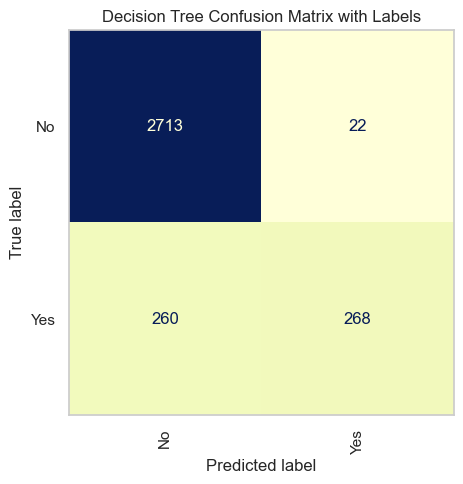

In [108]:
confusionmatrixDT = []
accuracyDT = []
recallDT = []
precisionDT = []
f1DT = []

for train_index, test_index in kf.split(X,y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    DTParam = {
                    'criterion': ['entropy', 'gini', 'log_loss'],
                    'max_depth':[ 5, 6, 7, 8, 9, 10],     
              }
 
    DTGrid = GridSearchCV(estimator=DecisionTreeClassifier(random_state = 0), 
                                param_grid=DTParam,
                                scoring='accuracy',
                                cv=5,
                                refit = True,
                                verbose = -1,
                                return_train_score = True,
                                )

    # Fit The Decision Tree
    DTGrid.fit(X_train, y_train)
    y_pred = DTGrid.predict(X_test)

     # Confusion Matrix Of Decision Tree
    confusionmatrixDT.append(confusion_matrix(y_test, y_pred))
    Confusion_MatrixDT = np.array(confusionmatrixDT)

    # Accuracy Of Decision Tree
    accuracyDT.append(accuracy_score(y_test, y_pred))
    AccurcayDT = DataFrame(accuracyDT, columns=['Accuracy'])

     # Recall Of Decision Tree
    recallDT.append(recall_score(y_test, y_pred, average='macro'))
    RecallDT = DataFrame(recallDT, columns=['Recall'])

     # Precision Of Decision Tree
    precisionDT.append(precision_score(y_test, y_pred, average='macro'))
    PecisionDT = DataFrame(precisionDT, columns=['Precision'])

     # F1 Score Of Decision Tree 
    f1DT.append(f1_score(y_test, y_pred, average='macro'))
    F1DT = DataFrame(f1DT, columns=['F1 Score'])



print("")
print("The Best Decision Tree Parameters Are:", DTGrid.best_params_)
print("")
print("Acuraccy Score Of Decision Tree Is :", np.mean(accuracyDT) * 100)
print("")
print("Recall Score Of Decision Tree Is :", np.mean(recallDT) * 100)
print("")
print("Precision Score Of Decision Tree Is :", np.mean(precisionDT) * 100)
print("")
print("F1 Score Of Decision Tree Is :", np.mean(f1DT) * 100)
print("")
print("""
 Confusion Matrix Of Decision Tree Is:
 """, sum(confusionmatrixDT))
print(" ")

# Confusion Matrix Plot
disp = ConfusionMatrixDisplay(confusion_matrix=sum(confusionmatrixDT), display_labels=DTGrid.classes_)
fig, ax = plt.subplots(figsize=(5,5))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Decision Tree Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()





**2 - Random Forest**


The Best Random Forest Parameters Are: {'criterion': 'gini', 'max_depth': 6, 'n_estimators': 300}

Acuraccy Score Of Random Forest Is : 91.7866456539277

Recall Score Of Random Forest Is : 74.62264150943396

Precision Score Of Random Forest Is : 95.5426854564267

F1 Score Of Random Forest Is : 80.55318723199495


Confusion Matrix Of Random Forest Is:
 [[2735    0]
 [ 268  260]]
 


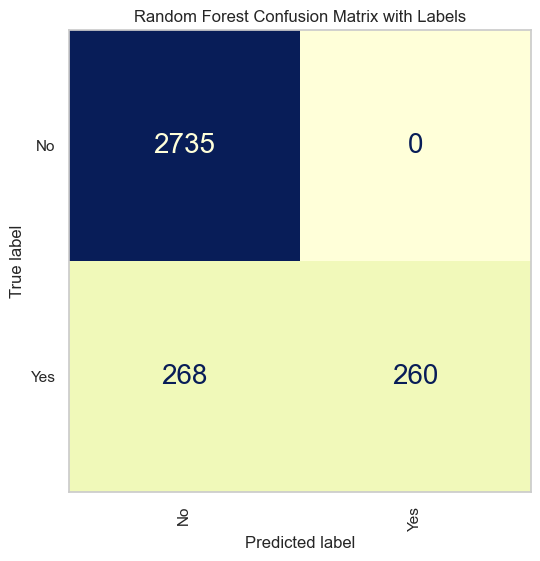

In [109]:
confusionmatrixRF = []
accuracyRF = []
recallRF = []
precisionRF = []
f1RF = []

# Split The Dataset Into Training And Testing
for train_index, test_index in kf.split(X,y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    RFParam = {
                    'n_estimators':[100, 200, 300],
                    'criterion': ['entropy', 'gini'],
                    'max_depth':[ 5, 6, 7],

              }
 
    RFGrid = GridSearchCV(estimator=RandomForestClassifier(random_state=0), 
                                param_grid=RFParam,
                                scoring='accuracy',
                                cv=5,
                                refit = True,
                                verbose = -1,
                                return_train_score = True,
                                )


    # Fit The Random Forest
    RFGrid.fit(X_train, y_train)
    y_pred = RFGrid.predict(X_test)

    # Confusion Matrix Of Random Forest
    confusionmatrixRF.append(confusion_matrix(y_test, y_pred))
    Confusion_MatrixRF = np.array(confusionmatrixRF)

    # Accuracy Of Random Forest
    accuracyRF.append(accuracy_score(y_test, y_pred))
    AccurcayRF= DataFrame(accuracyRF, columns=['Accuracy'])

    # Recall Of Random Forest
    recallRF.append(recall_score(y_test, y_pred, average='macro'))
    RecallRF = DataFrame(recallRF, columns=['Recall'])

    # Precision Of Random Forest
    precisionRF.append(precision_score(y_test, y_pred, average='macro'))
    PecisionRF = DataFrame(precisionRF, columns=['Precision'])

    # F1 Score Of Random Forest
    f1RF.append(f1_score(y_test, y_pred, average='macro'))
    F1RF = DataFrame(f1RF, columns=['F1 Score'])


print("")
print("The Best Random Forest Parameters Are:", RFGrid.best_params_)
print("")
print("Acuraccy Score Of Random Forest Is :", np.mean(accuracyRF) * 100)
print("")
print("Recall Score Of Random Forest Is :", np.mean(recallRF) * 100)
print("")
print("Precision Score Of Random Forest Is :", np.mean(precisionRF) * 100)
print("")
print("F1 Score Of Random Forest Is :", np.mean(f1RF) * 100)
print("")
print("""
Confusion Matrix Of Random Forest Is:
""", sum(confusionmatrixRF))
print(" ")

# Confusion Matrix Plot
disp = ConfusionMatrixDisplay(confusion_matrix=sum(confusionmatrixRF), display_labels=RFGrid.classes_)
fig, ax = plt.subplots(figsize=(6,6))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Random Forest Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()



**3- Logistic Regression**


The Best Logistic Regression Parameters Are: {'C': 10, 'penalty': 'l2', 'solver': 'newton-cg'}

Acuraccy Score Of Logistic Regression Is : 91.66413388116548

Recall Score Of Logistic Regression Is  : 74.62560656989798

Precision Score Of Logistic Regression Is : 94.67893112464287

F1 Score Of Logistic Regression Is : 80.39807764510446


Confusion Matrix Of Logistic Regression Is:
 [[2730    5]
 [ 267  261]]
 


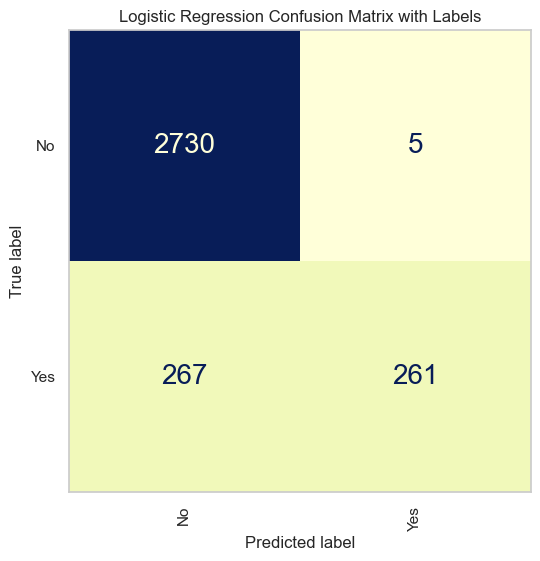

In [110]:
confusionmatrixLR = []
accuracyLR = []
recallLR = []
precisionLR = []
f1LR = []

# Split The Dataset Into Training And Testing
for train_index, test_index in kf.split(X,y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    LRParam = [

                    {'C': [1, 10, 100, 1000], 'penalty': ['l2', None], 'solver':['newton-cg', 'sag','lbfgs']}, 
                    {'C': [1, 10, 100, 1000], 'penalty': ['l2', 'l1'],  'solver':['liblinear'],}, 
                    {'C': [1, 10, 100, 1000], 'penalty': ['l2', 'l1', 'elasticnet', None],  'solver':['saga'],},                
              ]
 
    LRGrid = GridSearchCV(estimator=LogisticRegression(random_state=0), 
                                param_grid=LRParam,
                                scoring='accuracy',
                                cv=5,
                                refit = True,
                                verbose = -1,
                                return_train_score = True,
                                )

    # Fit The Logistic Regression
    LRGrid.fit(X_train, y_train)
    y_pred = LRGrid.predict(X_test)

    # Confusion Matrix Of Logistic Regression
    confusionmatrixLR.append(confusion_matrix(y_test, y_pred))
    Confusion_MatrixLR = np.array(confusionmatrixLR)

    # Accuracy Of Logistic Regression
    accuracyLR.append(accuracy_score(y_test, y_pred))
    AccurcayLR = DataFrame(accuracyLR, columns=['Accuracy'])

    # Recall Of Logistic Regression
    recallLR.append(recall_score(y_test, y_pred, average='macro'))
    RecallLR = DataFrame(recallLR, columns=['Recall'])

    # Precision Of Logistic Regression
    precisionLR.append(precision_score(y_test, y_pred, average='macro'))
    PecisionLR = DataFrame(precisionLR, columns=['Precision'])

    # F1 Score Of Logistic Regression
    f1LR.append(f1_score(y_test, y_pred, average='macro'))
    F1LR = DataFrame(f1LR, columns=['F1 Score'])

print("")
print("The Best Logistic Regression Parameters Are:", LRGrid.best_params_)
print("")
print("Acuraccy Score Of Logistic Regression Is :", np.mean(accuracyLR) * 100)
print("")
print("Recall Score Of Logistic Regression Is  :", np.mean(recallLR) * 100)
print("")
print("Precision Score Of Logistic Regression Is :", np.mean(precisionLR) * 100)
print("")
print("F1 Score Of Logistic Regression Is :", np.mean(f1LR) * 100)
print("")
print("""
Confusion Matrix Of Logistic Regression Is:
""", sum(confusionmatrixLR))
print(" ")

# Confusion Matrix Plot
disp = ConfusionMatrixDisplay(confusion_matrix=sum(confusionmatrixLR), display_labels=LRGrid.classes_)
fig, ax = plt.subplots(figsize=(6,6))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Logistic Regression Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()



**4 - Naive Bayes**

Acuraccy Score Of Naive Bayes Is : 90.25355997073225

Recall Score Of Naive Bayes Is : 76.14920749268636

Precision Score If Naive Bayes Is : 85.00652336726453

F1 Score Of Naive Bayes Is : 79.52260640418613

Confusion Matrix Of Naive Bayes Is:
 [[2653   82]
 [ 236  292]]
 


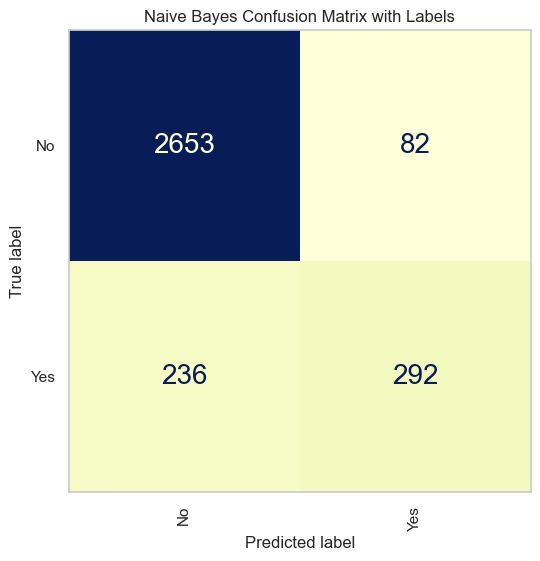

In [111]:
confusionmatrixNB = []
accuracyNB = []
recallNB = []
precisionNB = []
f1NB = []

# Split The Dataset Into Training And Testing
for train_index, test_index in kf.split(X,y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # 1-Naive Bayes
    # Create NNaive Bayes Model
    NB = GaussianNB()

    # Fit The Naive Bayes
    NB.fit(X_train, y_train)
    y_pred = NB.predict(X_test)

    # Confusion Matrix Of Naive Bayes
    confusionmatrixNB.append(confusion_matrix(y_test, y_pred))
    Confusion_MatrixNB = np.array(confusionmatrixNB)

    # Accuracy Of Naive Bayes
    accuracyNB.append(accuracy_score(y_test, y_pred))
    AccurcayNB = DataFrame(accuracyNB, columns=['Accuracy'])

    # Recall Of Naive Bayes
    recallNB.append(recall_score(y_test, y_pred, average='macro'))
    RecallNB = DataFrame(recallNB, columns=['Recall'])

    # Precision Of Naive Bayes
    precisionNB.append(precision_score(y_test, y_pred, average='macro'))
    PecisionNB = DataFrame(precisionNB, columns=['Precision'])

    # F1 Score Of Naive Bayes
    f1NB.append(f1_score(y_test, y_pred, average='macro'))
    F1NB = DataFrame(f1NB, columns=['F1 Score'])


print("Acuraccy Score Of Naive Bayes Is :", np.mean(accuracyNB) * 100)
print("")
print("Recall Score Of Naive Bayes Is :", np.mean(recallNB) * 100)
print("")
print("Precision Score If Naive Bayes Is :", np.mean(precisionNB) * 100)
print("")
print("F1 Score Of Naive Bayes Is :", np.mean(f1NB) * 100)
print("""
Confusion Matrix Of Naive Bayes Is:
""", sum(confusionmatrixNB))
print(" ")

# Confusion Matrix Plot
disp = ConfusionMatrixDisplay(confusion_matrix=sum(confusionmatrixNB), display_labels=NB.classes_)
fig, ax = plt.subplots(figsize=(6,6))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Naive Bayes Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()



**5 - Neural Network**


The Best Neural Network Parameters Are: {'activation': 'logistic', 'alpha': 0.001, 'hidden_layer_sizes': 13, 'learning_rate_init': 0.001, 'solver': 'adam'}

Acuraccy Score Of Neural Network Is : 91.75606461417235

Recall Score Of Neural Network Is : 74.83260083349602

Precision Score Of Neural Network Is : 94.86693249564783

F1 Score Of Neural Network Is : 80.62600071634091


Confusion Matrix Of Neural Network Is:
 [[2731    4]
 [ 265  263]]
 


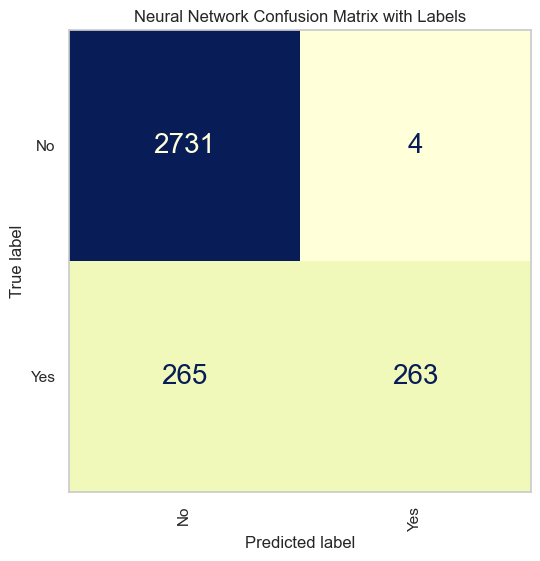

In [112]:
confusionmatrixNN = []
accuracyNN = []
recallNN = []
precisionNN = []
f1NN = []

# Split The Dataset Into Training And Testing
for train_index, test_index in kf.split(X,y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
  
    NNParam = [{
                    'hidden_layer_sizes':[(13),],
                    'activation': ['logistic', 'tanh', 'relu'],
                    'solver': ['sgd', 'adam'],
                    'alpha': [0.1, 0.01, 0.001, 0.0001],
                    'learning_rate_init': [0.1, 0.01, 0.001, 0.0001]
                    
                    
              }]
 
    NNGrid = GridSearchCV(estimator=MLPClassifier(random_state=0), 
                                param_grid=NNParam,
                                scoring='accuracy',
                                cv=5,
                                refit = True,
                                verbose = 0,
                                return_train_score = True,
                               )
 

    # Fit The Neural Network
    NNGrid.fit(X_train, y_train)
    y_pred = NNGrid.predict(X_test)

    # Confusion Matrix Of Neural Network
    confusionmatrixNN.append(confusion_matrix(y_test, y_pred))
    Confusion_MatrixNN = np.array(confusionmatrixNN)

    # Accuracy Of Neural Network
    accuracyNN.append(accuracy_score(y_test, y_pred))
    AccurcayNN = DataFrame(accuracyNN, columns=['Accuracy'])

    # Recall Of Neural Network
    recallNN.append(recall_score(y_test, y_pred, average='macro'))
    RecallNN = DataFrame(recallNN, columns=['Recall'])

    # Precision Of Neural Network
    precisionNN.append(precision_score(y_test, y_pred, average='macro'))
    PecisionNN = DataFrame(precisionNN, columns=['Precision'])

    # F1 Score Of Neural Network 
    f1NN.append(f1_score(y_test, y_pred, average='macro'))
    F1NN = DataFrame(f1NN, columns=['F1 Score'])

print("")
print("The Best Neural Network Parameters Are:", NNGrid.best_params_)
print("")
print("Acuraccy Score Of Neural Network Is :", np.mean(accuracyNN) * 100)
print("")
print("Recall Score Of Neural Network Is :", np.mean(recallNN) * 100)
print("")
print("Precision Score Of Neural Network Is :", np.mean(precisionNN) * 100)
print("")
print("F1 Score Of Neural Network Is :", np.mean(f1NN) * 100)
print("")
print("""
Confusion Matrix Of Neural Network Is:
""", sum(confusionmatrixNN))
print(" ")

# Confusion Matrix Plot
disp = ConfusionMatrixDisplay(confusion_matrix=sum(confusionmatrixNN), display_labels=NNGrid.classes_)
fig, ax = plt.subplots(figsize=(6,6))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Neural Network Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()



**6 - Support Vector Machine**


The Best Support Vector Machine Parameters Are: {'C': 1, 'kernel': 'linear'}

Acuraccy Score Of Support Vector Machine Is : 91.69480872779123

Recall Score Of Support Vector Machine Is : 74.71994619253948

Precision Score Of Support Vector Machine Is : 94.55335188922484

F1 Score Is Of Support Vector Machine : 80.48630004126966


Confusion Matrix Of Support Vector Machine Is:
 [[2730    5]
 [ 266  262]]
 


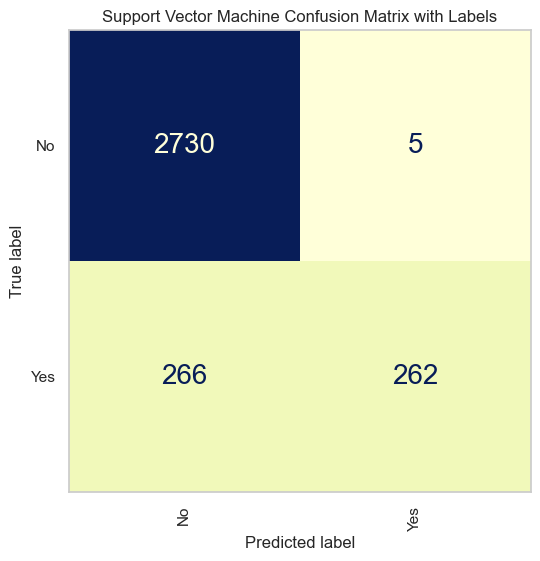

In [113]:
confusionmatrixSVM = []
accuracySVM = []
recallSVM = []
precisionSVM = []
f1SVM = []

# Split The Dataset Into Training And Testing
for train_index, test_index in kf.split(X,y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]


    SVMParam = [
                    {'C': [1, 10], 'kernel': ['linear'], },
                    {'C': [1, 10], 'gamma': [1, 0.1, 0.01, 0.001], 'kernel': ['poly'], 'degree':[1, 2, 3],},
                    {'C': [1, 10], 'gamma': [1, 0.1, 0.01, 0.001], 'kernel': ['rbf'],},
                    {'C': [1, 10], 'gamma': [1, 0.1, 0.01, 0.001,], 'kernel': ['sigmoid'], },
               ]

    SVMGrid = GridSearchCV(estimator=SVC(random_state=0), 
                                 param_grid=SVMParam,
                                 scoring='accuracy',
                                 cv=5,
                                 refit = True,
                                 verbose = -1,
                                 return_train_score = True,
                                 )

    # Fit The Support Vector Machine
    SVMGrid.fit(X_train, y_train)
    y_pred = SVMGrid.predict(X_test)

    # Confusion Matrix OfSupport Vector Machine
    confusionmatrixSVM.append(confusion_matrix(y_test, y_pred))
    Confusion_MatrixSVM = np.array(confusionmatrixSVM)

    # Accuracy Of Support Vector Machine
    accuracySVM.append(accuracy_score(y_test, y_pred))
    AccurcaySVM = DataFrame(accuracySVM, columns=['Accuracy'])

    # Recall Of Support Vector Machine
    recallSVM.append(recall_score(y_test, y_pred, average='macro'))
    RecallSVM = DataFrame(recallSVM, columns=['Recall'])

    # Precision Of Support Vector Machine
    precisionSVM.append(precision_score(y_test, y_pred, average='macro'))
    PecisionSVM = DataFrame(precisionSVM, columns=['Precision'])

    # F1 Score Of Support Vector Machine
    f1SVM.append(f1_score(y_test, y_pred, average='macro'))
    F1SVM = DataFrame(f1SVM, columns=['F1 Score'])



print("")
print("The Best Support Vector Machine Parameters Are:", SVMGrid.best_params_)
print("")
print("Acuraccy Score Of Support Vector Machine Is :", np.mean(accuracySVM) * 100)
print("")
print("Recall Score Of Support Vector Machine Is :", np.mean(recallSVM) * 100)
print("")
print("Precision Score Of Support Vector Machine Is :", np.mean(precisionSVM) * 100)
print("")
print("F1 Score Is Of Support Vector Machine :", np.mean(f1SVM) * 100)
print("")
print("""
Confusion Matrix Of Support Vector Machine Is:
""", sum(confusionmatrixSVM))
print(" ")

# Confusion Matrix Plot
disp = ConfusionMatrixDisplay(confusion_matrix=sum(confusionmatrixSVM), display_labels=SVMGrid.classes_)
fig, ax = plt.subplots(figsize=(6,6))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('Support Vector Machine Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show()



**7 - K Nearest Neighbors**


The Best KNN Parameters Are: {'metric': 'euclidean', 'n_neighbors': 7}

Acuraccy Score Of K Nearest Neighbor Is : 91.29650475600833

Recall Score Of K Nearest Neighbor Is : 74.7156348104909

Precision Score Of K Nearest Neighbor Is : 91.90228622171614

F1 Score Of K Nearest Neighbor Is : 80.01144368296632


Confusion Matrix Of K Nearest Neighbor Is:
 [[2714   21]
 [ 263  265]]
 


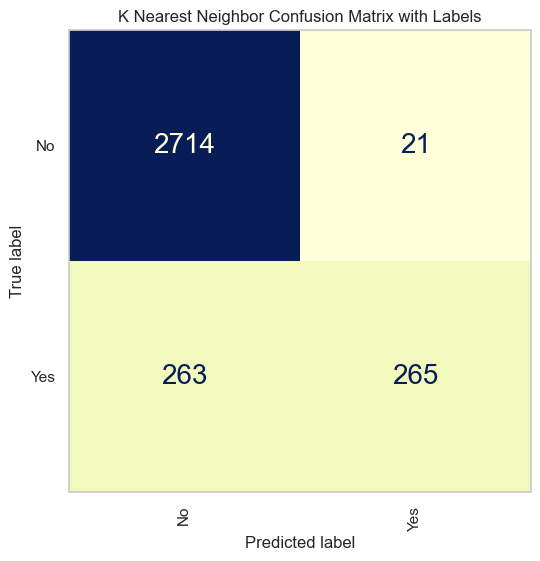

In [114]:
confusionmatrixKNN = []
accuracyKNN = []
recallKNN = []
precisionKNN = []
f1KNN = []

# Split The Dataset Into Training And Testing
for train_index, test_index in kf.split(X,y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]


    KNNParam = {'n_neighbors':[1, 3, 5, 7, 9], 
                'metric': ['euclidean', 'manhattan', 'chebyshev', 'minkowski'],
            }

    KNNGrid = GridSearchCV(estimator=KNeighborsClassifier(), 
                                 param_grid=KNNParam,
                                 scoring='accuracy',
                                 cv=5,
                                 refit = True,
                                 verbose = -1,
                                 return_train_score = True,
                                 )


    # Fit The K Nearest Neighbors
    KNNGrid.fit(X_train, y_train)
    y_pred = KNNGrid.predict(X_test)

    # Confusion Matrix Of K Nearest Neighbors
    confusionmatrixKNN.append(confusion_matrix(y_test, y_pred))
    Confusion_MatrixKNN = np.array(confusionmatrixKNN)

    # Accuracy Of K Nearest Neighbors
    accuracyKNN.append(accuracy_score(y_test, y_pred))
    AccurcayKNN = DataFrame(accuracyKNN, columns=['Accuracy'])

    # Recall Of K Nearest Neighbors
    recallKNN.append(recall_score(y_test, y_pred, average='macro'))
    RecallKNN = DataFrame(recallKNN, columns=['Recall'])

    # Precision Of K Nearest Neighbors
    precisionKNN.append(precision_score(y_test, y_pred, average='macro'))
    PecisionKNN = DataFrame(precisionKNN, columns=['Precision'])

    # F1 Score Of K Nearest Neighbors
    f1KNN.append(f1_score(y_test, y_pred, average='macro'))
    F1KNN = DataFrame(f1KNN, columns=['F1 Score'])

print("")
print("The Best KNN Parameters Are:", KNNGrid.best_params_)
print("")
print("Acuraccy Score Of K Nearest Neighbor Is :", np.mean(accuracyKNN) * 100)
print("")
print("Recall Score Of K Nearest Neighbor Is :", np.mean(recallKNN) * 100)
print("")
print("Precision Score Of K Nearest Neighbor Is :", np.mean(precisionKNN) * 100)
print("")
print("F1 Score Of K Nearest Neighbor Is :", np.mean(f1KNN) * 100)
print("")
print("""
Confusion Matrix Of K Nearest Neighbor Is:
""", sum(confusionmatrixKNN))
print(" ")

# Confusion Matrix Plot
disp = ConfusionMatrixDisplay(confusion_matrix=sum(confusionmatrixKNN), display_labels=KNNGrid.classes_)
fig, ax = plt.subplots(figsize=(6,6))
disp.plot(cmap='YlGnBu', colorbar=False, xticks_rotation='vertical', values_format='d', ax=ax)
plt.title('K Nearest Neighbor Confusion Matrix with Labels')
plt.rcParams['font.size'] = '20'
plt.grid(None)
plt.show();



In [115]:
Algorithm = ({ 
              'Algorithm': ['Decision Tree', 'Random Forest', 'Logistic Regression', 'Naive Bayes', 'Neural Network', 'Support Vector Machine', 'K Nearest Neighbors'],
              'Accuracy': [np.mean(accuracyDT) * 100, np.mean(accuracyRF) * 100, np.mean(accuracyLR) * 100, np.mean(accuracyNB) * 100, np.mean(accuracyNN) * 100, np.mean(accuracySVM) * 100, np.mean(accuracyKNN) * 100]
             })

In [116]:
Accuracy = pd.DataFrame(Algorithm)
Accuracy

,Algorithm,Accuracy
0,Decision Tree,91.357573
1,Random Forest,91.786646
2,Logistic Regression,91.664134
3,Naive Bayes,90.253560
4,Neural Network,91.756065
5,Support Vector Machine,91.694809
6,K Nearest Neighbors,91.296505


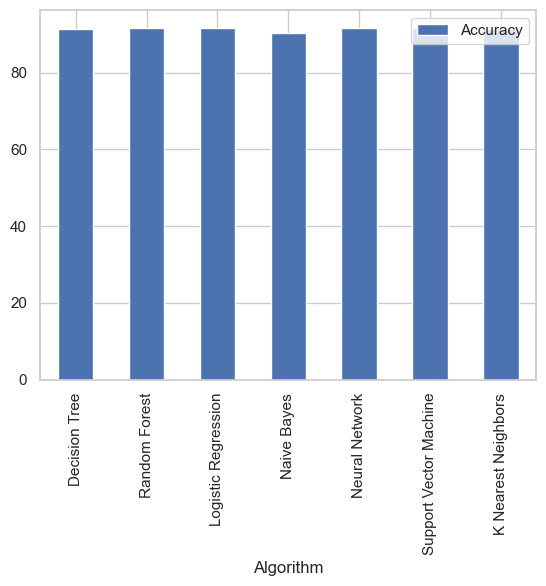

In [117]:
Accuracy.plot(kind = 'bar', x = 'Algorithm', y = 'Accuracy');